In [ ]:
import sys
!{sys.executable} -m pip install --no-cache-dir boto3

In [806]:
import os
import re
import csv
import json
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from collections import defaultdict
from iso639 import languages
import requests
import shutil
import scipy

import seaborn as sns
from tldextract import extract
import matplotlib.cm as cm

import plotly.express as px
import plotly.graph_objects as go
import plotly.offline as pyo
from plotly.subplots import make_subplots

from PIL import Image
import urllib.request as urlopen
from textwrap import wrap
import cv2
import boto3

from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from langdetect import detect

import seaborn as sns
from tldextract import extract
import matplotlib.cm as cm

from transformers import pipeline
import textstat

In [ ]:
data_dir = '/data/datacomp/'
scale_dir = os.path.join(data_dir, 'small')
metadata_dir = os.path.join(scale_dir, 'metadata')
image_dir = os.path.join(scale_dir, 'sample_images_1M')
output_dir = os.path.join(scale_dir, 'sample_images_1M_rekognition')

In [ ]:
df = None
for filename in os.listdir(metadata_dir):
    filepath = os.path.join(metadata_dir, filename)
    file_df = pd.read_parquet(filepath, engine='pyarrow')
    if df is None:
        df = file_df
    else:
        df = pd.concat([df, file_df], ignore_index=True)

In [ ]:
df

In [ ]:
l14_scores = df['clip_l14_similarity_score'].tolist()
min_threshold = np.percentile(l14_scores, 70)
filtered_df = df[df['clip_l14_similarity_score'] > min_threshold]
excluded_df = df[df['clip_l14_similarity_score'] <= min_threshold]

assert(len(filtered_df) + len(excluded_df) == len(df))
print(len(df), len(filtered_df)) # 12.8M --> 3.94M filtered
print(len(filtered_df) / len(df)) # 30%

In [ ]:
raw_captions = df['text'].tolist()
filtered_captions = filtered_df['text'].tolist()
excluded_captions = excluded_df['text'].tolist()

In [ ]:
filtered_uids = set(filtered_df['uid'].unique())

# Call rekognition

In [ ]:
# client=boto3.client('rekognition')

session = boto3.Session(profile_name='main-profile')
client = session.client('rekognition')

In [ ]:
def detect_faces(img_path):
    with open(img_path, 'rb') as image:
        response = client.detect_faces(
            Image={'Bytes': image.read()},
            Attributes=["GENDER", "AGE_RANGE"],
        )
    return response

In [ ]:
img_path = '/home/hongrach/datafiltering/notebooks/sample.jpeg'
response = detect_faces(img_path)
response

In [ ]:
response.keys()

In [ ]:
for f in response['FaceDetails']:
    print(f['BoundingBox'])
    print(f['AgeRange'])
    print(f['Gender'])

In [ ]:
np.random.seed(0)

filenames = sorted(os.listdir(image_dir))
NUM_SAMPLE = 4000
sample_filenames = np.random.choice(filenames, NUM_SAMPLE, replace=False)
for filename in sample_filenames[:100]:
    print(filename.split('.')[0])

In [ ]:
np.random.seed(0)

filenames = sorted(os.listdir(image_dir))
NUM_SAMPLE = 100000
sample_100k_filenames = np.random.choice(filenames, NUM_SAMPLE, replace=False)
for filename in sample_100k_filenames[:100]:
    print(filename.split('.')[0])

In [ ]:
for filename in sample_filenames:
    uid = filename.split('.')[0]
    output_file = os.path.join(output_dir, uid + '.json')
    if not os.path.isfile(output_file):
        img_path = os.path.join(image_dir, filename)
        print('processing...', img_path)
        try:
#             response = detect_faces(img_path)
            with open(output_file, 'w') as fp:
                json.dump(response, fp)
        except Exception as e:
            print('error', e)
    else:
        print('already processed')


# Analyze results

In [ ]:
results = defaultdict(list)

for filename in os.listdir(output_dir):
    uid = filename.split('.')[0]
    output_file = os.path.join(output_dir, filename)
    with open(output_file) as f:
        response = json.load(f)
        for face in response['FaceDetails']:
            results[uid].append(face)

In [ ]:
len(results), len(os.listdir(output_dir))

In [ ]:
len(results) / len(os.listdir(output_dir)) # 20% of images had at least 1 face

In [ ]:
for uid in results:
    for f in results[uid]:
        print(f['Gender'])

In [ ]:
results_uids = [uid for uid in results]
results_df = df.loc[df['uid'].isin(results_uids)]
results_df

In [ ]:
results_df[results_df['text'].str.contains(r'trump', na=False, case=False)]

In [ ]:
# DON'T USE THIS BECAUSE OPENCV IS INACCURATE

GENDER_CONFIDENCE = 0.99
AGE_CONFIDENCE = 0.99

model_dir = '/home/hongrach/datafiltering/notebooks/age_gender_models'

age1 = os.path.join(model_dir, "deploy_age.prototxt")
age2 = os.path.join(model_dir, "age_net.caffemodel")
gen1 = os.path.join(model_dir, "deploy_gender.prototxt")
gen2 = os.path.join(model_dir, "gender_net.caffemodel")

MODEL_MEAN_VALUES = (78.4263377603, 87.7689143744, 114.895847746) # is this right?
 
age_model = cv2.dnn.readNet(age2, age1) 
gender_model = cv2.dnn.readNet(gen2, gen1) 

AGE_LABELS = ['(0-2)', '(4-6)', '(8-12)', '(15-20)', 
      '(25-32)', '(38-43)', '(48-53)', '(60-100)'] 
GENDER_LABELS = ['Male', 'Female'] 

def predict_face(face_img):
    if face_img.shape[0] < 40 and face_img.shape[1] < 40:
        return (None, None)

    blob = cv2.dnn.blobFromImage( 
        face_img, 1.0, (256, 256), MODEL_MEAN_VALUES, swapRB=False
    )

    #Prediction of gender 
    gender_model.setInput(blob) 
    gender_preds = gender_model.forward() 
    gender_index = gender_preds[0].argmax()
    
    if gender_preds[0][gender_index] > GENDER_CONFIDENCE:
        gender = GENDER_LABELS[gender_index]
    else:
        gender = None

    #Prediction of age 
    age_model.setInput(blob) 
    age_preds = age_model.forward()
    age_index = age_preds[0].argmax()
    
    if age_preds[0][age_index] > AGE_CONFIDENCE:
        age = AGE_LABELS[age_index]
    else:
        age = None

    return (gender, age)

In [537]:
l

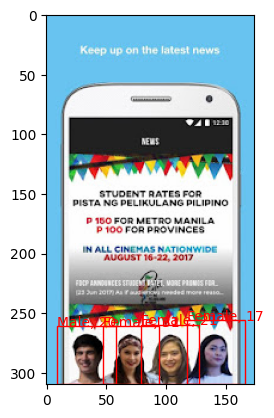

[('Female', 21), ('Male', 20), ('Female', 17), ('Female', 31)]

In [538]:
process_age_gender_of_row(results_df.iloc[12], use_opencv=False, show=True)

In [ ]:
results_df.loc[524118]

In [ ]:
GENDER_LABELS = ['Male', 'Female']
AGE_LABELS = range(0, 100, 10)

In [539]:
gender_count = {'Male': {'filtered': [], 'total': []}, 'Female': {'filtered': [], 'total': []}}
# {'Male': {'filtered': X, 'total': X}, 'Female': {'filtered': X, 'total': X}}

age_count = {} # {'decade': {'filtered': X, 'total': X}}
for a in AGE_LABELS:
    age_count[a] = {'filtered': [], 'total': []}
    
age_gender_count = {} # {'(X, X)': {'filtered': X, 'total': X}}
for g in GENDER_LABELS:
    for a in AGE_LABELS:
        k = g + ' ' + str(a)
        age_gender_count[k] = {'filtered': [], 'total': []}

seen_uids = []
uid_to_annotations = {}
for i, row in results_df.iterrows():
    uid = row['uid']
    is_filtered = uid in filtered_uids
    face_annotations = process_age_gender_of_row(row, use_opencv=False)
    uid_to_annotations[uid] = face_annotations

    for (g, a_num) in face_annotations:
        a = int(a_num / 10) * 10 if type(a_num) is int else a_num
        if g != None:
            gender_count[g]['total'].append(uid)
            if is_filtered:
                gender_count[g]['filtered'].append(uid)
        if a != None:
            age_count[a]['total'].append(uid)
            if is_filtered:
                age_count[a]['filtered'].append(uid)
        if g != None and a != None:
            k = g + ' ' + str(a)
            age_gender_count[k]['total'].append(uid)
            if is_filtered:
                age_gender_count[k]['filtered'].append(uid)
    
    seen_uids.append(uid)

In [540]:
len(uid_to_annotations)

18806

In [ ]:
# dump dicts
annotations = {
    'age': age_count,
    'gender': gender_count,
    'age_gender': age_gender_count,
    'uid_to_annotations': uid_to_annotations,
}
with open('rekognition_groups.json', 'w') as fp:
    json.dump(annotations, fp)

In [ ]:
def get_error(filter_num, raw_num):
    pos_list = [1] * filter_num
    neg_list = [0] * (raw_num - filter_num)
    err = np.std(pos_list + neg_list)
    return err / np.sqrt(raw_num)

In [744]:
# redo age_count, gender_count, age_gender_count by images with a single person
NUM_FACES = 1

gender_count = {'Male': {'filtered': [], 'total': []}, 'Female': {'filtered': [], 'total': []}}
# {'Male': {'filtered': X, 'total': X}, 'Female': {'filtered': X, 'total': X}}

age_count = {} # {'decade': {'filtered': X, 'total': X}}
for a in AGE_LABELS:
    age_count[a] = {'filtered': [], 'total': []}
    
age_gender_count = {} # {'(X, X)': {'filtered': X, 'total': X}}
for g in GENDER_LABELS:
    for a in AGE_LABELS:
        k = g + ' ' + str(a)
        age_gender_count[k] = {'filtered': [], 'total': []}


n_imgs = 0
for uid in uid_to_annotations:
    is_filtered = uid in filtered_uids
    
    face_annotations = uid_to_annotations[uid]
    if len(face_annotations) == NUM_FACES:
#         ratio = face_to_img_ratio_dict[uid]
#         if ratio < 0.1 or ratio > 0.2:
#             continue
#         row = df[(df['uid'] == uid)].iloc[0]
#         caption = row['text']
#         try:
#             lang = detect(caption)
#         except Exception as e:
#             print(e, caption)
#             lang = None
        
#         if lang != 'en':
#             continue

        n_imgs += 1
        
        for (g, a_num) in face_annotations:
            a = int(a_num / 10) * 10 if type(a_num) is int else a_num
            if g != None:
                gender_count[g]['total'].append(uid)
                if is_filtered:
                    gender_count[g]['filtered'].append(uid)
            if a != None:
                age_count[a]['total'].append(uid)
                if is_filtered:
                    age_count[a]['filtered'].append(uid)
            if g != None and a != None:
                k = g + ' ' + str(a)
                age_gender_count[k]['total'].append(uid)
                if is_filtered:
                    age_gender_count[k]['filtered'].append(uid)
n_imgs

11033

In [745]:
combined_count = {
    'gender': gender_count,
    'age': age_count,
    'age_gender': age_gender_count
}

Male 0.00556509467095049
Female 0.00649419049852767


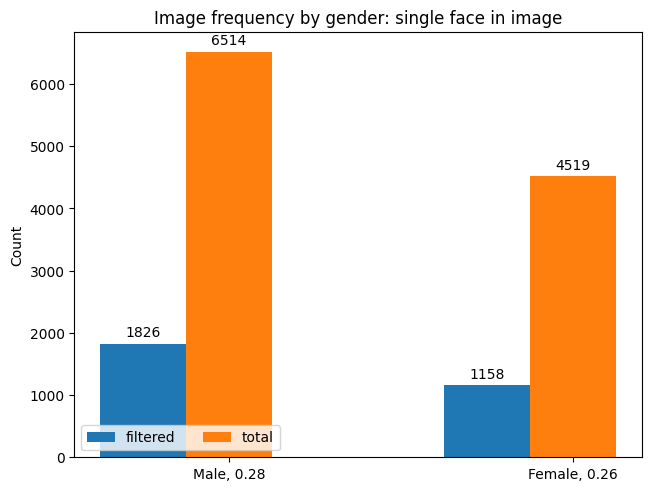

In [797]:
# bar graph: GENDER

graph_results = defaultdict(list)

ratio_by_g = {}
for g in GENDER_LABELS:
    filter_num = len(gender_count[g]['filtered'])
    total_num = len(gender_count[g]['total'])
    print(g, get_error(filter_num, total_num))
    ratio_by_g[g] = 1.0 * filter_num / total_num
    for k in gender_count[g]:
        graph_results[k].append(len(gender_count[g][k]))

x = np.arange(len(GENDER_LABELS))  # the label locations
width = 0.25  # the width of the bars
multiplier = 0

fig, ax = plt.subplots(layout='constrained')

for k, v in graph_results.items():
    offset = width * multiplier
    rects = ax.bar(x + offset, v, width=width, label=k)
    ax.bar_label(rects, padding=3)
    multiplier += 1

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Count')
ax.set_title('Image frequency by gender: single face in image')
ax.set_xticks(x + width, [g + ', %.2f' % ratio_by_g[g] for g in GENDER_LABELS])
ax.legend(loc='lower left', ncols=3)

plt.show()

[178, 432, 908, 557, 379, 356, 126]
[649, 1681, 3268, 2033, 1479, 1315, 471]


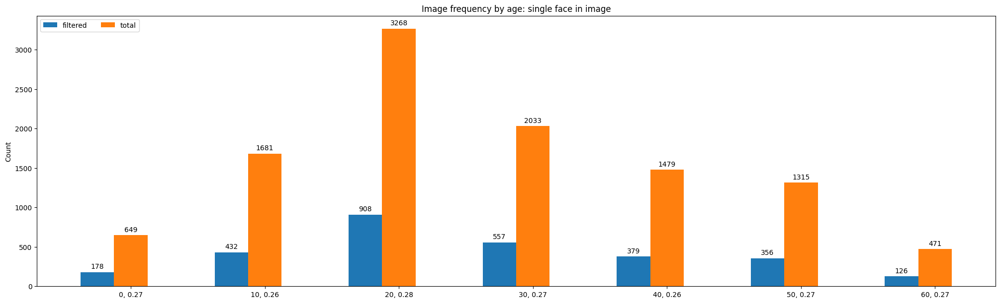

In [802]:
# bar graph: AGE

graph_results = defaultdict(list)

ratio_by_g = {}
for g in AGE_LABELS[:-3]:
    total_num = len(age_count[g]['total'])
    if total_num > 0:
        ratio_by_g[g] = len(age_count[g]['filtered']) / total_num
    else:
        ratio_by_g[g] = 0
    for k in age_count[g]:
        graph_results[k].append(len(age_count[g][k]))

x = np.arange(len(AGE_LABELS[:-3]))  # the label locations
width = 0.25  # the width of the bars
multiplier = 0

fig, ax = plt.subplots(layout='constrained', figsize=(20, 6))

for k, v in graph_results.items():
    print(v)
    offset = width * multiplier
    rects = ax.bar(x + offset, v, width=width, label=k)
    ax.bar_label(rects, padding=3)
    multiplier += 1

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Count')
ax.set_title('Image frequency by age: single face in image')
ax.set_xticks(x + width, ['%s, %.2f' % (g, ratio_by_g[g]) for g in AGE_LABELS[:-3]])
ax.legend(loc='upper left', ncols=3)

plt.show()

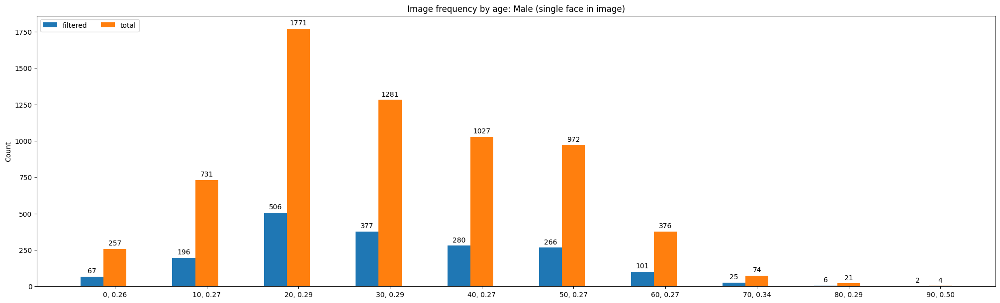

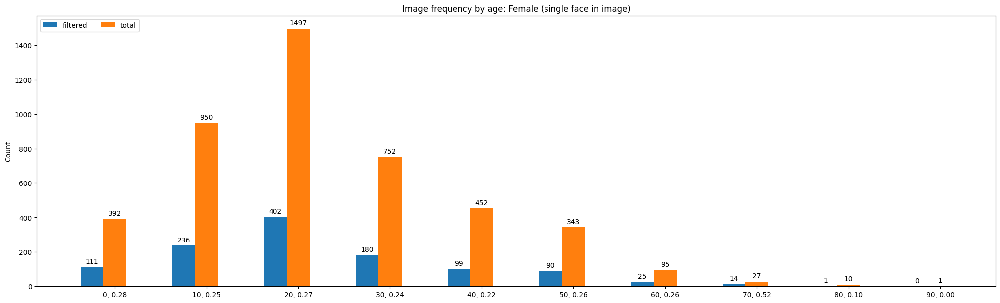

In [803]:
# bar graph: AGE and GENDER

def show_graph_by_gender(gender):
    graph_results = defaultdict(list)

    ratio_by_g = {}
    for g in AGE_LABELS:
        key = gender + ' ' + str(g)
        total_num = len(age_gender_count[key]['total'])
        if total_num > 0:
            ratio_by_g[g] = len(age_gender_count[key]['filtered']) / total_num
        else:
            ratio_by_g[g] = 0
        for k in age_gender_count[key]:
            graph_results[k].append(len(age_gender_count[key][k]))

    x = np.arange(len(AGE_LABELS))  # the label locations
    width = 0.25  # the width of the bars
    multiplier = 0

    fig, ax = plt.subplots(layout='constrained', figsize=(20, 6))
    for k, v in graph_results.items():
        offset = width * multiplier
        rects = ax.bar(x + offset, v, width=width, label=k)
        ax.bar_label(rects, padding=3)
        multiplier += 1

    # Add some text for labels, title and custom x-axis tick labels, etc.
    ax.set_ylabel('Count')
    ax.set_title('Image frequency by age: ' + gender + ' (single face in image)')
    ax.set_xticks(x + width, ['%s, %.2f' % (g, ratio_by_g[g]) for g in AGE_LABELS])
    ax.legend(loc='upper left', ncols=3)

    plt.show()

show_graph_by_gender(GENDER_LABELS[0])
show_graph_by_gender(GENDER_LABELS[1])

0.1607847356736235
1.5549352364919e-05 0.2527423320055641 0.40097971977847396 0.15534301479533943 1.0255007008183544e-05


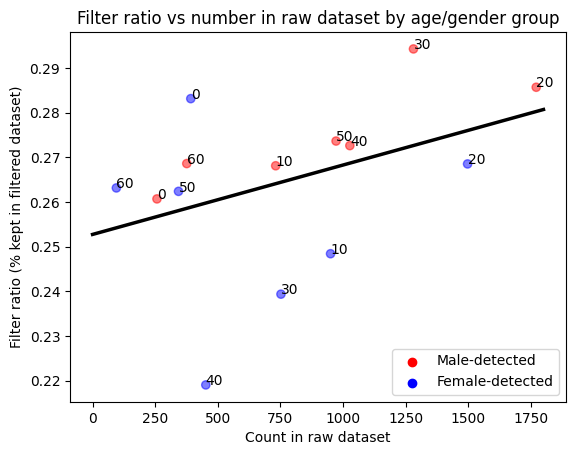

In [902]:
x = []
y = []
colors = []
age = []

for g in GENDER_LABELS:
    for a in AGE_LABELS:
        key = g + ' ' + str(a)
        total_num = len(age_gender_count[key]['total'])
        if total_num > 90:
            ratio = len(age_gender_count[key]['filtered']) / total_num
            x.append(total_num)
            y.append(ratio)
            age.append(str(a))
            if g == 'Female':
                colors.append('blue')
            else:
                colors.append('red')

b, a = np.polyfit(x, y, deg=1)
print(np.corrcoef(x, y)[0,1] ** 2)
slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(x, y)
print(slope, intercept, r_value, p_value, std_err)
# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(0, 1800, num=100)
# Plot regression line
plt.scatter(x, y, c=colors, alpha=0.5)
for i in range(len(x)):
    plt.text(x[i], y[i], age[i])

plt.plot(xseq, a + b * xseq, color="k", lw=2.5)
plt.xlabel('Count in raw dataset')
plt.ylabel('Filter ratio (% kept in filtered dataset)')
plt.title('Filter ratio vs number in raw dataset by age/gender group')
plt.scatter([], [], c='red', label='Male-detected')
plt.scatter([], [], c='blue', label='Female-detected')
plt.legend(loc='lower right')
plt.show()


In [ ]:
# distribution of # images by gender
filtered_num_imgs_dict = {'Female': defaultdict(list), 'Male': defaultdict(list)} # 1: [], etc
total_num_imgs_dict = {'Female': defaultdict(list), 'Male': defaultdict(list)} # 1: [], etc

for uid in uid_to_annotations:
    is_filtered = uid in filtered_uids
    
    face_annotations = uid_to_annotations[uid]
    n_faces = len(face_annotations)
    genders = [f[0] for f in face_annotations]
    has_male = 'Male' in genders
    has_female = 'Female' in genders
    
    if n_faces > 10:
        continue
        
    if has_female:
        total_num_imgs_dict['Female'][n_faces].append(uid)
        if is_filtered:
            filtered_num_imgs_dict['Female'][n_faces].append(uid)
            
    if has_male:
        total_num_imgs_dict['Male'][n_faces].append(uid)
        if is_filtered:
            filtered_num_imgs_dict['Male'][n_faces].append(uid)

In [ ]:
fig, axes = plt.subplots(nrows=2, sharex=True, sharey=True, figsize=(6, 8))
for i, g in enumerate(GENDER_LABELS):
    ax = axes[i]
    f_dict = filtered_num_imgs_dict[g]
    t_dict = total_num_imgs_dict[g]
    x = [k for k in f_dict]
    f_y = [len(f_dict[k]) for k in f_dict]
    t_y = [len(t_dict[k]) for k in f_dict]
    e_y = [t_y[i] - f_y[i] for i in range(len(f_y))]
    ratio_y = [f_y[i] / t_y[i] for i in range(len(f_y))]
    
    width = 0.5
    ax.bar(x, f_y, width, label='filtered', bottom=[0] * len(f_y))
    ax.bar(x, e_y, width, label='excluded', bottom=f_y)
    for i in range(len(f_y)):
        ax.text(x[i], t_y[i], f'%.2f' % ratio_y[i])
    print(f_y[0])
    ax.set_title('Count by number of faces: ' + g)
    ax.legend()
fig.show()


## Face to image ratio

In [570]:
def get_face_to_img_ratio(row, NUM_FACES=1):
    img = get_image(row)
    if img is None:
        return []

    assert row['uid'] in results
    face_details = results[row['uid']]

    if NUM_FACES and len(face_details) == NUM_FACES:
        face_detail = face_details[0]
        (w1, h1, w2, h2) = get_face_box(img, face_detail['BoundingBox'], use_opencv=False)
        
        ratio = (w2-w1) * (h2-h1) / (img.shape[0] * img.shape[1])
        if ratio > 1:
            print((w1, h1, w2, h2))
            print((w2-w1) * (h2-h1), img.shape[0] * img.shape[1])

            fig, ax = plt.subplots()
            ax.imshow(img[:,:,::-1])
            rect = patches.Rectangle(
                (w1, h1), (w2 - w1), (h2 - h1),
                linewidth=1, edgecolor='r', facecolor='none'
            )
            ax.add_patch(rect)
            plt.show()
#             raise Exception

        return ratio
        
    return None


(-8, -4, 130, 93)
13386 11700


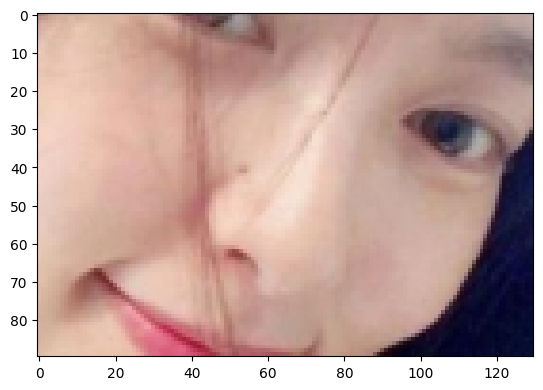

(-7, -13, 114, 110)
14883 14400


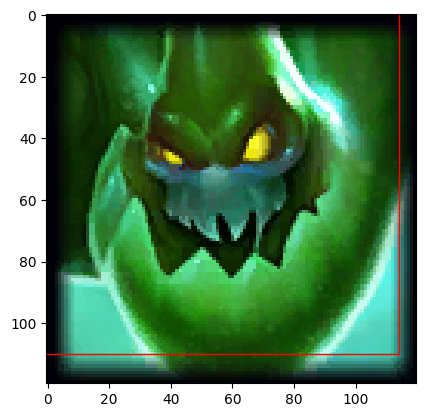

(27, 2, 310, 242)
67920 65145


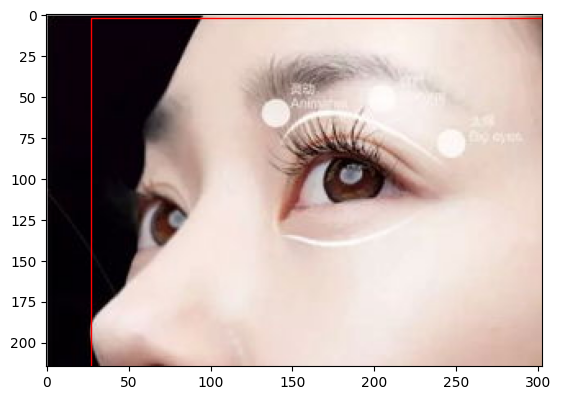

(-36, -6, 301, 454)
155020 135000


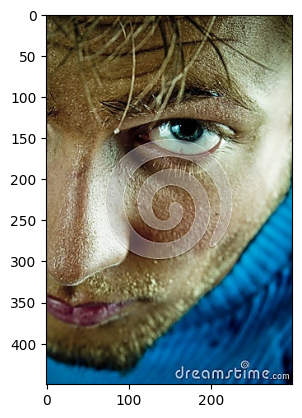

(0, 5, 223, 157)
33896 31536


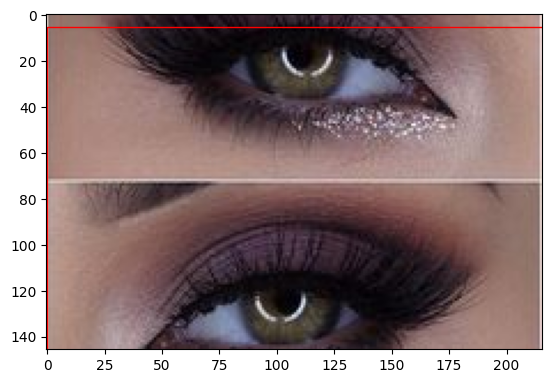

(-33, 6, 555, 452)
262248 191140


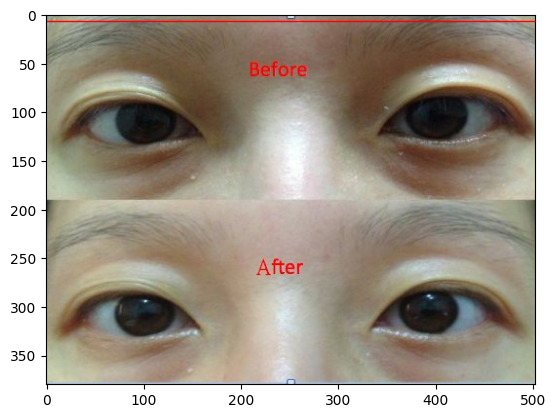

(6, -3, 206, 202)
41000 40000


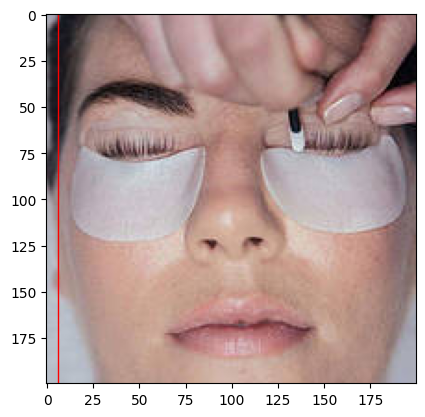

(-5, -27, 295, 188)
64500 56700


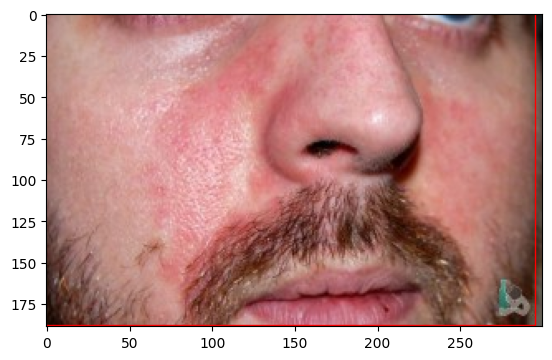

(-1, -3, 91, 113)
10672 9600


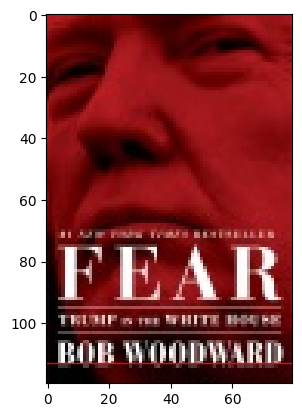

(-4, 0, 69, 78)
5694 5625


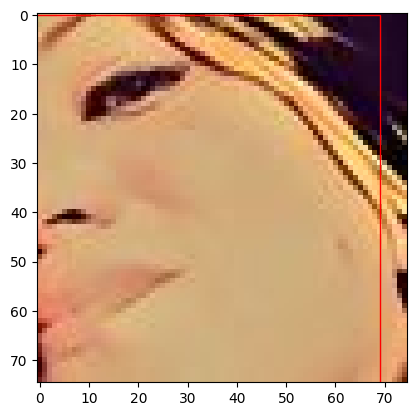

In [571]:
face_to_img_ratio_dict = {}
for _, row in results_df.iterrows():
    ratio = get_face_to_img_ratio(row)
    if ratio is not None:
        face_to_img_ratio_dict[row['uid']] = ratio

In [724]:
single_face_uids = []
for uid in uid_to_annotations:
    face_annotations = uid_to_annotations[uid]
    if len(face_annotations) == 1:
        single_face_uids.append(uid)
single_face_results_df = results_df.loc[results_df['uid'].isin(single_face_uids)]
single_face_results_df['face_ratio'] = single_face_results_df['uid'].map(face_to_img_ratio_dict)
single_face_results_df

/tmp/ipykernel_1557993/2549323285.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  single_face_results_df['face_ratio'] = single_face_results_df['uid'].map(face_to_img_ratio_dict)


,uid,url,text,original_width,original_height,clip_b32_similarity_score,clip_l14_similarity_score,face_bboxes,sha256,face_ratio
2903,679c52457e754058c79aa0ed53a1f9c2,https://bigjimny.com/media/kunena/avatars/resi...,Elikratos's Avatar,144,144,0.237427,0.134155,"[[0.5906437039375305, 0.09305974096059799, 0.6...",313da752d861e5e678ad2016184706021b09d3f0f7235b...,0.003858
3466,7080884b0e5785035f25185394fa0488,https://s3.amazonaws.com/cms.ipressroom.com/36...,Researchers aim to understand COVID-19 in chil...,400,400,0.225952,0.139282,"[[0.12686803936958313, 0.1720641404390335, 0.1...",b7f8ab47edb90ea838295bfa9cefa0d45d64a34e758f70...,0.001275
3831,e5cd240f4d1ba979a05a1e8ae2f58b46,http://lh5.ggpht.com/-w4zJjOaNY-o/UN90xzSKYFI/...,The Growlers @The Fonda,160,160,0.263916,0.282715,"[[0.4248169958591461, 0.2984532117843628, 0.47...",9f93c02c5499345fa3a7eff870f38edca478b5eb0bb321...,0.002461
4152,7c56a3785f76c247f12426fd1f1e09cb,https://profile.alumnius.net/6494999.jpg,"Thomas Cloud, Jr., CFP(R), ChFC(R) Alumnus Photo",300,300,0.244995,0.238037,"[[0.32626962661743164, 0.25057849287986755, 0....",988301a96a383461cad85aacad5800a779aa403a986fb1...,0.236111
5526,1c93325f3b1dc161ad4853ccfde59f6b,https://i.ytimg.com/vi/s_x-lzadVus/hqdefault.jpg,Last Child - Kembali (Official Audio),480,360,0.339600,0.389404,"[[0.6888986229896545, 0.7520278096199036, 0.76...",dac7dc3e5dd55486c539421cf589c798efdc2560bdbd72...,0.008657
...,...,...,...,...,...,...,...,...,...,...
12793317,ebcdf840a58b526954acc6c393748577,https://static1.squarespace.com/static/541734a...,Jim Rotondi Performing At The Artists' Quarter.,960,674,0.281494,0.213745,"[[0.3079739511013031, 0.37980321049690247, 0.4...",8b086044238d710e0f62101de183ee9eb5544b409b0556...,0.047978
12795107,f086c387af61525b21afc298bb664972,https://pics.prcm.jp/6d01c539e1d3e/73739638/jp...,誕生日おめでとうでした！ プリ画像,220,216,0.259277,0.253418,"[[0.24322792887687683, 0.061202868819236755, 0...",d56c927675cc34fee97b870d36b1be1c42d584affba4f6...,0.199116
12798008,4b178c30fc051300270d98116912c0fe,https://i.pinimg.com/216x146/f0/c3/87/f0c38715...,Culture,215,146,0.214600,0.181030,"[[0.39470165967941284, 0.0, 0.5665967464447021...",5754465eb66e5e255fc9e37e01a939baca810734b98551...,0.007009
12798943,e2f047278fc517de7c7da42d3690d6fa,https://lb.jingoo.com/medium/66/14/2198895-273...,Photographe mariage - NICEWEATHER PHOTOGRAPHIE...,345,520,0.282715,0.258057,"[[0.2776043713092804, 0.14536504447460175, 0.5...",4440bedd6a4f5039cc70b0e844152445bcef452ec3bb92...,0.060201


0.0


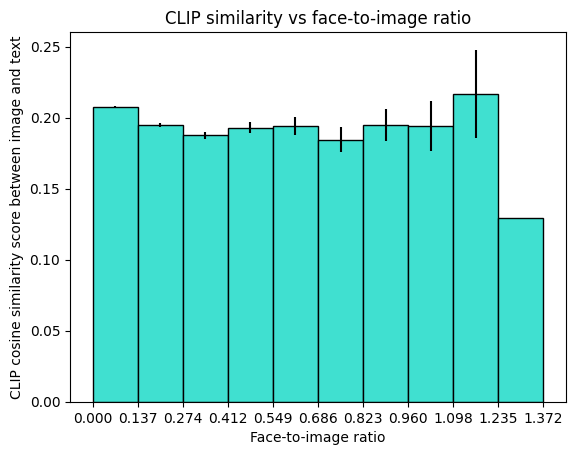

0.00847146575240295
-0.04394600719943872 0.2081802203394777 -0.09204056579792931 3.4164583166785597e-22 0.004526737478308552


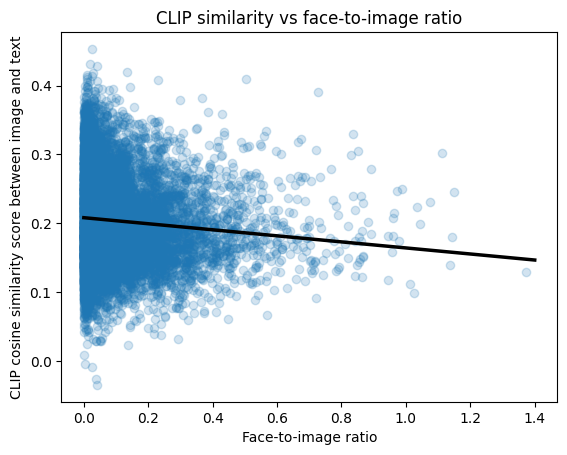

In [758]:
x = np.asarray(single_face_results_df['face_ratio'].tolist())
y = np.asarray(single_face_results_df['clip_l14_similarity_score'].tolist())

bins = np.linspace(x.min(), x.max() + 1e-12, 11) # 10 bins, so 11 bin boundaries
c = np.digitize(x, bins)
plt.bar(bins[:-1], [np.mean(y[c == i]) for i in range(1, len(bins))],
        yerr=[np.std(y[c == i]) / np.sqrt(len(y[c == i])) for i in range(1, len(bins))],
        width=bins[1] - bins[0], align='edge', fc='turquoise', ec='black')
plt.xticks(bins)
plt.xlabel('Face-to-image ratio')
plt.ylabel('CLIP cosine similarity score between image and text')
plt.title('CLIP similarity vs face-to-image ratio')
plt.show()

b, a = np.polyfit(x, y, deg=1)
print(np.corrcoef(x, y)[0,1] ** 2)
slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(x, y)
print(slope, intercept, r_value, p_value, std_err)
# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(0, 1.4, num=100)
# Plot regression line

plt.scatter(x, y, alpha=0.2)
plt.plot(xseq, a + b * xseq, color="k", lw=2.5);
plt.xlabel('Face-to-image ratio')
plt.ylabel('CLIP cosine similarity score between image and text')
plt.title('CLIP similarity vs face-to-image ratio')
plt.show()

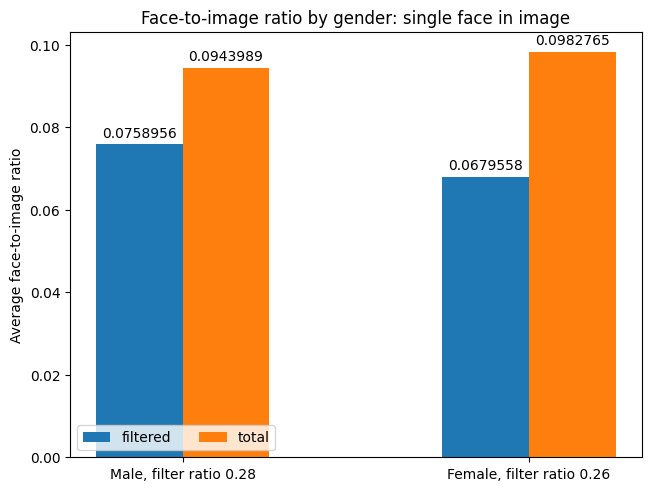

In [581]:
# bar graph: GENDER

graph_results = defaultdict(list)

ratio_by_g = {}
for g in GENDER_LABELS:
    filter_num = len(gender_count[g]['filtered'])
    total_num = len(gender_count[g]['total'])
    ratio_by_g[g] = 1.0 * filter_num / total_num
    
    for k in gender_count[g]:
        group_uids = gender_count[g][k]
        group_ratios = [face_to_img_ratio_dict[uid] for uid in group_uids]
        graph_results[k].append((np.average(group_ratios), np.std(group_ratios)))

x = np.arange(len(GENDER_LABELS))  # the label locations
width = 0.25  # the width of the bars
multiplier = 0

fig, ax = plt.subplots(layout='constrained')

for k, v in graph_results.items():
    offset = width * multiplier
    rects = ax.bar(x + offset, [e[0] for e in v], width=width, label=k) # , yerr=[e[1] for e in v])
    ax.bar_label(rects, padding=3)
    multiplier += 1

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Average face-to-image ratio')
ax.set_title('Face-to-image ratio by gender: single face in image')
ax.set_xticks(x + width/2, [g + ', filter ratio %.2f' % ratio_by_g[g] for g in GENDER_LABELS])
ax.legend(loc='lower left', ncols=3)

plt.show()

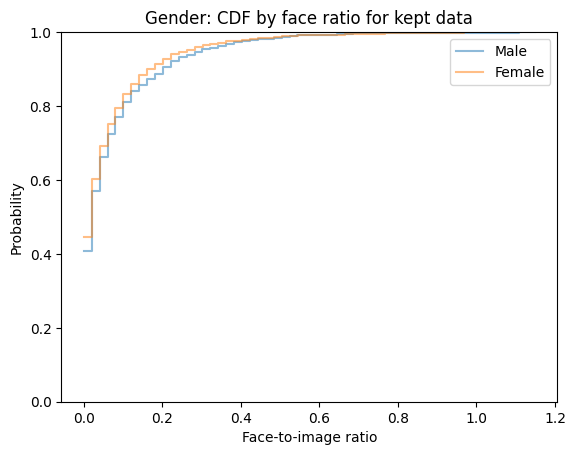

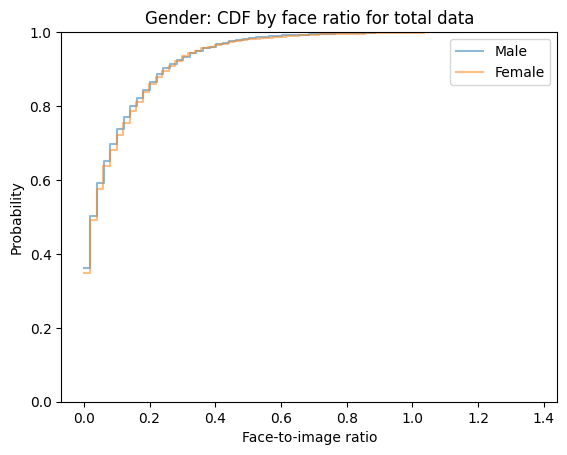

In [622]:
# bar graph: GENDER
DATA_TYPES = [k for k in gender_count[GENDER_LABELS[0]]]
for d in DATA_TYPES:
    for g in GENDER_LABELS:
        group_uids = gender_count[g][d]
        group_ratios = [face_to_img_ratio_dict[uid] for uid in group_uids]
        sns.histplot(
            data=group_ratios, label=g,
            stat='probability',
            cumulative=True, element="step", fill=False,
            alpha=0.5, binwidth=0.02, 
        )
    
    plt.title('Gender: CDF by face ratio for %s data' % ('kept' if d == 'filtered' else d))
    plt.xlabel('Face-to-image ratio')
    plt.legend()
    plt.ylim((0, 1))
#     plt.xlim(0, 0.6)
    plt.show()

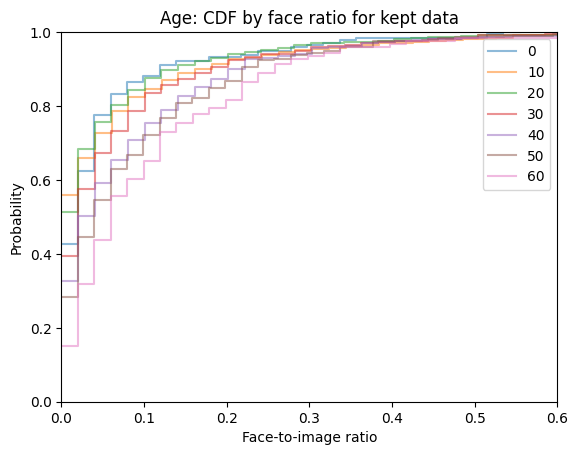

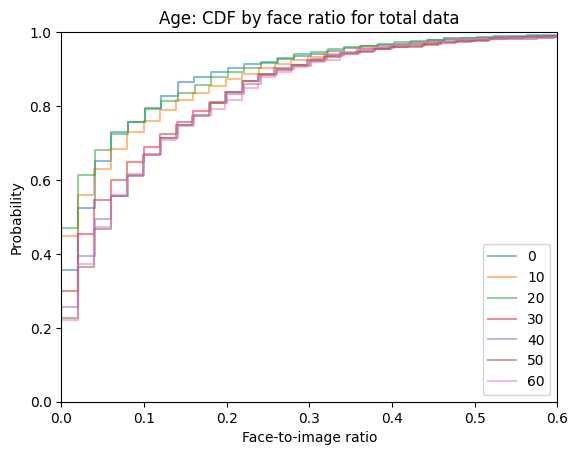

In [624]:
# bar graph: AGE
for d in DATA_TYPES:
    for g in AGE_LABELS:
        group_uids = age_count[g][d]
        group_ratios = [face_to_img_ratio_dict[uid] for uid in group_uids]
        if len(group_ratios) > 120:
            sns.histplot(
                data=group_ratios, label=g,
                stat='probability',
                cumulative=True, element="step", fill=False,
                alpha=0.5, binwidth=0.02, 
            )
#         plt.hist(group_ratios, 50, density=True, label=g, alpha=0.5)
    
    plt.title('Age: CDF by face ratio for %s data' % ('kept' if d == 'filtered' else d))
    plt.xlabel('Face-to-image ratio')
    plt.legend()
    plt.ylim((0, 1.0))
    plt.xlim(0, 0.6)
    plt.show()

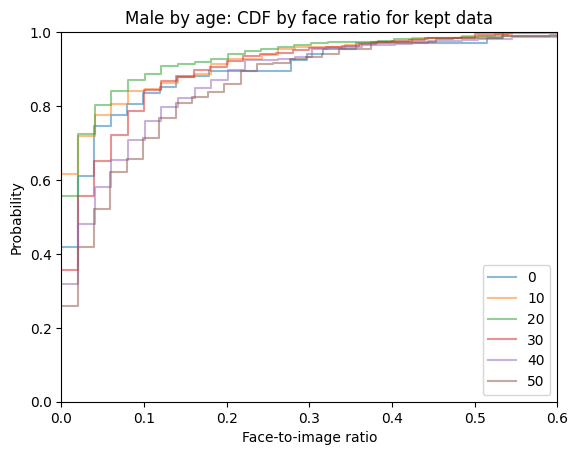

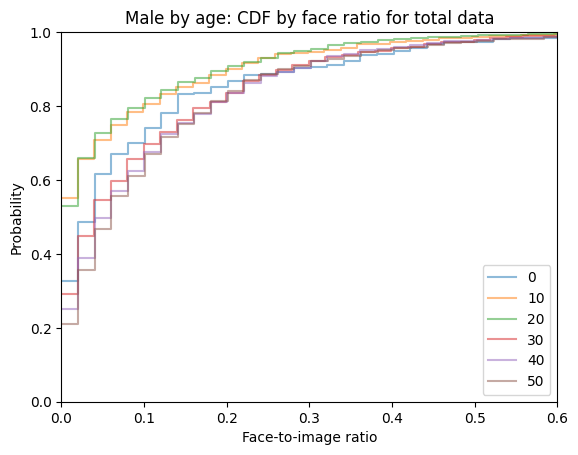

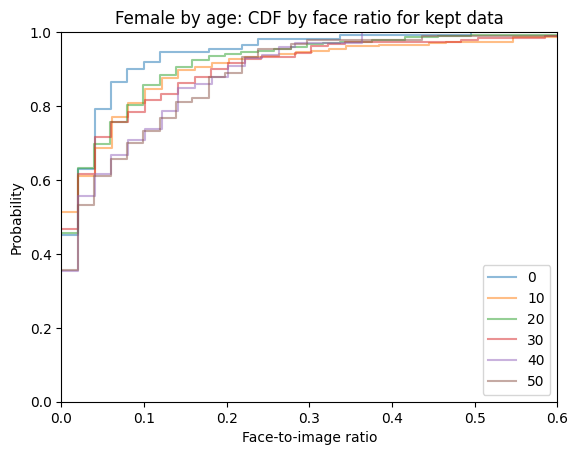

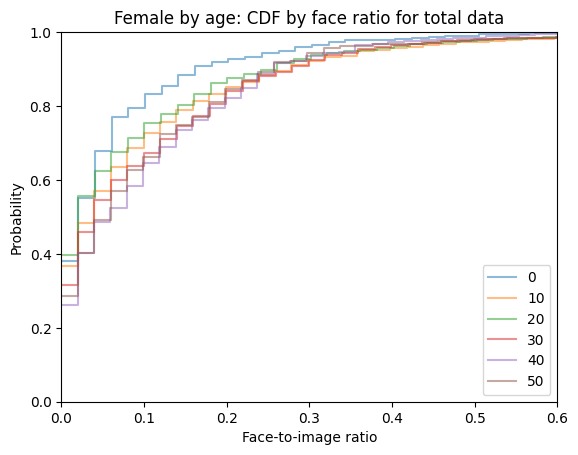

In [626]:
# bar graph: AGE
for g in GENDER_LABELS:
    for d in DATA_TYPES:
        for a in AGE_LABELS:
            if a > 50:
                continue
            key = g + ' ' + str(a)
            group_uids = age_gender_count[key][d]
            group_ratios = [face_to_img_ratio_dict[uid] for uid in group_uids]
            sns.histplot(
                data=group_ratios, label=str(a),
                stat='probability',
                cumulative=True, element="step", fill=False,
                alpha=0.5, binwidth=0.02, 
            )

        plt.title(g + ' by age: CDF by face ratio for %s data' % ('kept' if d == 'filtered' else d))
        plt.xlabel('Face-to-image ratio')
        plt.legend()
        plt.ylim((0, 1.0))
        plt.xlim(0, 0.6)
        plt.show()

# Common words

In [825]:
pattern = re.compile(r'[^A-Za-z ]+')

def clean_caption(caption, as_set=False):
    # only return unique words in caption
    word_set = set(pattern.sub('', caption.lower()).split(' '))
    if as_set:
        return word_set
    else:
        return ' '.join(word_set)

def get_captions(uids, as_dict=False):
    rows = results_df.loc[results_df['uid'].isin(uids)]
    if as_dict:
        uid_to_caption_set = {}
        for _, row in rows.iterrows():
            uid_to_caption_set[row['uid']] = clean_caption(row['text'], as_set=True)
        return uid_to_caption_set
    else:
        return [clean_caption(row['text']) for _, row in rows.iterrows()]

def get_word_freq(filter_uids, total_uids):
    uid_to_caption_set = get_captions(total_uids, as_dict=True)
    
    word_freq = {}
    word_freq['filtered'] = defaultdict(int) # word --> count
    word_freq['total'] = defaultdict(int)
    
    for uid in uid_to_caption_set:
        is_filtered = uid in filter_uids
        for word in uid_to_caption_set[uid]:
            if len(word) > 2 and word not in STOPWORDS:
                word_freq['total'][word] += 1
                if is_filtered:
                    word_freq['filtered'][word] += 1
    return word_freq

## Filter ratio by common word

Male


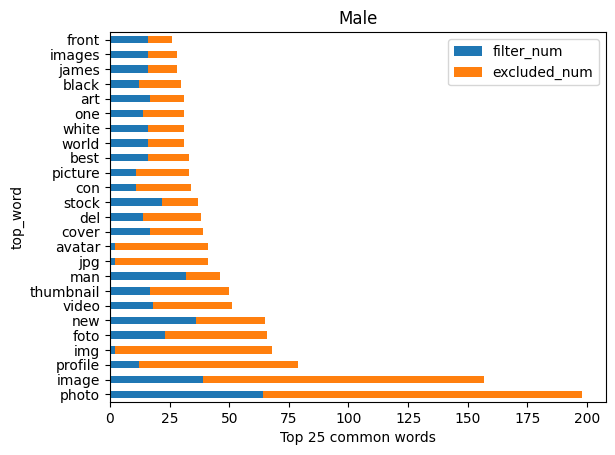

Female


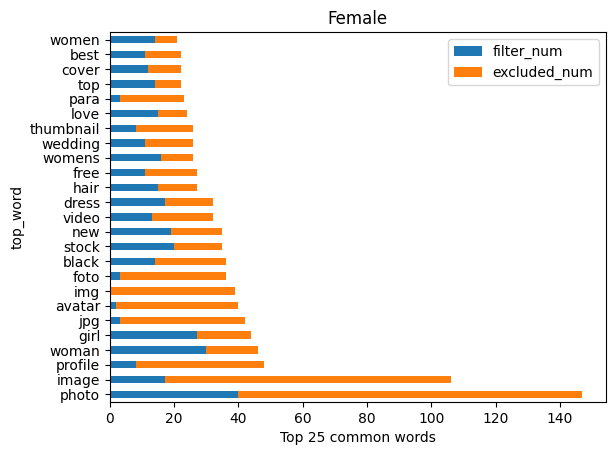

In [826]:
top_num = 25

for g in GENDER_LABELS:
    print(g)    
    total_uids = set(gender_count[g]['total'])
    filter_uids = set(gender_count[g]['filtered'])
    word_freq = get_word_freq(filter_uids, total_uids)
    
    x = [word for word in word_freq['total']]
    raw_nums = [word_freq['total'][word] for word in word_freq['total']]
    sorted_raw_nums_dict = {k: v for v, k in sorted(zip(raw_nums, x), reverse=True)}
    sorted_words = list(sorted_raw_nums_dict.keys())
    sorted_raw_nums = list(sorted_raw_nums_dict.values())
    sorted_filter_nums = [word_freq['filtered'][word] for word in sorted_raw_nums_dict]
    sorted_excluded_nums = np.subtract(sorted_raw_nums, sorted_filter_nums)
    
    plot_df = pd.DataFrame({
        'top_word': sorted_words[:top_num],
        'filter_num': sorted_filter_nums[:top_num],
        'excluded_num': sorted_excluded_nums[:top_num],
#         'bottom_word': list(sorted_raw_nums.keys())[-top_num:],
#         'bottom_num': list(sorted_raw_nums.values())[-top_num:],
    })
    plot_df.plot(kind='barh',stacked=True,x='top_word')
    plt.xlabel('Top 25 common words')
    plt.title(g)
    plt.show()

In [ ]:
top_num = 25

for g in AGE_LABELS:
    print(g)    
    total_uids = set(age_count[g]['total'])
    filter_uids = set(age_count[g]['filtered'])
    word_freq = get_word_freq(filter_uids, total_uids)
    
    x = [word for word in word_freq['total']]
    raw_nums = [word_freq['total'][word] for word in word_freq['total']]
    sorted_raw_nums_dict = {k: v for v, k in sorted(zip(raw_nums, x), reverse=True)}
    sorted_words = list(sorted_raw_nums_dict.keys())
    sorted_raw_nums = list(sorted_raw_nums_dict.values())
    
    sorted_filter_nums = [word_freq['filtered'][word] for word in sorted_raw_nums_dict]
    sorted_excluded_nums = np.subtract(sorted_raw_nums, sorted_filter_nums)
    
    plot_df = pd.DataFrame({
        'top_word': sorted_words[:top_num],
        'filter_num': sorted_filter_nums[:top_num],
        'excluded_num': sorted_excluded_nums[:top_num],
#         'bottom_word': list(sorted_raw_nums.keys())[-top_num:],
#         'bottom_num': list(sorted_raw_nums.values())[-top_num:],
    })
    plot_df.plot(kind='barh',stacked=True,x='top_word')
    plt.xlabel('Top 25 common words')
    plt.title('Age: ' + str(g))
    plt.show()

## Disparate filter ratio by gender

In [827]:
total_results_uids = results_df['uid'].unique()
filter_results_uids = results_df[results_df['is_kept'] == True]['uid'].unique()
results_word_freq = get_word_freq(filter_results_uids, total_results_uids)

print(len(results_word_freq['total']))

top_words = []
n_word_freq = 50
for word in results_word_freq['total']:
    if results_word_freq['total'][word] >= n_word_freq:
        top_words.append(word)
len(top_words)

['photo', 'image', 'profile', 'woman', 'girl', 'jpg', 'avatar', 'img', 'foto', 'black', 'stock', 'new', 'video', 'dress', 'hair', 'free', 'womens', 'wedding', 'thumbnail', 'love', 'para', 'top', 'cover', 'best', 'women', 'del', 'con', 'red', 'picture', 'one', 'art', 'young', 'white', 'baby', 'print', 'online', 'images', 'home', 'fashion', 'dating', 'vintage', 'una', 'single', 'imgjpg', 'dsc', 'time', 'portrait', 'long', 'life', 'ideas', 'happy', 'von', 'front', 'book', 'style', 'princess', 'music', 'download', 'design', 'blue', 'amp', 'und', 'title', 'les', 'hairstyles', 'day', 'trump', 'que', 'poster', 'photos', 'page', 'kids', 'green', 'girls', 'full', 'digital', 'color', 'child', 'van', 'user', 'tshirt', 'ralisation', 'pretty', 'pour', 'photography', 'party', 'los', 'little', 'halloween', 'dscjpg', 'dresses', 'youtube', 'usa', 'summer', 'season', 'review', 'night', 'natural', 'man', 'make']


In [857]:
g_word_freq = {}
total_words = []
g_n_word_freq = 20
for g in GENDER_LABELS:
    print(g)    
    total_uids = set(gender_count[g]['total'])
    filter_uids = set(gender_count[g]['filtered'])
    g_word_freq[g] = get_word_freq(filter_uids, total_uids)
    total_words += [word for word in g_word_freq[g]['total'] if g_word_freq[g]['total'][word] > g_n_word_freq]
total_words = set(total_words)
len(total_words)

Male
Female


54

In [858]:
ratios_by_word = {} # word --> m_ratio, f_ratio
for word in total_words:
    if g_word_freq['Male']['total'][word] >= g_n_word_freq and g_word_freq['Female']['total'][word] >= g_n_word_freq:
        m_ratio = g_word_freq['Male']['filtered'][word] / g_word_freq['Male']['total'][word]
        f_ratio = g_word_freq['Female']['filtered'][word] / g_word_freq['Female']['total'][word]
        ratios_by_word[word] = (m_ratio, f_ratio)
len([word for word in ratios_by_word])

22

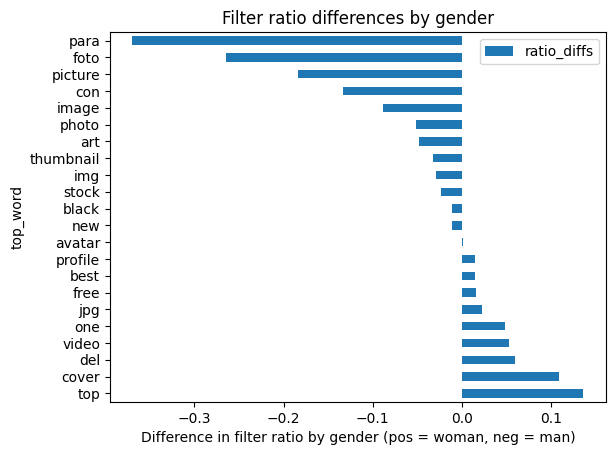

In [861]:
top_words = [word for word in ratios_by_word]
ratio_diff = [ratios_by_word[word][1] - ratios_by_word[word][0] for word in ratios_by_word] # f - m
sorted_ratio_diff_dict = {k: v for v, k in sorted(zip(ratio_diff, top_words), reverse=True)}
sorted_words = list(sorted_ratio_diff_dict.keys())
sorted_ratio_diffs = list(sorted_ratio_diff_dict.values())

plot_df = pd.DataFrame({
    'top_word': sorted_words,
    'ratio_diffs': sorted_ratio_diffs,
})
plot_df.plot(kind='barh',stacked=True,x='top_word')
plt.xlabel('Difference in filter ratio by gender (pos = woman, neg = man)')
plt.title('Filter ratio differences by gender')
plt.show()

## Word clouds

In [ ]:
for g in GENDER_LABELS:
    print(g)
    fig, axes = plt.subplots(1, 2, figsize=(10,6))
    
    filter_uids = set(gender_count[g]['filtered'])
    filtered_captions = get_captions(filter_uids)
    wordcloud = WordCloud(
        max_font_size=50, min_font_size=10, max_words=100, background_color="white"
    ).generate(' '.join(filtered_captions))
    axes[0].imshow(wordcloud, interpolation='bilinear')
    axes[0].set_title('most common words in filtered')
    axes[0].axis("off")

    excluded_uids = set(gender_count[g]['total']).difference(filter_uids)
    excluded_captions = get_captions(excluded_uids)
    wordcloud = WordCloud(
        max_font_size=50, min_font_size=10, max_words=100, background_color="white"
    ).generate(' '.join(excluded_captions))
    axes[1].imshow(wordcloud, interpolation='bilinear')
    axes[1].set_title('most common words in excluded')
    axes[1].axis("off")
    
    plt.show()

In [ ]:
for g in AGE_LABELS:
    print(g)
    fig, axes = plt.subplots(1, 2, figsize=(10,6))
    
    filter_uids = set(age_count[g]['filtered'])
    filtered_captions = get_captions(filter_uids)
    wordcloud = WordCloud(
        max_font_size=50, min_font_size=10, max_words=100, background_color="white"
    ).generate(' '.join(filtered_captions))
    axes[0].imshow(wordcloud, interpolation='bilinear')
    axes[0].set_title('most common words in filtered')
    axes[0].axis("off")

    excluded_uids = set(age_count[g]['total']).difference(filter_uids)
    excluded_captions = get_captions(excluded_uids)
    wordcloud = WordCloud(
        max_font_size=50, min_font_size=10, max_words=100, background_color="white"
    ).generate(' '.join(excluded_captions))
    axes[1].imshow(wordcloud, interpolation='bilinear')
    axes[1].set_title('most common words in filtered')
    axes[1].axis("off")
    
    plt.show()

## Radial charts

In [820]:
# For each identity key word K1: do following for both filtered and excluded
# 1. Get count of top 10 words that appear with K1 by frequency in sample, ignoring STOPWORDS
# (word appear at least once in sample = 1 count)
# 2. For each of those words W1,
    # Get count of top 10 words that appear with K1 and W1 by frequency in sample, ignoring STOPWORDS
    # 3. For each of those words W2,
        # Get count of top 10 words that appear with K1 W1 W2 by frequency in sample, ignoring STOPWORDS
        # 4. For each of those words W3,
            # Get count of top 10 words that appear with K1 W1 W2 W3 by frequency in sample, ignoring STOPWORDS

def get_word_count(k_samples, words=[], top_num=25):
    # get word dict
    k_word_freq = defaultdict(int)
    for s in k_samples:
        intersect = all([w in s for w in words])
        if intersect or words == []:
            for word in s.split(' '):
                if word not in words and len(word) > 2:
                    if word.lower() not in STOPWORDS and not bool(re.search(r'\d', word)):
                        k_word_freq[word.lower()] += 1

    # sort word dict
    sorted_k_word_freq = {k: v for k, v in sorted(
        k_word_freq.items(), key=lambda item: item[1], reverse=True
    )}
    top_word_freq = dict(list(sorted_k_word_freq.items())[:top_num])
    return top_word_freq, sum([sorted_k_word_freq[k] for k in sorted_k_word_freq])

for demo in combined_count:
    print(demo)
    demo_count = combined_count[demo]
    for g in demo_count:
        fig = make_subplots(rows=1, cols=2, specs=[ [{"type": "sunburst"}, {"type": "sunburst"}] ])

        unique_words = set()

        for i_d, d in enumerate(['kept', 'excl']):
            d_uids = None        
            if d == 'kept':
                d_uids = set(demo_count[g]['filtered'])
            else:
                d_uids = set(demo_count[g]['total']).difference(set(demo_count[g]['filtered']))
            d_captions = get_captions(d_uids)

            root = str(g) + ' ' + d

            k_list = []
            w1_list = []
            w2_list = []

            w1_freq, total_w1 = get_word_count(d_captions)
    #         for _ in range(total_w1 - sum([w1_freq[w] for w in w1_freq])):
    #             k_list.append(root)
    #             w1_list.append('_')
    #             w2_list.append('_')

            for w1 in w1_freq:
                unique_words.add(w1)

                w1_n = w1_freq[w1]
                w2_freq, total_w2 = get_word_count(d_captions, words=[w1], top_num=5)

                for w2 in w2_freq:
                    unique_words.add(w2)

                    w2_n = w2_freq[w2]
                    for _ in range(w2_n):
                        k_list.append(root)
                        w1_list.append(w1)
                        w2_list.append(w2)

    #             for _ in range(total_w2 - sum([w2_freq[w] for w in w2_freq])):
    #                 k_list.append(root)
    #                 w1_list.append(w1)
    #                 w2_list.append('_')

            chart_df = pd.DataFrame({
                'k': k_list,
                'w1': w1_list,
                'w2': w2_list,
            })

            figaux = px.sunburst(
                chart_df,
                path=['k', 'w1', 'w2'],
            )
            fig.add_trace(figaux.data[0], row=1, col=1 + i_d)
        fig.update_layout(
            title='Radial chart with top 25 common words: ' + str(g)
        )
        fig.show()


gender


age


age_gender


## Overlap with identity keyword

## Profession

## Sentiment

In [638]:
results_df

,uid,url,text,original_width,original_height,clip_b32_similarity_score,clip_l14_similarity_score,face_bboxes,sha256
512,36cdbfdbb0242dea9f35d8e8ba244034,https://pixhost.icu/avaxhome/a6/27/007e27a6_me...,Le Courrier de l'Ouest Angers – 22 novembre 2020,217,300,0.283447,0.258301,"[[0.8724561929702759, 0.5759853720664978, 0.91...",a2cf4d99ceb01ced10c961aab951b7736e2b9f121c7e88...
741,ac54e51fb59c63f5a0f70c1f4861c073,https://worldofbuzz.com/wp-content/uploads/202...,"No More Verbal Warnings, Mco Phase 2 Will See ...",80,80,0.232178,0.239380,"[[0.0, 0.1678292453289032, 0.23773819208145142...",d9615e4fd8671794cfba0630737462364f5ac76b347251...
1467,8c3a175a53c7a2899a96ab163e9b0b38,https://www.intimateweddings.com/wp-content/up...,New Zealand mountain elopement,467,701,0.309814,0.291504,"[[0.5742679238319397, 0.485332190990448, 0.628...",912f9c7fee28bcbaf803256a3084bfc4c3c7f1eee85e36...
2903,679c52457e754058c79aa0ed53a1f9c2,https://bigjimny.com/media/kunena/avatars/resi...,Elikratos's Avatar,144,144,0.237427,0.134155,"[[0.5906437039375305, 0.09305974096059799, 0.6...",313da752d861e5e678ad2016184706021b09d3f0f7235b...
3466,7080884b0e5785035f25185394fa0488,https://s3.amazonaws.com/cms.ipressroom.com/36...,Researchers aim to understand COVID-19 in chil...,400,400,0.225952,0.139282,"[[0.12686803936958313, 0.1720641404390335, 0.1...",b7f8ab47edb90ea838295bfa9cefa0d45d64a34e758f70...
...,...,...,...,...,...,...,...,...,...
12796929,df62a980c1064ef037c436be8b8fa585,https://i.ytimg.com/vi/TirIvyvLjkY/0.jpg,Republicans CHEATING In Georgia,480,360,0.290283,0.263916,"[[0.20814579725265503, 0.36898717284202576, 0....",23aa87722b8d0f84840ce8ce280cb9d2200f082fa6bb8f...
12798008,4b178c30fc051300270d98116912c0fe,https://i.pinimg.com/216x146/f0/c3/87/f0c38715...,Culture,215,146,0.214600,0.181030,"[[0.39470165967941284, 0.0, 0.5665967464447021...",5754465eb66e5e255fc9e37e01a939baca810734b98551...
12798376,bf116df22a2827b3310e37396576cb70,http://lionsclubpoznanrotunda.org/wp-content/g...,Wigilia 2010,218,160,0.243652,0.141235,"[[0.5503153800964355, 0.014322477392852306, 0....",337814ff91db2e6b568570103fc4178c0554c428ff5ddb...
12798943,e2f047278fc517de7c7da42d3690d6fa,https://lb.jingoo.com/medium/66/14/2198895-273...,Photographe mariage - NICEWEATHER PHOTOGRAPHIE...,345,520,0.282715,0.258057,"[[0.2776043713092804, 0.14536504447460175, 0.5...",4440bedd6a4f5039cc70b0e844152445bcef452ec3bb92...


In [884]:
# by identity keyword

def get_captions(uids, as_dict=False, as_set=True):
    rows = results_df.loc[results_df['uid'].isin(uids)]
    if as_dict:
        uid_to_caption_dict = {}
        for _, row in rows.iterrows():
            uid_to_caption_dict[row['uid']] = row['text']
        return uid_to_caption_dict
    else:
        return [row['text'] for _, row in rows.iterrows()]

In [885]:
# using multilingual given text
sentiment_model = "lxyuan/distilbert-base-multilingual-cased-sentiments-student" 
# "distilbert-base-uncased-finetuned-sst-2-english"
sentiment_pipeline = pipeline("sentiment-analysis", model=sentiment_model)
sentiment_pipeline(["I love you", "I hate you"])

def get_sentiment_of_captions(filtered_uids, excluded_uids, THRESHOLD = 0.8, NUM_SAMPLE=500):
    sample_filtered_uids = random.sample(list(filtered_uids), NUM_SAMPLE)
    sample_excluded_uids = random.sample(list(excluded_uids), NUM_SAMPLE)
    
    sample_uids = {
        'filtered': sample_filtered_uids,
        'excluded': sample_excluded_uids
    }
    sample_captions = {
        k: get_captions(sample_uids[k], as_dict=True) for k in sample_uids
    }
    
    sentiment_dict = {'filtered': defaultdict(list), 'excluded': defaultdict(list)}
    for k in sample_captions:
        print(k)
        captions = sample_captions[k]
        for uid, c in captions.items():
            try:
                sentiment_result = sentiment_pipeline([c])[0]
#                 if sentiment_result['score'] >= THRESHOLD:
    #                 print(captions[i], sentiment_result)
                sentiment_dict[k][sentiment_result['label']].append((uid, sentiment_result['score']))
            except Exception as e:
                print("ERROR", e)
    return sentiment_dict

In [890]:
demo_to_sentiment_dict = {}
NUM_SAMPLE = 100

for demo in combined_count:
    demo_to_sentiment_dict[demo] = {}
    
    demo_count = combined_count[demo]
    for g in demo_count:
        print(g)
        g_filtered_uids = set(demo_count[g]['filtered'])
        g_total_uids = set(demo_count[g]['total'])
        g_excluded_uids = g_total_uids.difference(g_filtered_uids)
        num = min(len(g_filtered_uids), len(g_excluded_uids))
        if num >= NUM_SAMPLE: 
            demo_to_sentiment_dict[demo][g] = get_sentiment_of_captions(
                g_filtered_uids, g_excluded_uids, NUM_SAMPLE=NUM_SAMPLE
            )

Male
filtered
excluded
Female
filtered
excluded
0
filtered
excluded
10
filtered
excluded
20
filtered
excluded
30
filtered
excluded
40
filtered
excluded
50
filtered
excluded
60
filtered
excluded
70
80
90
Male 0
Male 10
filtered
excluded
Male 20
filtered
excluded
Male 30
filtered
excluded
Male 40
filtered
excluded
Male 50
filtered
excluded
Male 60
filtered
excluded
Male 70
Male 80
Male 90
Female 0
filtered
excluded
Female 10
filtered
excluded
Female 20
filtered
excluded
Female 30
filtered
excluded
Female 40
Female 50
Female 60
Female 70
Female 80
Female 90


In [891]:
for demo in demo_to_sentiment_dict:
    for k in demo_to_sentiment_dict[demo]:
        for d in demo_to_sentiment_dict[demo][k]:
            for s in demo_to_sentiment_dict[demo][k][d]:
                n = len(demo_to_sentiment_dict[demo][k][d][s])
                print(demo, k, d, s, n)

gender Male filtered positive 92
gender Male filtered negative 8
gender Male excluded positive 92
gender Male excluded negative 8
gender Female filtered positive 90
gender Female filtered negative 9
gender Female filtered neutral 1
gender Female excluded positive 88
gender Female excluded neutral 1
gender Female excluded negative 11
age 0 filtered positive 91
age 0 filtered negative 7
age 0 filtered neutral 2
age 0 excluded negative 11
age 0 excluded positive 88
age 0 excluded neutral 1
age 10 filtered positive 94
age 10 filtered negative 5
age 10 filtered neutral 1
age 10 excluded positive 89
age 10 excluded negative 11
age 20 filtered positive 85
age 20 filtered negative 13
age 20 filtered neutral 2
age 20 excluded positive 94
age 20 excluded negative 4
age 20 excluded neutral 2
age 30 filtered positive 93
age 30 filtered neutral 1
age 30 filtered negative 6
age 30 excluded positive 92
age 30 excluded negative 7
age 30 excluded neutral 1
age 40 filtered positive 86
age 40 filtered ne

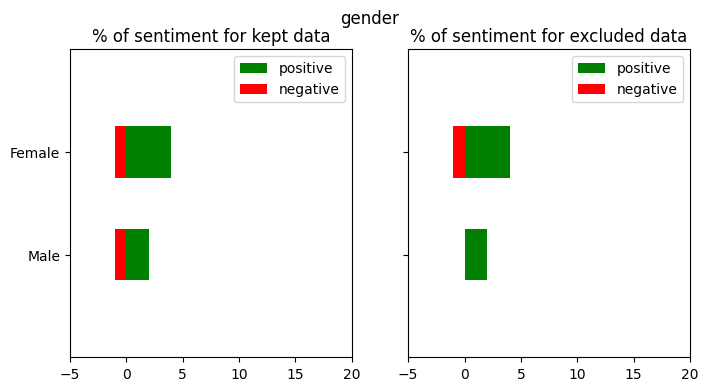

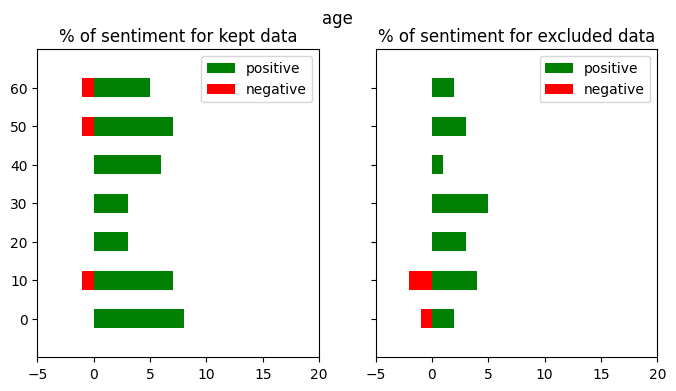

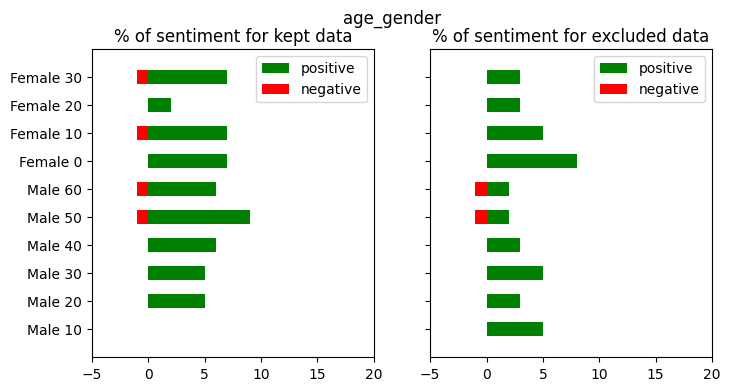

In [892]:
DATA_TYPES = ['filtered', 'excluded']
NUM_SAMPLE = 100
THRESHOLD = 0.8
SENTIMENT_LABELS = ['positive', 'negative']


for demo in demo_to_sentiment_dict:
    fig, axes = plt.subplots(1, 2, figsize=(8, 4), sharex=True, sharey=True)
        
    g_to_sentiment_dict = demo_to_sentiment_dict[demo]

    for i_d, d in enumerate(DATA_TYPES):
        ax = axes[i_d]
        for i_s, s in enumerate(SENTIMENT_LABELS):
            X = []
            Y = []
            for g in g_to_sentiment_dict:
                total_across_s = sum([len(g_to_sentiment_dict[g][d][s1]) for s1 in g_to_sentiment_dict[g][d]])
                if total_across_s == 0:
                    continue
                uid_scores = g_to_sentiment_dict[g][d][s]
                conf_uids = [uid for (uid, score) in uid_scores if score >= THRESHOLD]
                X.append(str(g))
                Y.append(len(conf_uids) / total_across_s * 100)

            # plot the bars
            ax.barh(
                X,
                np.asarray(Y) * (1 if i_s == 0 else -1), color = 'g' if i_s == 0 else 'r',
                label=s,
                height=0.5
            )

        ax.legend()
        ax.set_ylim(-1,len(X))
        ax.set_title("% of sentiment for " + ("kept" if i_d == 0 else d) + " data")
    plt.suptitle(demo)
    plt.xlim(-5, 20)
    plt.show()

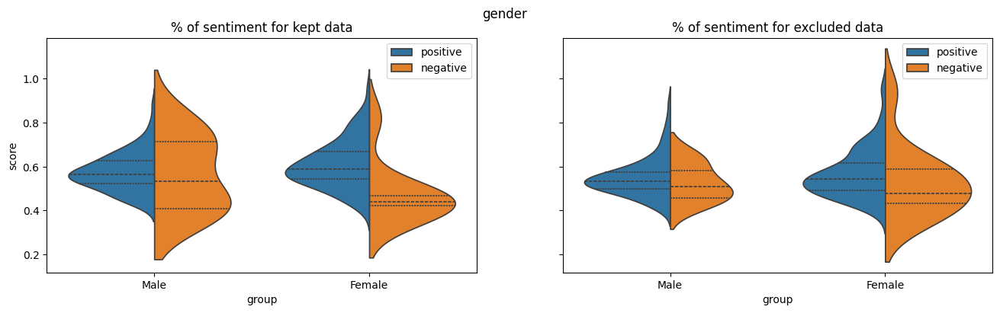

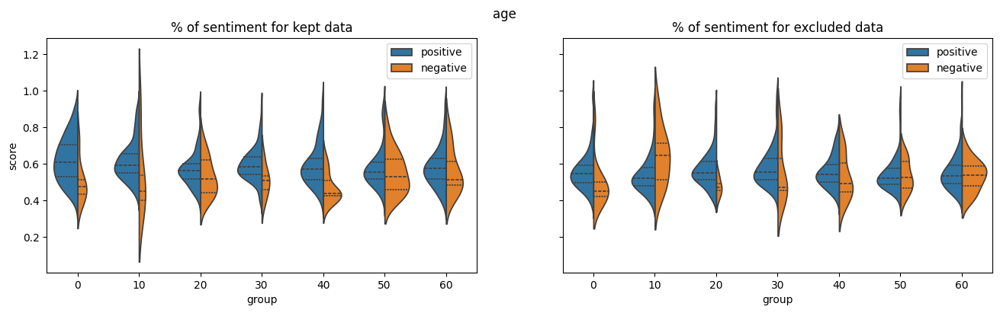

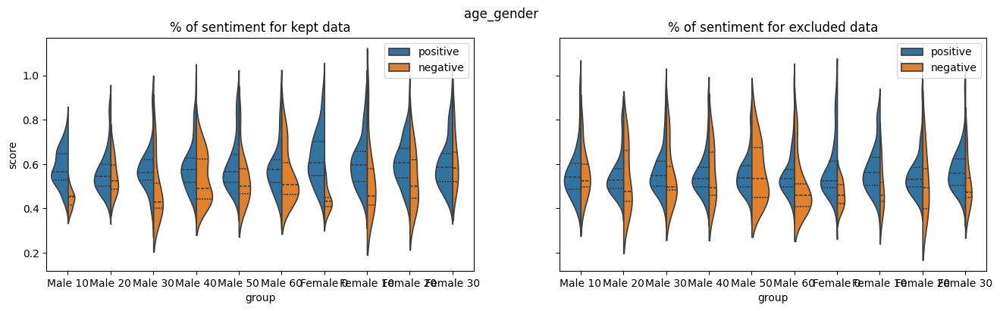

In [893]:
DATA_TYPES = ['filtered', 'excluded']
NUM_SAMPLE = 500
THRESHOLD = 0.8
SENTIMENT_LABELS = ['positive', 'negative']


for demo in demo_to_sentiment_dict:
    fig, axes = plt.subplots(1, 2, figsize=(16, 4), sharey=True)
    
    g_to_sentiment_dict = demo_to_sentiment_dict[demo]

    for i_d, d in enumerate(DATA_TYPES):
        ax = axes[i_d]
        sentiment_df_dict = defaultdict(list)
        
        for i_s, s in enumerate(SENTIMENT_LABELS):
            for g in g_to_sentiment_dict:
                total_across_s = sum([len(g_to_sentiment_dict[g][d][s1]) for s1 in g_to_sentiment_dict[g][d]])
                if total_across_s == 0:
                    continue
                uid_scores = g_to_sentiment_dict[g][d][s]
                
                for (_, score) in uid_scores:
                    sentiment_df_dict['group'].append(g)
                    sentiment_df_dict['score'].append(score)
                    sentiment_df_dict['sentiment'].append(s)

        sentiment_df = pd.DataFrame.from_dict(sentiment_df_dict)
        sns.violinplot(
            data=sentiment_df,
            x="group", y="score", hue="sentiment",
            split=True, inner="quart", ax=ax,
            density_norm='count'
        )

        ax.legend()
        ax.set_title("% of sentiment for " + ("kept" if i_d == 0 else d) + " data")
    plt.suptitle(demo)
    plt.show()

### View sample sentiment scores

In [680]:
opener = urlopen.build_opener()
opener.addheaders = [('User-Agent', 'Chrome')]
urlopen.install_opener(opener)

def download_url(url, image_path, caption, ax):
    if not os.path.isfile(image_path):
        raise Exception('File does not exist')
        # urlopen.urlretrieve(url, image_path)

    img = plt.imread(image_path)
    ax.imshow(img)
    ax.set_title("\n".join(wrap(caption, 40)), fontsize=8)

def display_sentiment_sample(sample, score_dict=None, ylabel='', title='', NUM_SAMPLE=20, NUM_COL=5):
    resample = sample.sample(2 * NUM_SAMPLE) if len(sample) >= 2 * NUM_SAMPLE else sample
    NUM_ROW = NUM_SAMPLE // NUM_COL
    
    fig, axes = plt.subplots(NUM_ROW, NUM_COL, figsize=(9,3))
    fig.tight_layout(pad=2.0)

    i = 0
    for _, row in resample.iterrows():
        if i >= NUM_SAMPLE:
            break

        ax = axes[i % NUM_COL] # axes[i // NUM_COL][i % NUM_COL]
        caption = f'%.2f ' % score_dict[row['uid']] + row['text']
        uid = row['uid']
        url = row['url']
        ext = url.split('.')[-1]
        image_path = os.path.join(sample_image_dir, uid + '.' + ext)

        try:
            download_url(url, image_path, caption, ax)
#             print(url)
            i += 1
        except:
            pass
    
    axes[0].set_ylabel(ylabel)
    plt.suptitle(title, y=0.05)
    plt.show()

gender
positive
83


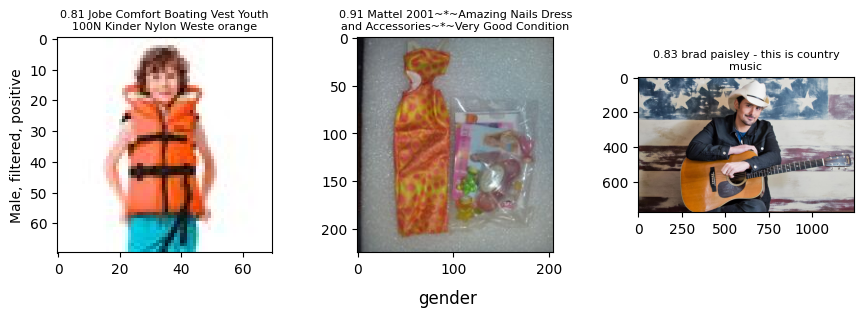

negative
4


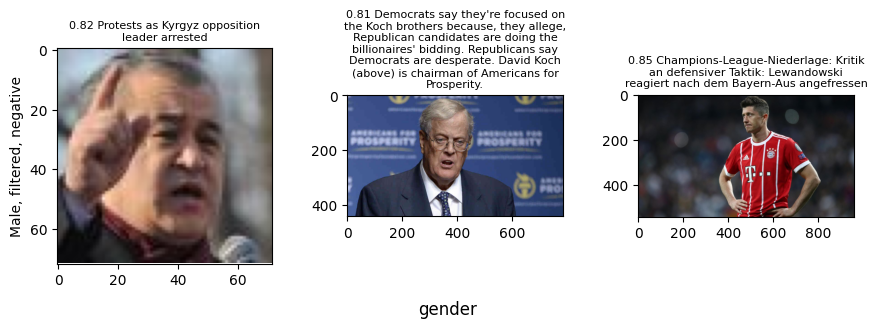

neutral
0
positive
138


/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12467 (\N{KATAKANA LETTER KO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12510 (\N{KATAKANA LETTER MA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12472 (\N{KATAKANA LETTER ZI}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12459 (\N{KATAKANA LETTER KA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12523

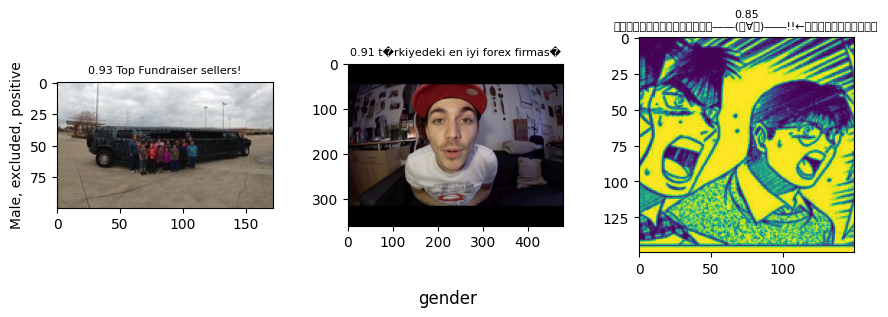

negative
19


/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 27602 (\N{CJK UNIFIED IDEOGRAPH-6BD2}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 29399 (\N{CJK UNIFIED IDEOGRAPH-72D7}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 21517 (\N{CJK UNIFIED IDEOGRAPH-540D}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 21578 (\N{CJK UNIFIED IDEOGRAPH-544A}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.

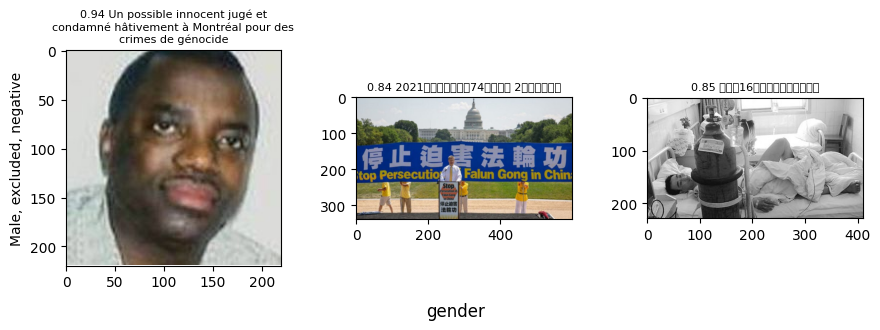

neutral
0
positive
76


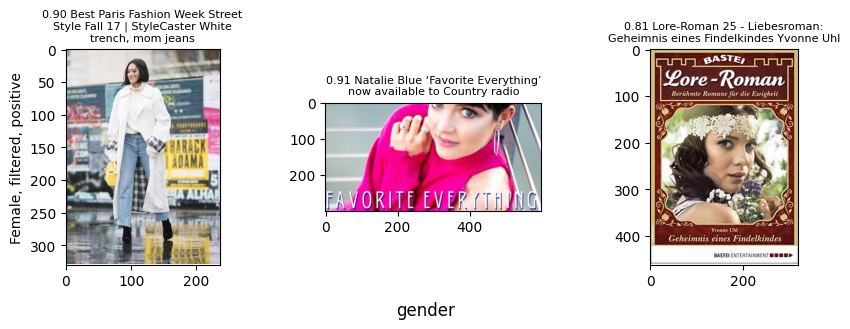

negative
4


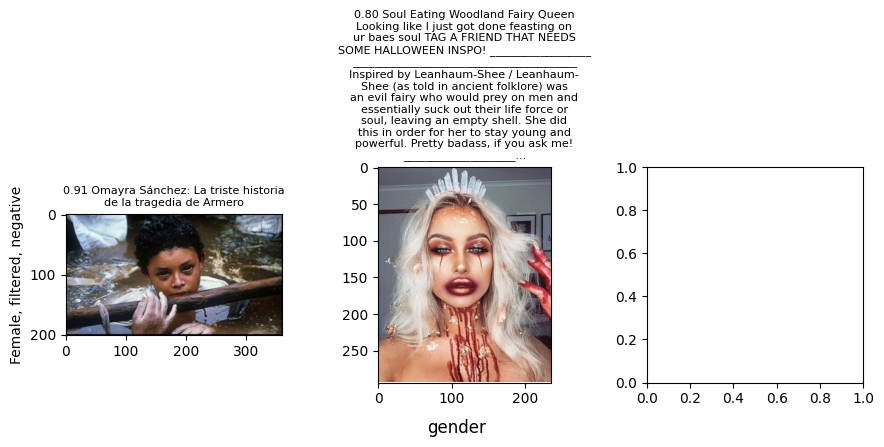

neutral
0
positive
126


/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 26579 (\N{CJK UNIFIED IDEOGRAPH-67D3}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 25104 (\N{CJK UNIFIED IDEOGRAPH-6210}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 23130 (\N{CJK UNIFIED IDEOGRAPH-5A5A}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 39532 (\N{CJK UNIFIED IDEOGRAPH-9A6C}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.

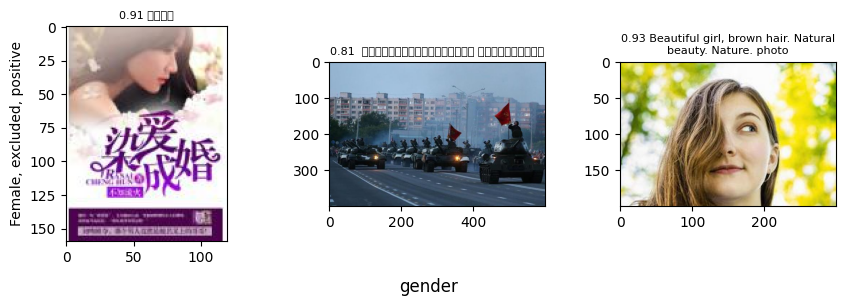

negative
9


/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 31070 (\N{CJK UNIFIED IDEOGRAPH-795E}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 21520 (\N{CJK UNIFIED IDEOGRAPH-5410}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 27133 (\N{CJK UNIFIED IDEOGRAPH-69FD}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 35201 (\N{CJK UNIFIED IDEOGRAPH-8981}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.

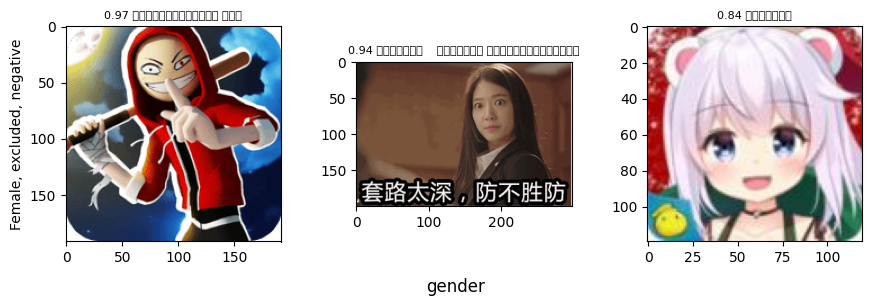

neutral
0
age
positive
14


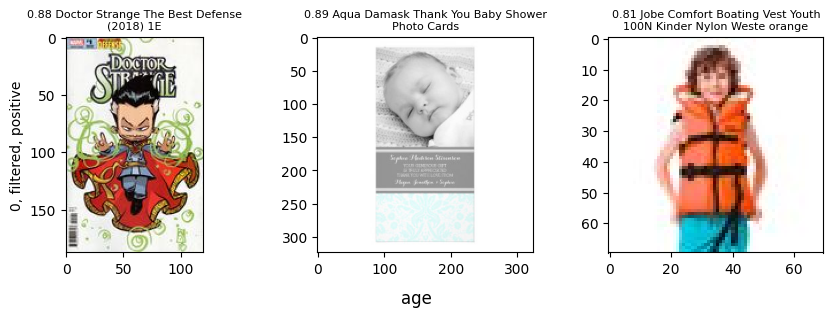

negative
0
neutral
0
negative
1


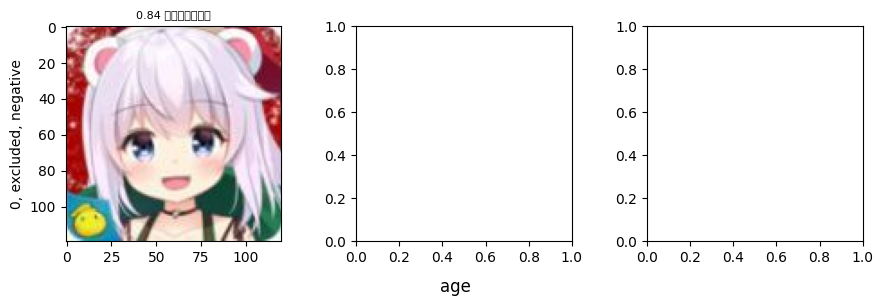

positive
19


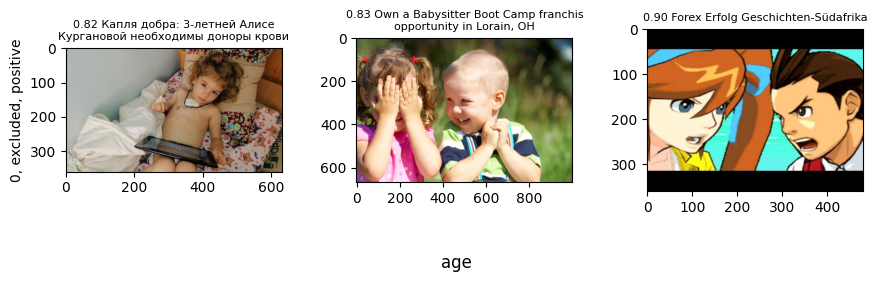

neutral
0
positive
22


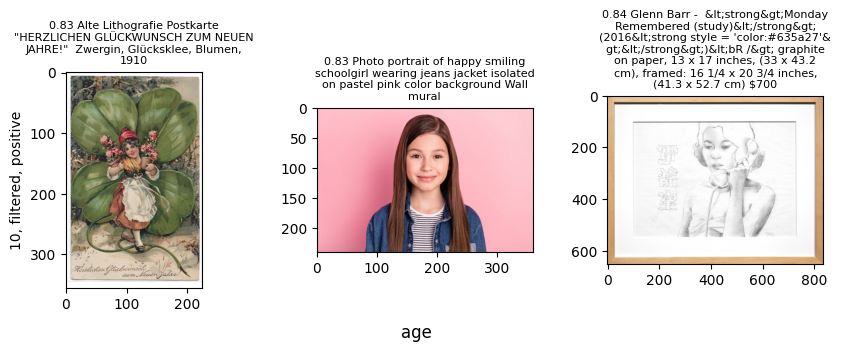

negative
1


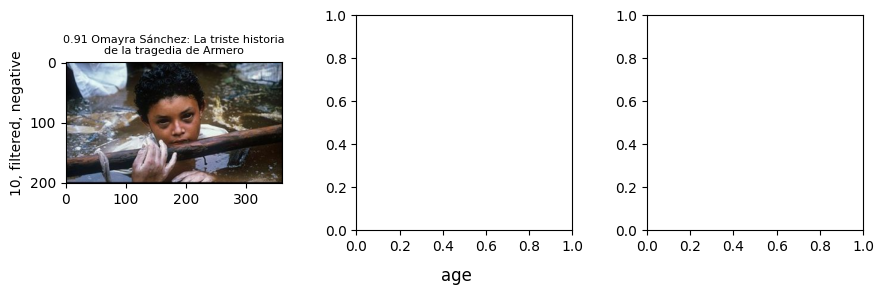

neutral
0
negative
7


/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 22082 (\N{CJK UNIFIED IDEOGRAPH-5642}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12496 (\N{KATAKANA LETTER BA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12474 (\N{KATAKANA LETTER ZU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12500 (\N{KATAKANA LETTER PI}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Gly

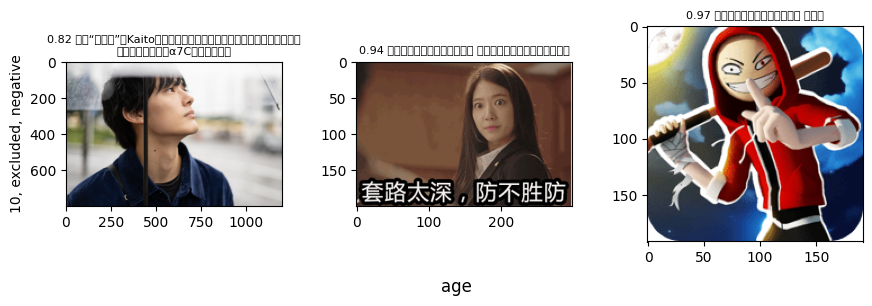

positive
49


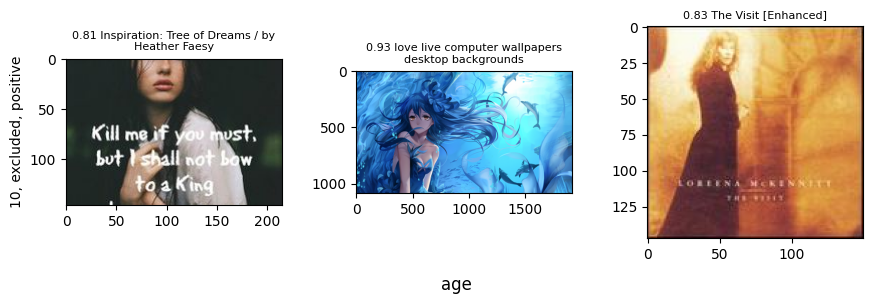

neutral
0
positive
46


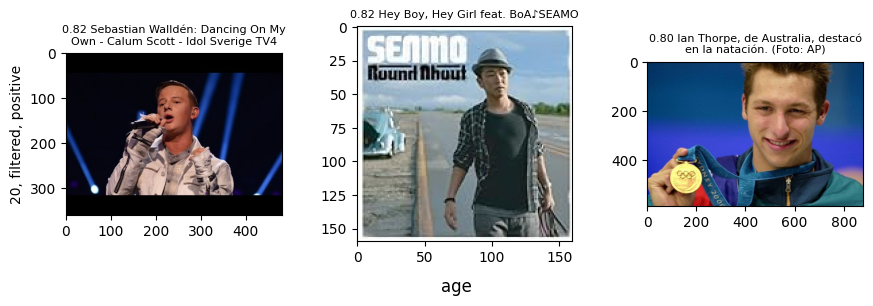

negative
2


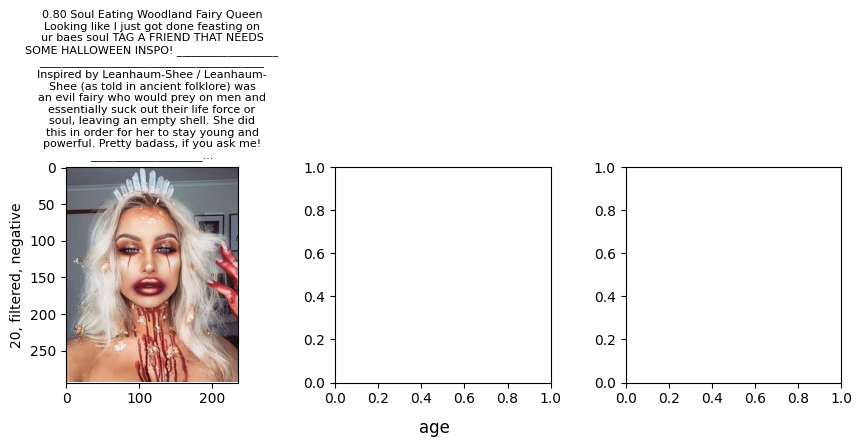

neutral
0
positive
76


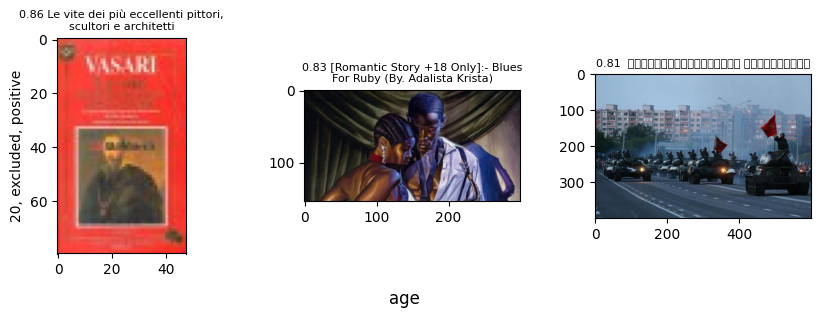

negative
6


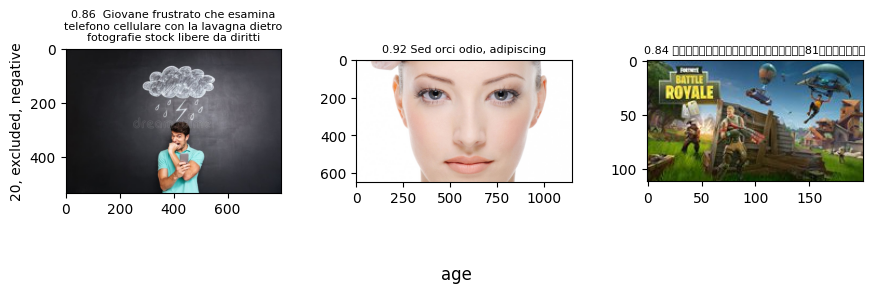

neutral
0
positive
29


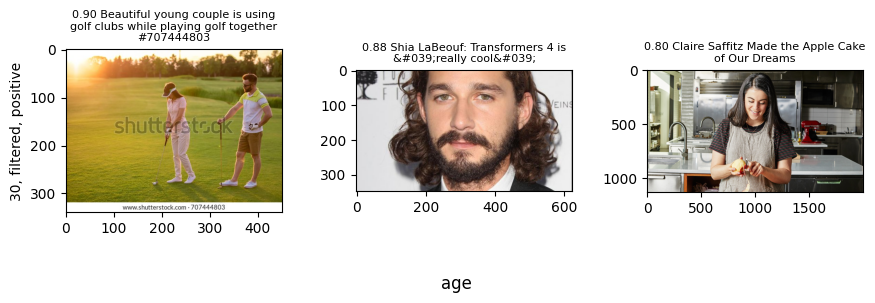

negative
3


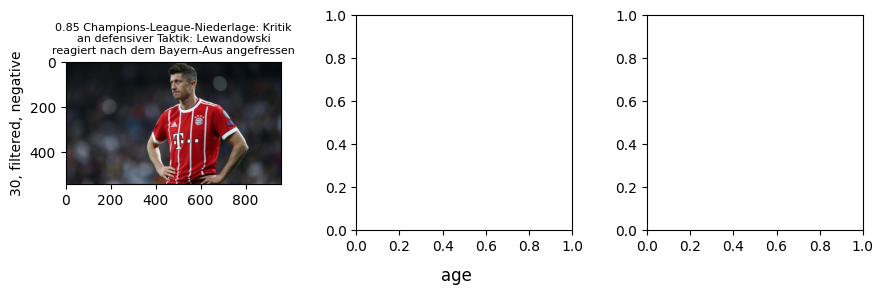

neutral
0
positive
53


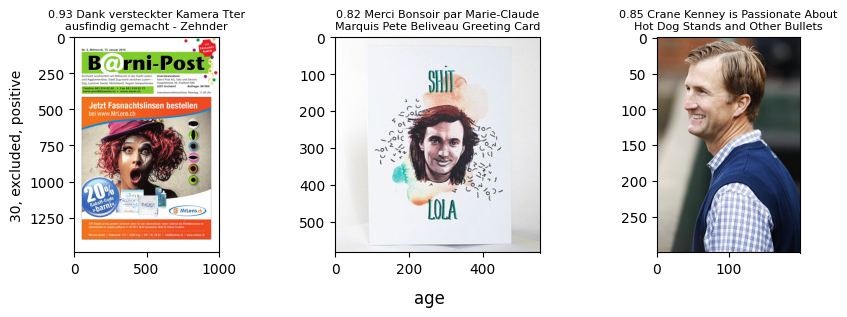

negative
4


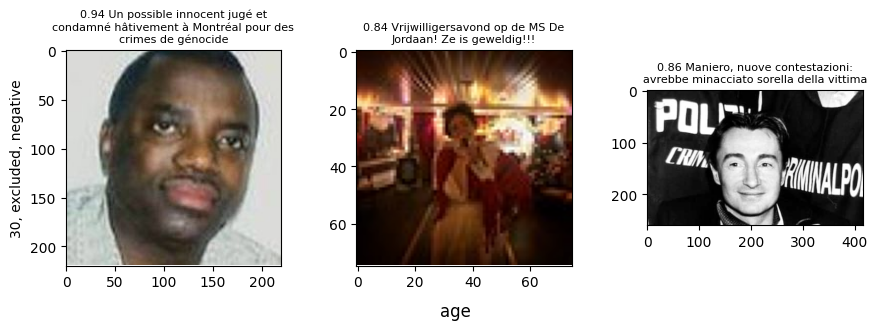

neutral
0
positive
17


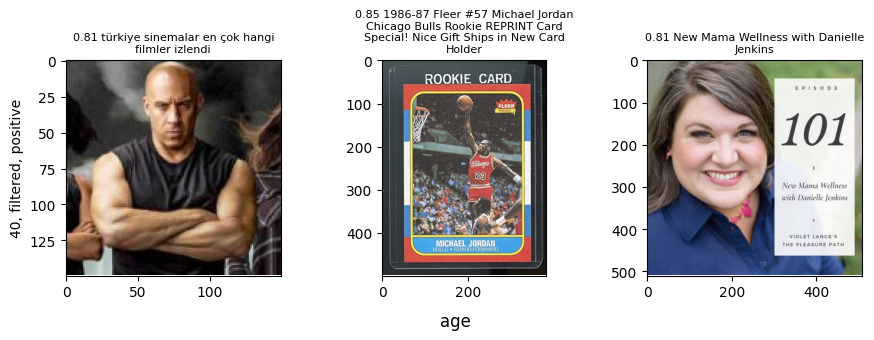

negative
0
neutral
0
positive
34


/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 23665 (\N{CJK UNIFIED IDEOGRAPH-5C71}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 39128 (\N{CJK UNIFIED IDEOGRAPH-98D8}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 39321 (\N{CJK UNIFIED IDEOGRAPH-9999}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


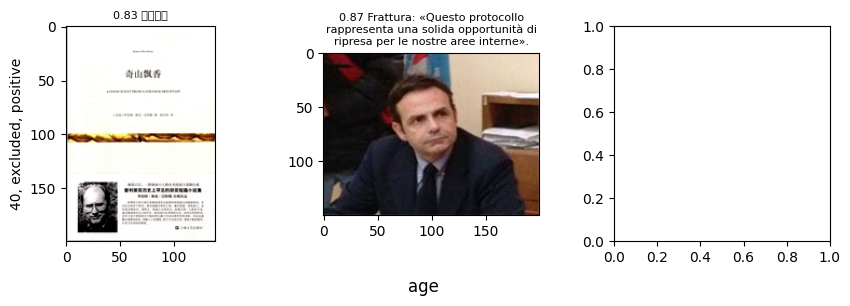

negative
6


/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 26032 (\N{CJK UNIFIED IDEOGRAPH-65B0}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 28459 (\N{CJK UNIFIED IDEOGRAPH-6F2B}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 23041 (\N{CJK UNIFIED IDEOGRAPH-5A01}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 30005 (\N{CJK UNIFIED IDEOGRAPH-7535}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.

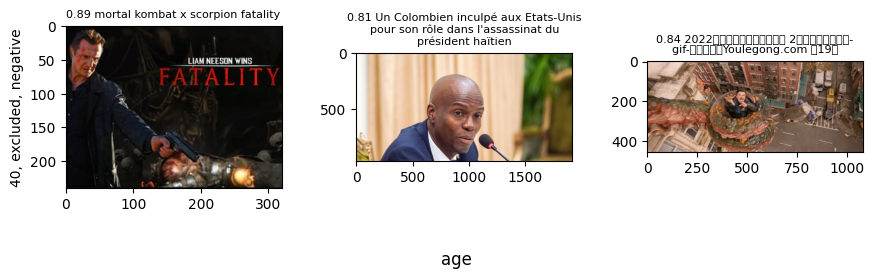

neutral
0
positive
21


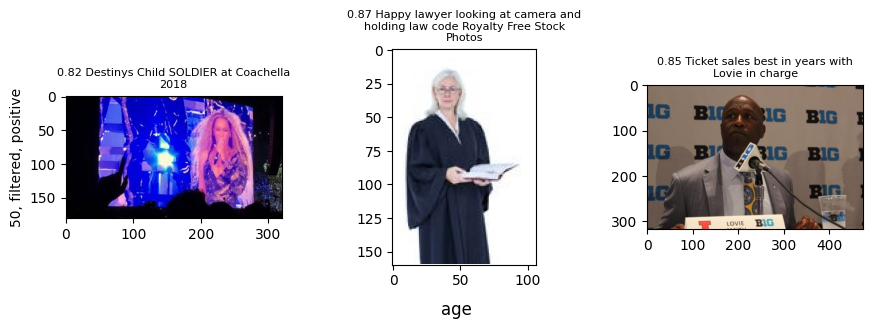

negative
1


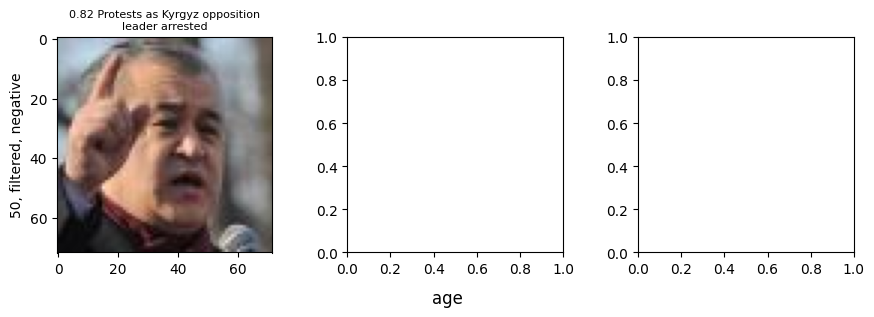

neutral
0
positive
24


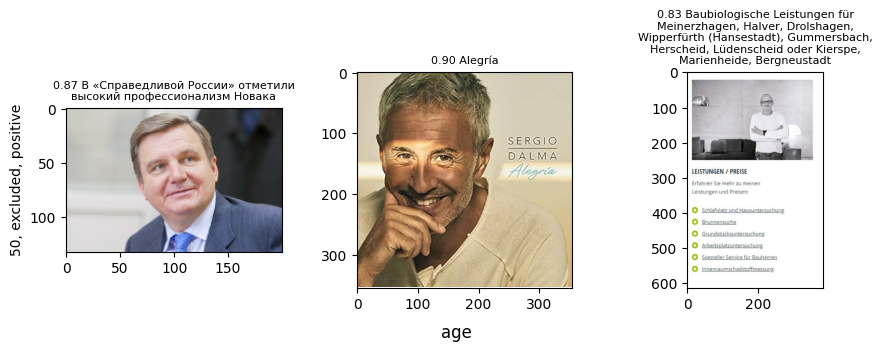

negative
3


/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 28595 (\N{CJK UNIFIED IDEOGRAPH-6FB3}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 27954 (\N{CJK UNIFIED IDEOGRAPH-6D32}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 25511 (\N{CJK UNIFIED IDEOGRAPH-63A7}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 35380 (\N{CJK UNIFIED IDEOGRAPH-8A34}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.

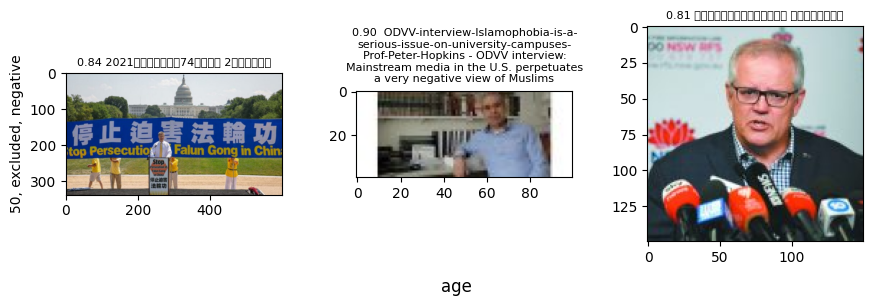

neutral
0
positive
7


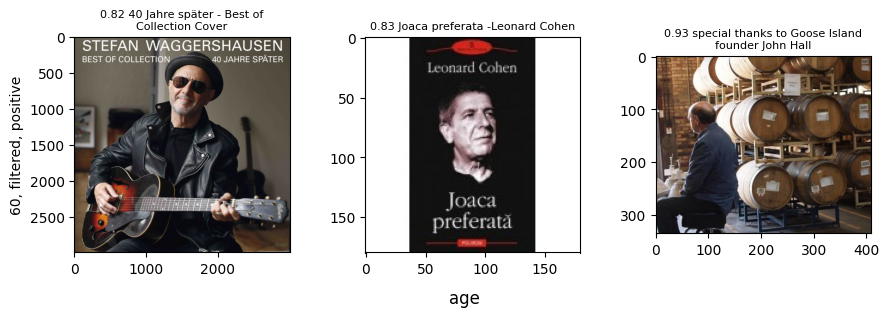

negative
1


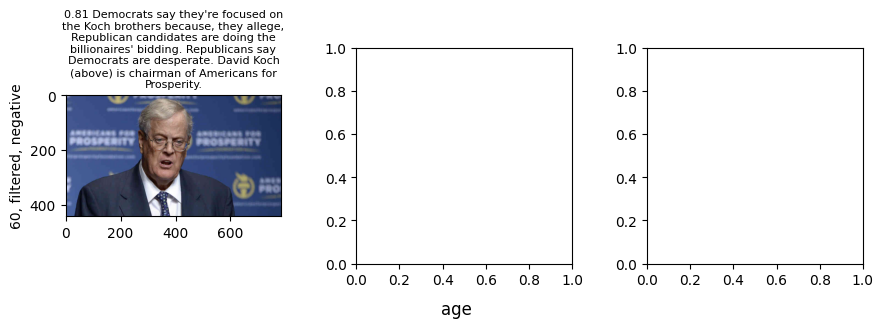

neutral
0
positive
8


/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 38738 (\N{CJK UNIFIED IDEOGRAPH-9752}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 21019 (\N{CJK UNIFIED IDEOGRAPH-521B}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 19994 (\N{CJK UNIFIED IDEOGRAPH-4E1A}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 26790 (\N{CJK UNIFIED IDEOGRAPH-68A6}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.

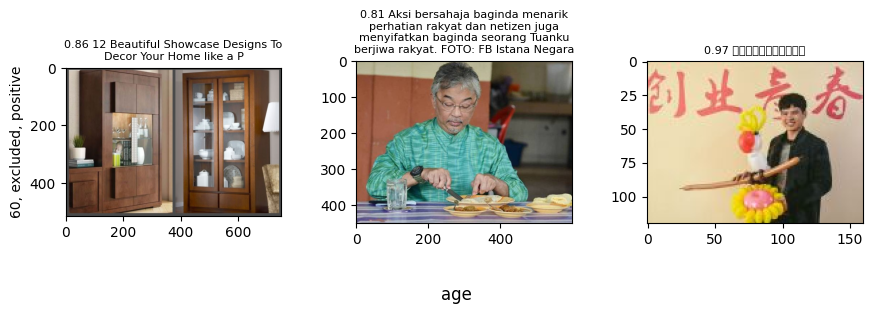

negative
1


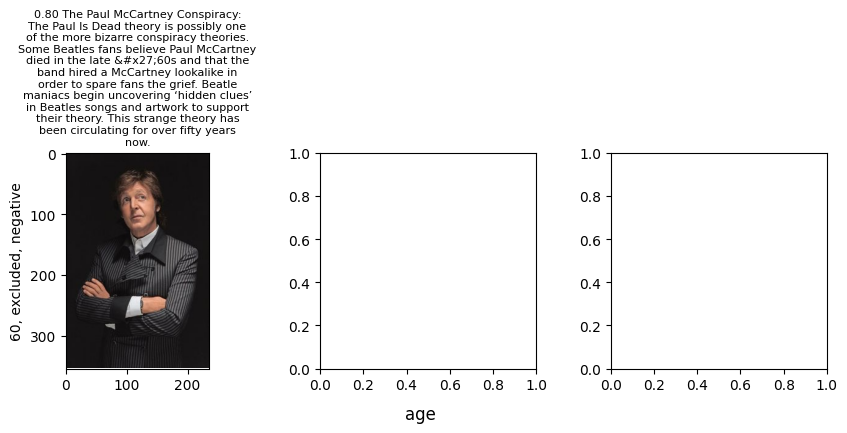

neutral
0
positive
3


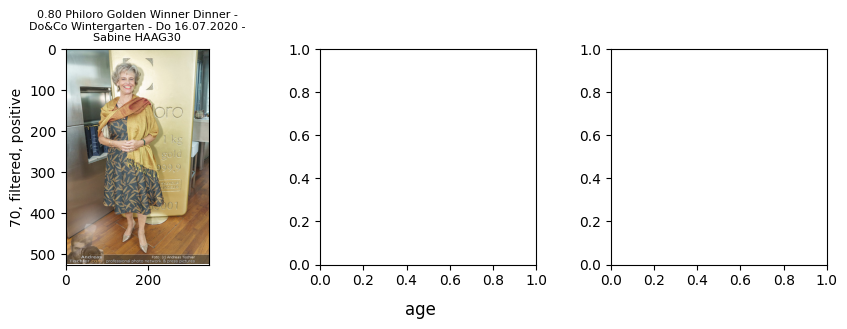

negative
0
positive
0
neutral
0
negative
0
positive
0
negative
0
positive
1


/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 21345 (\N{CJK UNIFIED IDEOGRAPH-5361}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 36890 (\N{CJK UNIFIED IDEOGRAPH-901A}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 36896 (\N{CJK UNIFIED IDEOGRAPH-9020}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 22411 (\N{CJK UNIFIED IDEOGRAPH-578B}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.

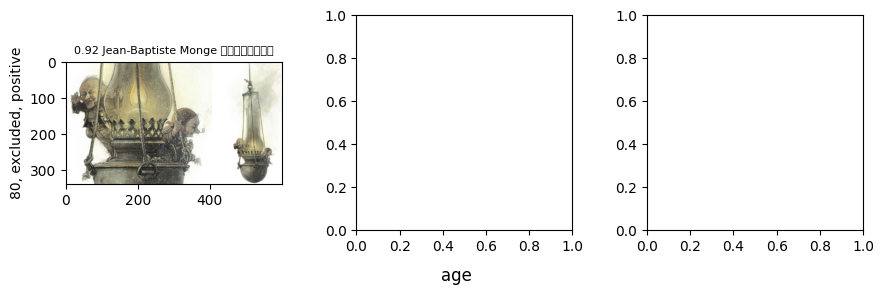

negative
0
positive
0
negative
0
positive
0
negative
0
age_gender
negative
0
neutral
0
positive
6


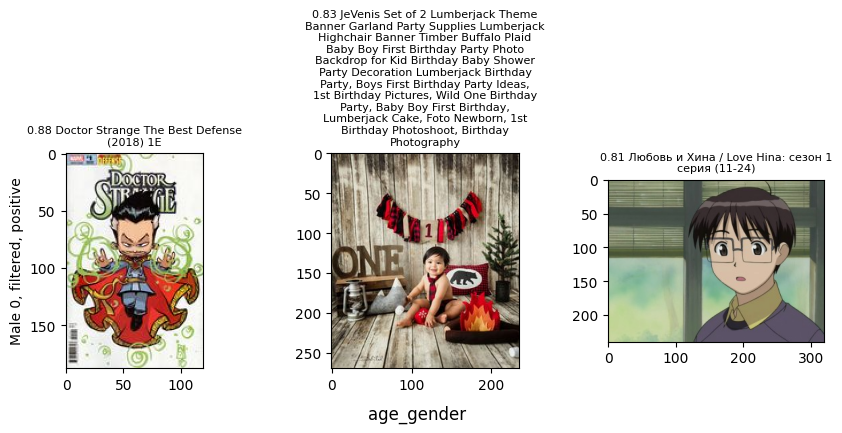

negative
0
positive
2


/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12497 (\N{KATAKANA LETTER PA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12392 (\N{HIRAGANA LETTER TO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12450 (\N{KATAKANA LETTER A}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12508 (\N{KATAKANA LETTER BO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12365 

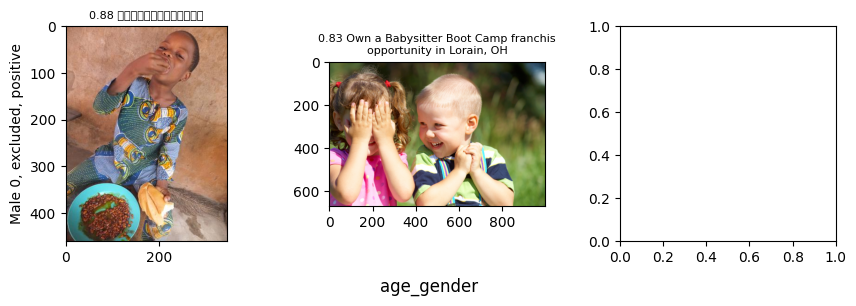

neutral
0
positive
4


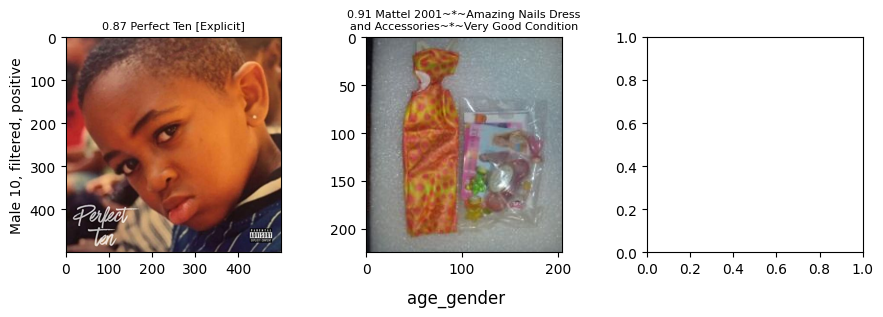

negative
0
neutral
0
negative
2


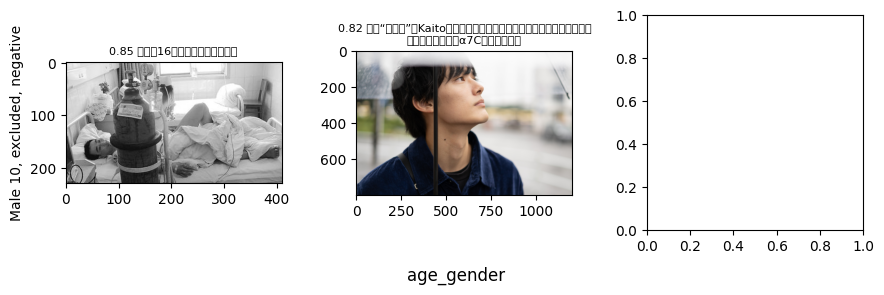

positive
13


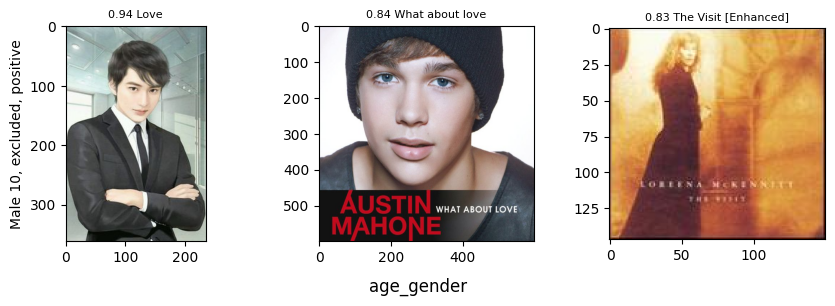

neutral
0
positive
20


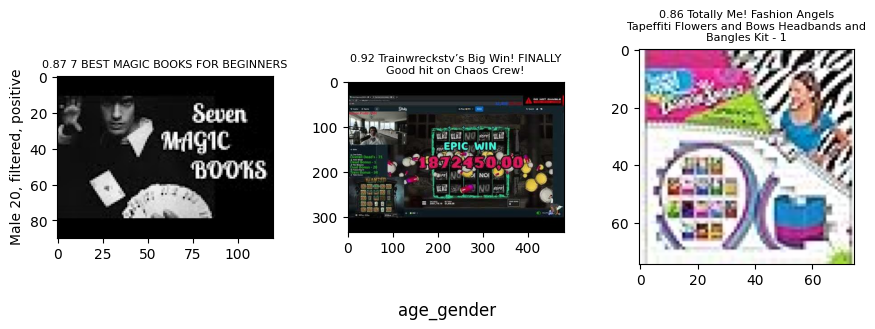

negative
1


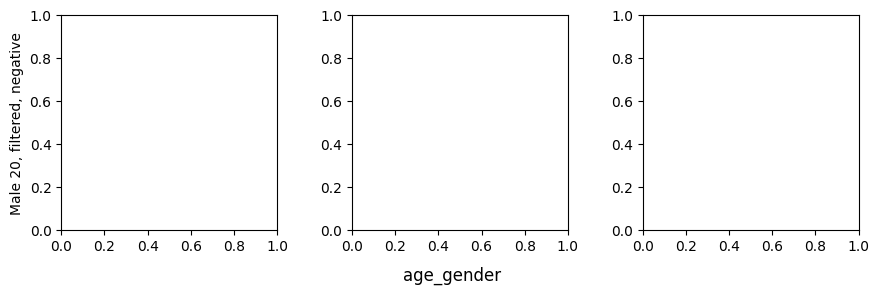

neutral
0
positive
44


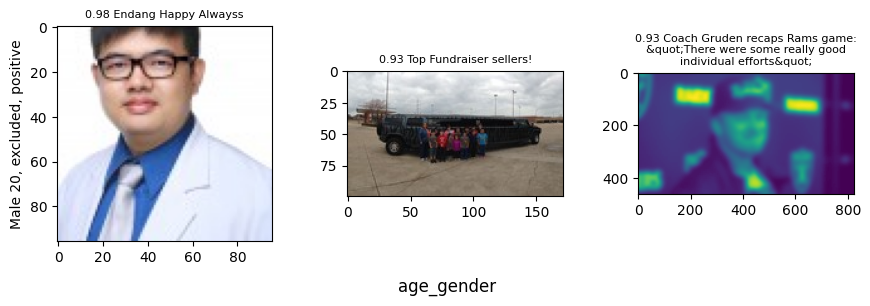

negative
3


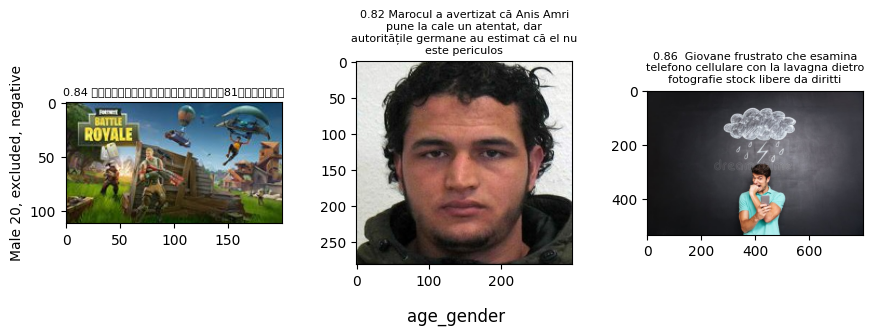

neutral
0
positive
18


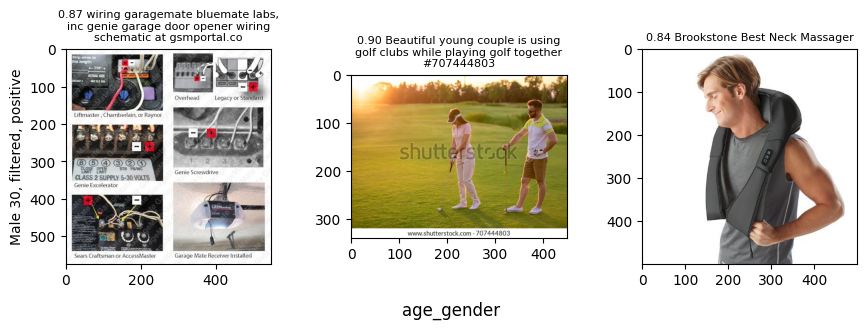

negative
1


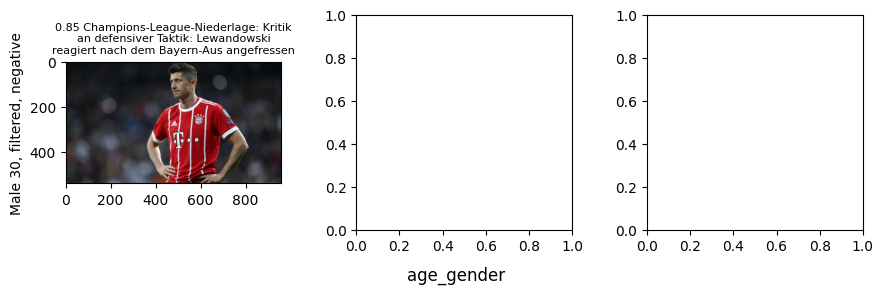

neutral
0
positive
33


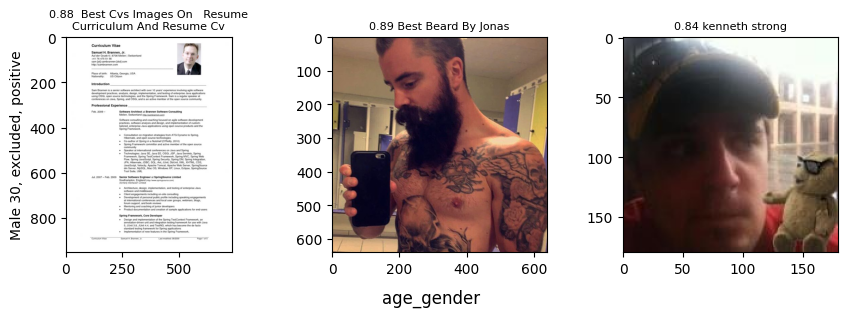

negative
4


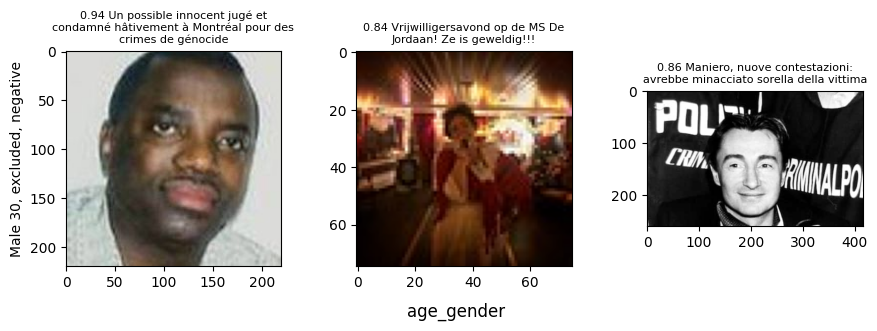

neutral
0
positive
11


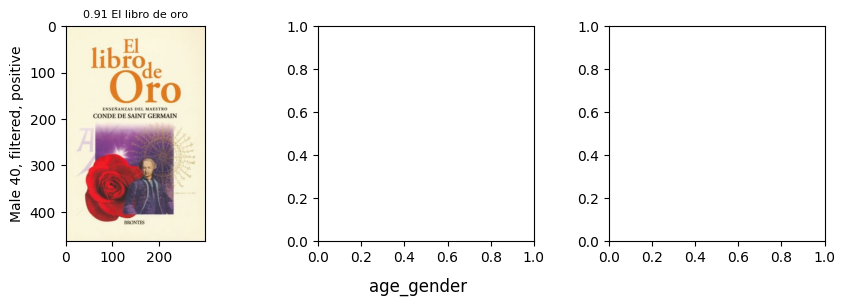

negative
0
neutral
0
positive
24


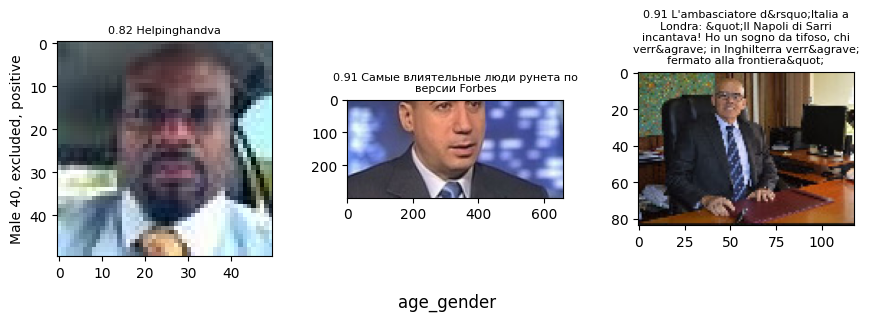

negative
6


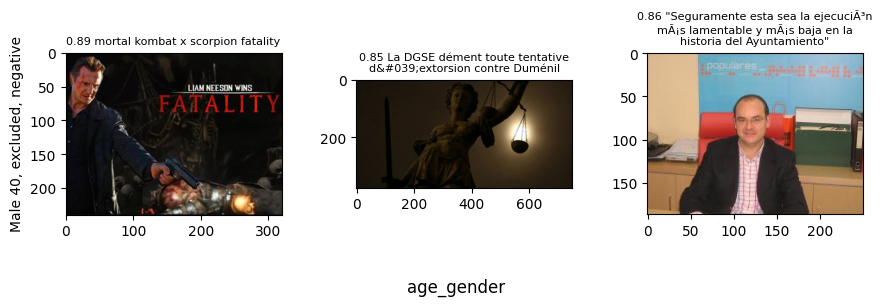

neutral
0
positive
17


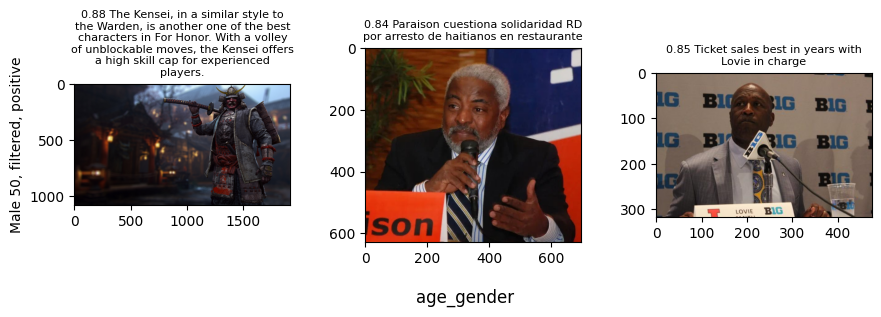

negative
1


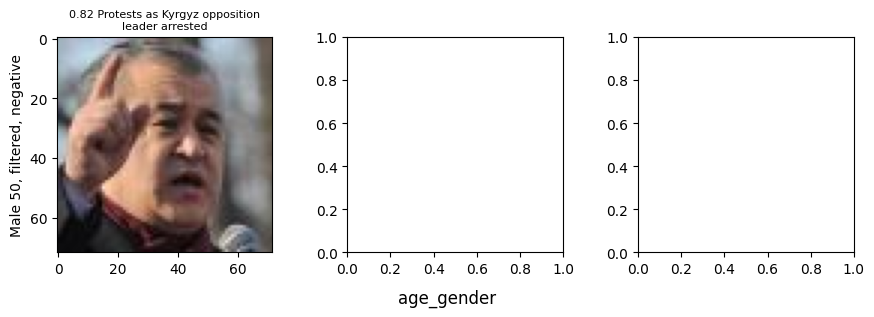

positive
15


/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 36817 (\N{CJK UNIFIED IDEOGRAPH-8FD1}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 20301 (\N{CJK UNIFIED IDEOGRAPH-4F4D}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 38395 (\N{CJK UNIFIED IDEOGRAPH-95FB}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 20256 (\N{CJK UNIFIED IDEOGRAPH-4F20}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.

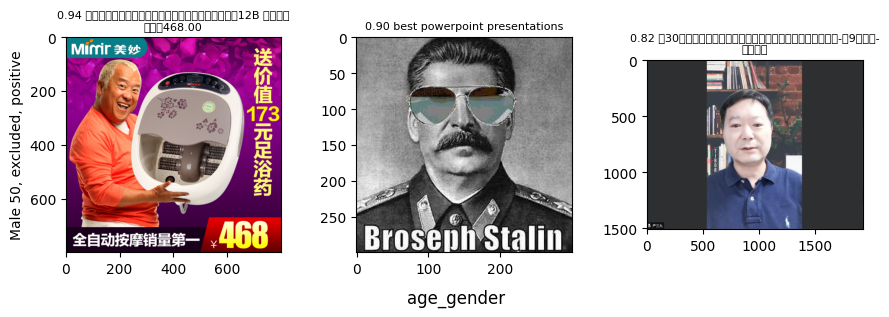

negative
3


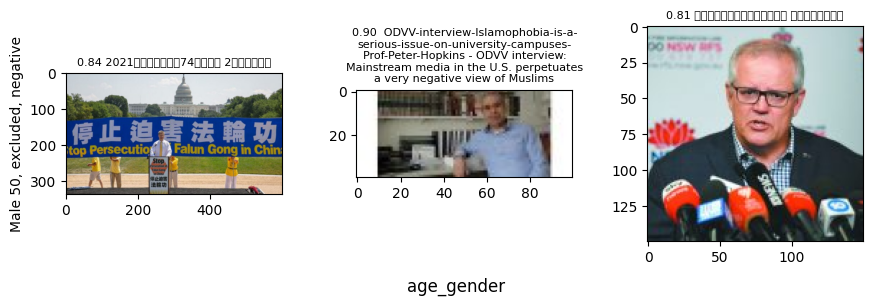

neutral
0
positive
6


/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 27599 (\N{CJK UNIFIED IDEOGRAPH-6BCF}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 26376 (\N{CJK UNIFIED IDEOGRAPH-6708}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 26360 (\N{CJK UNIFIED IDEOGRAPH-66F8}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 31934 (\N{CJK UNIFIED IDEOGRAPH-7CBE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.

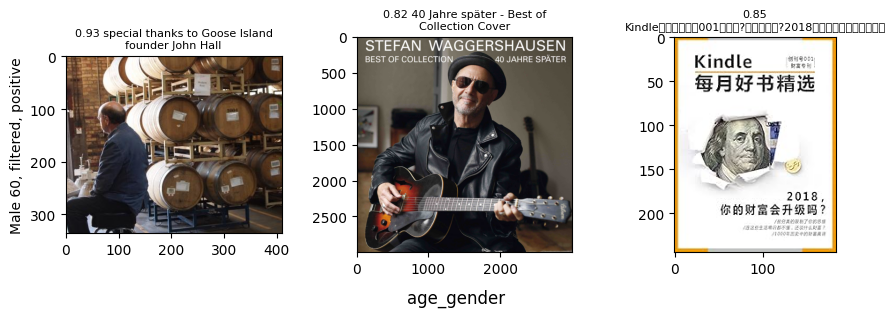

negative
1


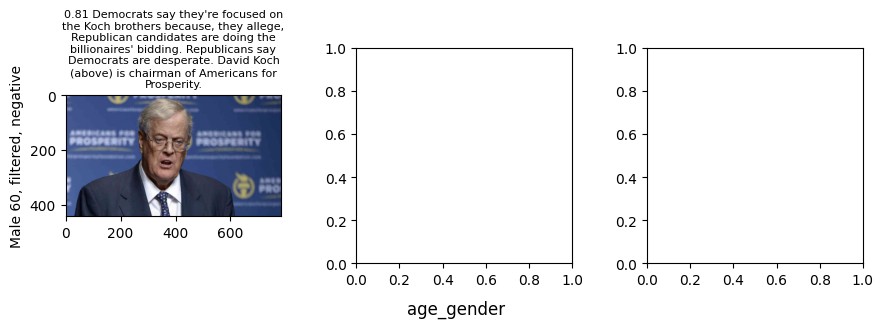

neutral
0
positive
7


/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 29233 (\N{CJK UNIFIED IDEOGRAPH-7231}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 26827 (\N{CJK UNIFIED IDEOGRAPH-68CB}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 29260 (\N{CJK UNIFIED IDEOGRAPH-724C}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


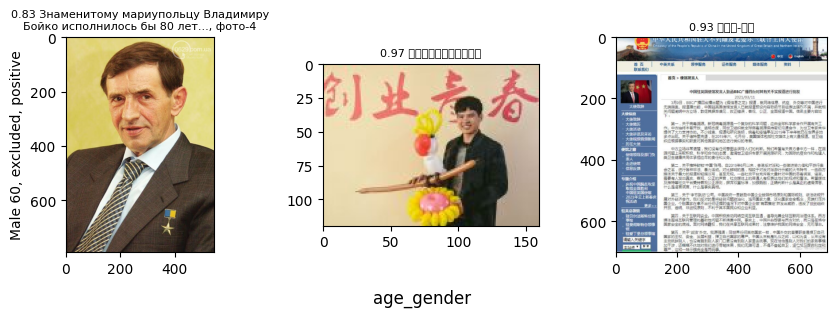

negative
1


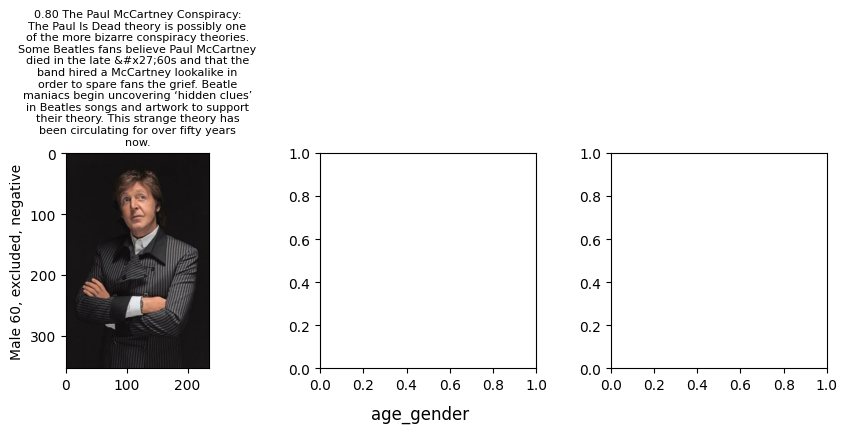

neutral
0
positive
1


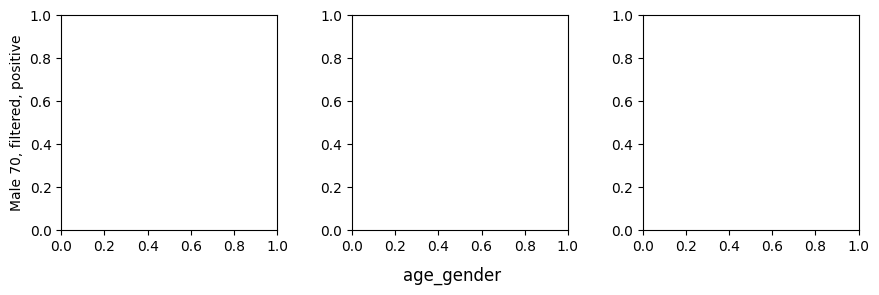

negative
0
positive
0
neutral
0
negative
0
positive
0
negative
0
positive
0
negative
0
positive
0
negative
0
positive
0
negative
0
positive
8


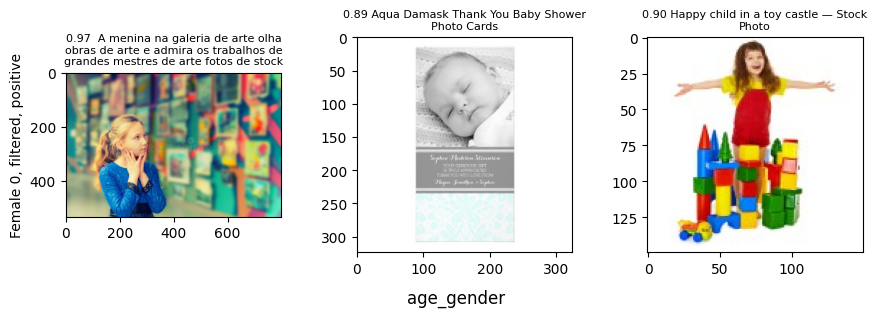

negative
0
neutral
0
positive
17


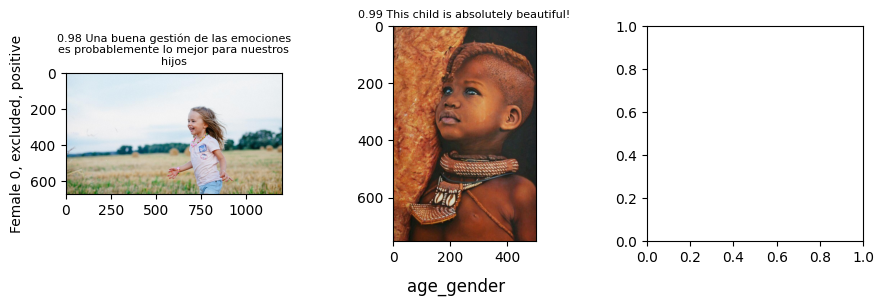

neutral
0
negative
1


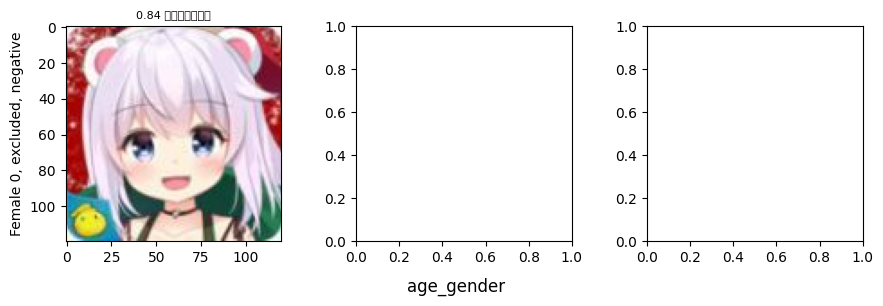

positive
18


/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12519 (\N{KATAKANA LETTER SMALL YO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 20882 (\N{CJK UNIFIED IDEOGRAPH-5192}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 38522 (\N{CJK UNIFIED IDEOGRAPH-967A}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12288 (\N{IDEOGRAPHIC SPACE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: Use

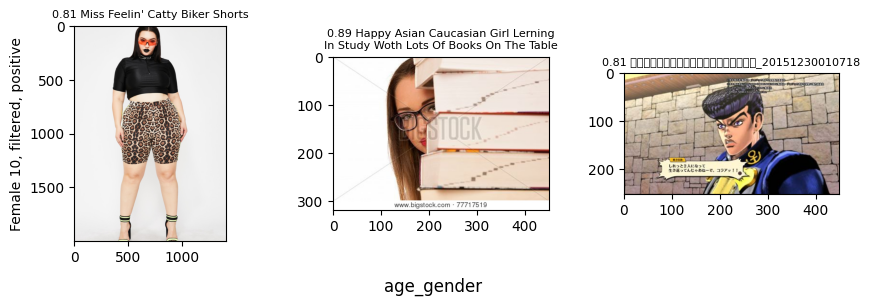

negative
1


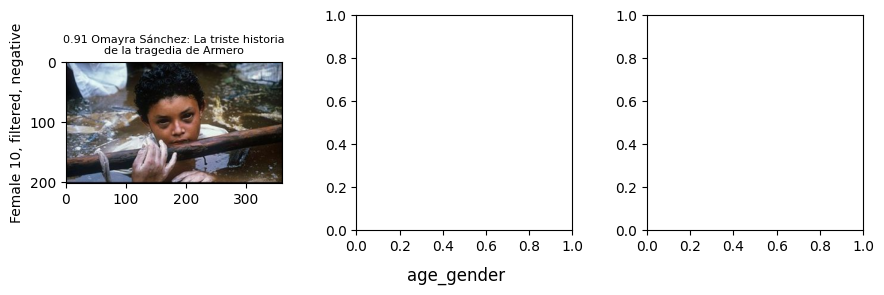

positive
36


/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 26377 (\N{CJK UNIFIED IDEOGRAPH-6709}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 39068 (\N{CJK UNIFIED IDEOGRAPH-989C}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 20219 (\N{CJK UNIFIED IDEOGRAPH-4EFB}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 24615 (\N{CJK UNIFIED IDEOGRAPH-6027}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.

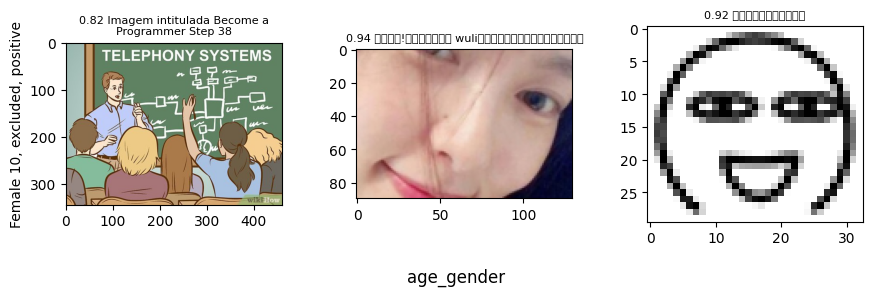

negative
5


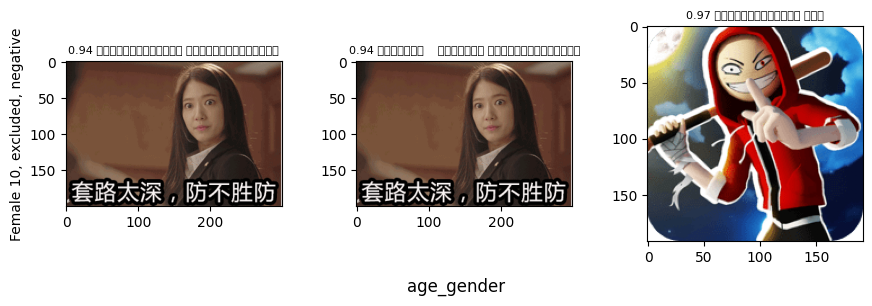

neutral
0
positive
26


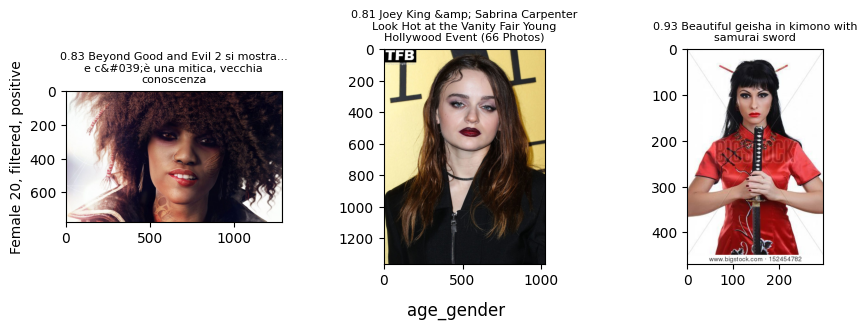

negative
1


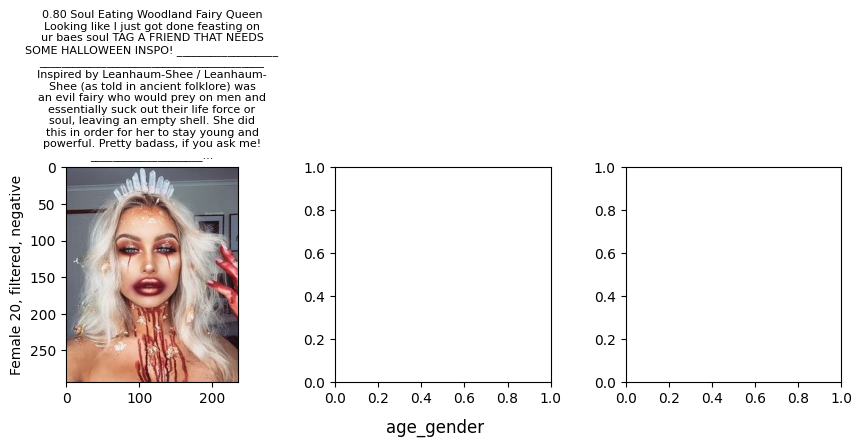

neutral
0
positive
32


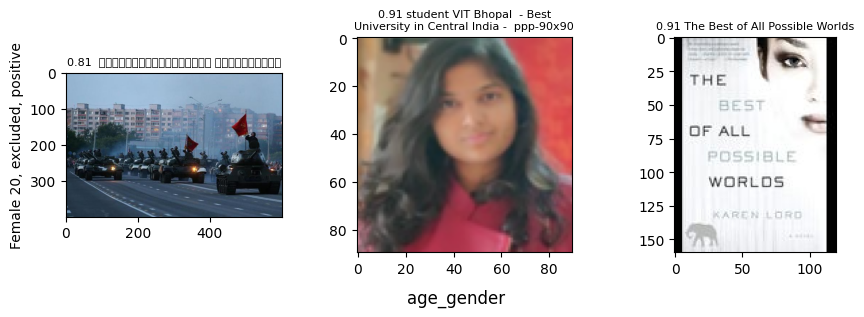

negative
3


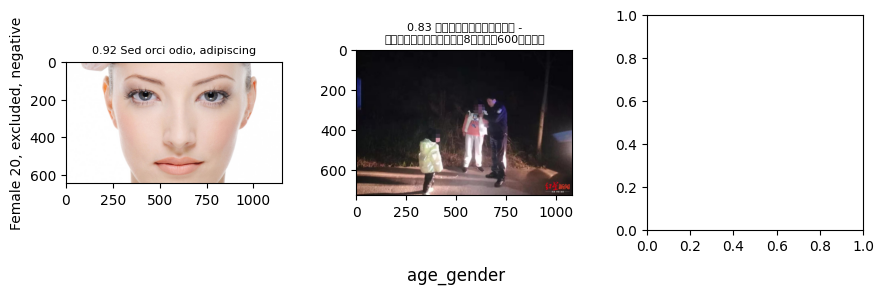

neutral
0
positive
11


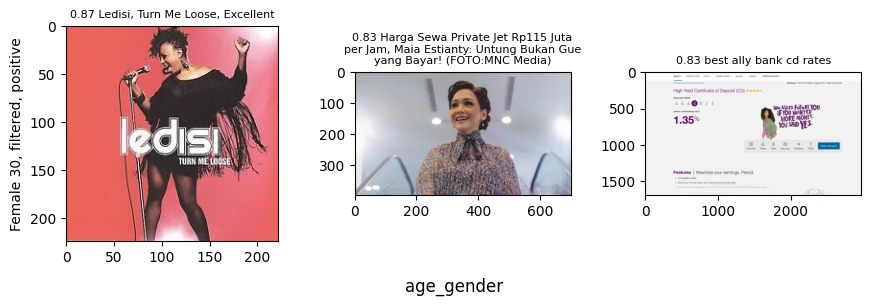

negative
2


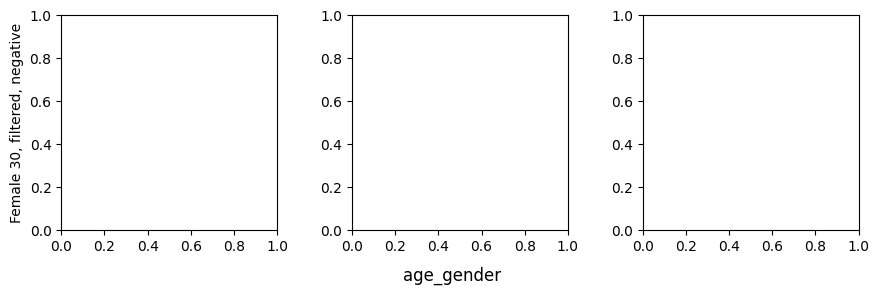

positive
20


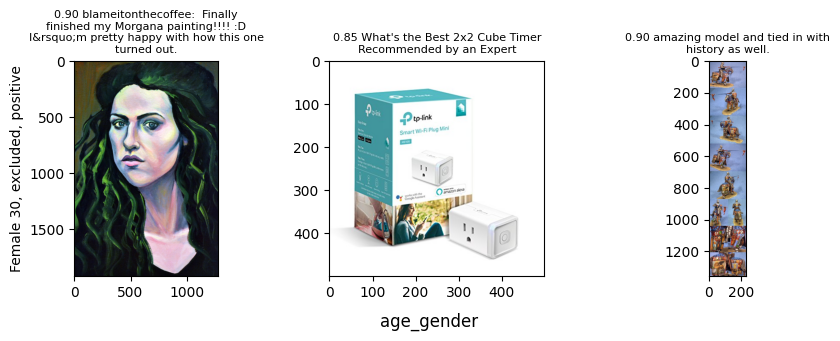

negative
0
neutral
0
positive
6


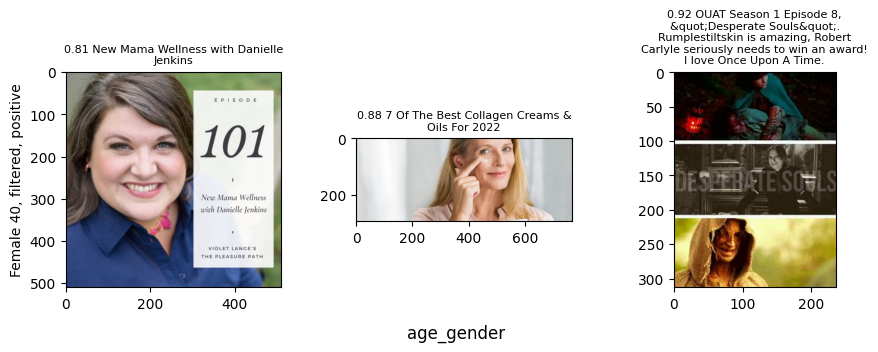

negative
0
positive
10


/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 22799 (\N{CJK UNIFIED IDEOGRAPH-590F}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 30495 (\N{CJK UNIFIED IDEOGRAPH-771F}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 30427 (\N{CJK UNIFIED IDEOGRAPH-76DB}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12426 (\N{HIRAGANA LETTER RI}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


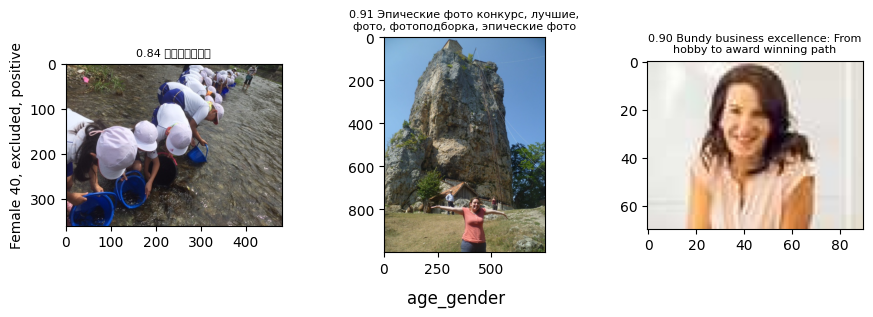

negative
0
neutral
0
positive
4


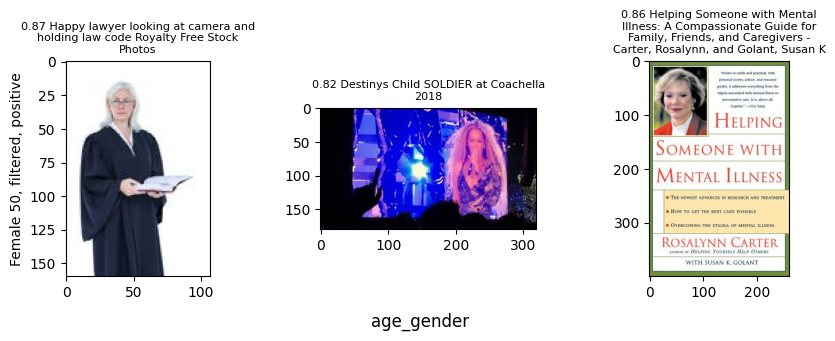

negative
0
neutral
0
negative
0
positive
9


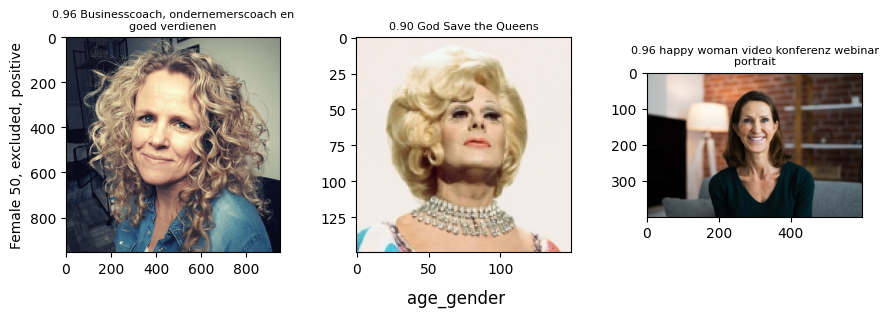

positive
1


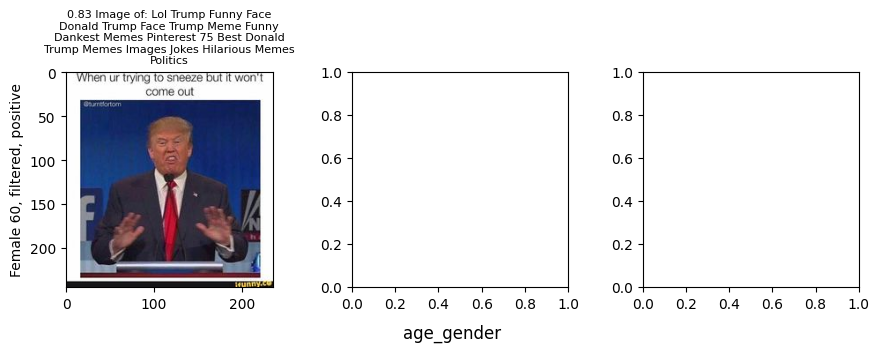

negative
0
positive
1


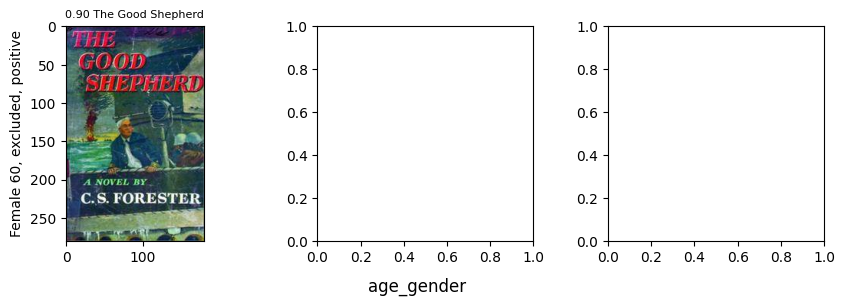

neutral
0
negative
0
positive
2


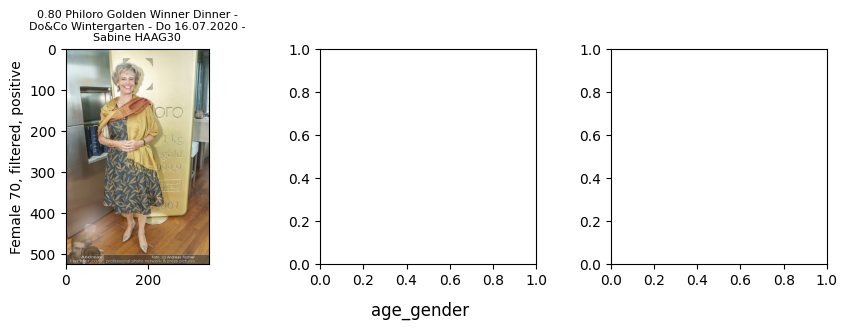

negative
0
positive
0
negative
0
negative
0
positive
0
positive
1


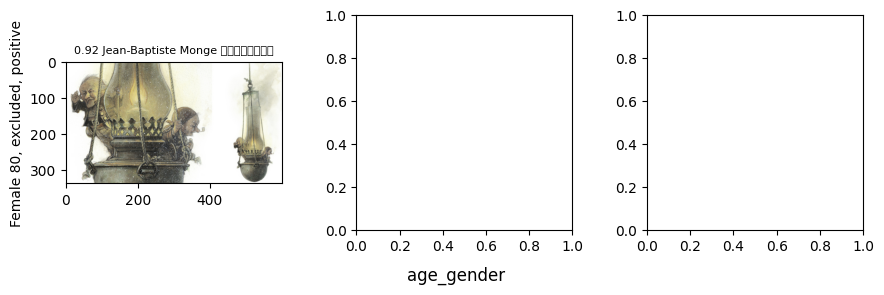

negative
0
positive
0
positive
0
negative
0


In [682]:
THRESHOLD = 0.8
for demo in demo_to_sentiment_dict:
    print(demo)
    g_to_sentiment_dict = demo_to_sentiment_dict[demo]
    
    for g in g_to_sentiment_dict:
        for d in g_to_sentiment_dict[g]:
            for s in g_to_sentiment_dict[g][d]:
                print(s)
                uid_scores = g_to_sentiment_dict[g][d][s]
                conf_uid_scores_dict = {uid: score for (uid, score) in uid_scores if score >= THRESHOLD}
                conf_rows = df.loc[df['uid'].isin(conf_uid_scores_dict.keys())]
                print(len(conf_rows))
                if len(conf_rows) >= 1:
                    display_sentiment_sample(
                        conf_rows,
                        score_dict=conf_uid_scores_dict,
                        ylabel=f'%s, %s, %s' % (g, d, s),
                        title=demo,
                        NUM_SAMPLE=3, NUM_COL=3
                    )
#                     raise Exception

In [683]:
sentiment_pipeline(["brad paisley - this is country music"])[0]

{'label': 'positive', 'score': 0.8334188461303711}

## Readability

In [894]:
pattern = re.compile(r'[^A-Za-z ]+')

def clean_caption(caption, as_set=False):
    # only return unique words in caption
    cleaned_caption = pattern.sub('', caption.lower())
    if as_set:
        return set(cleaned_caption.split(' '))
    else:
        return cleaned_caption

def get_vocab_score(caption):
    cleaned_caption = clean_caption(caption)
    if caption.strip() != '':
        lang = detect(caption)
        if lang == 'en':
            return textstat.flesch_reading_ease(caption)
    return None

def get_vocab_of_captions(filtered_uids, excluded_uids, NUM_SAMPLE=1000):
    sample_filtered_uids = random.sample(list(filtered_uids), NUM_SAMPLE)
    sample_excluded_uids = random.sample(list(excluded_uids), NUM_SAMPLE)
    
    sample_uids = {
        'filtered': sample_filtered_uids,
        'excluded': sample_excluded_uids
    }
    sample_captions = {
        k: get_captions(sample_uids[k], as_dict=True) for k in sample_uids
    }
    
    vocab_dict = {'filtered': [], 'excluded': []}
    for k in sample_captions:
        print(k)
        captions = sample_captions[k]
        for uid, c in captions.items():
            try:
                score = get_vocab_score(c)
                if score is not None:
                    vocab_dict[k].append((uid, score))
            except Exception as e:
#                 pass
                print("ERROR", c, e)
    
#     min_n = min([len(vocab_dict[k]) for k in vocab_dict])
    
    return vocab_dict
    # return {k: random.sample(vocab_dict[k], NUM_SAMPLE) for k in vocab_dict}

In [895]:
demo_to_vocab_dict = {}
NUM_SAMPLE = 100

for demo in combined_count:
    demo_to_vocab_dict[demo] = {}
    
    demo_count = combined_count[demo]
    for g in demo_count:
        print(g)
        g_filtered_uids = set(demo_count[g]['filtered'])
        g_total_uids = set(demo_count[g]['total'])
        g_excluded_uids = g_total_uids.difference(g_filtered_uids)
        num = min(len(g_filtered_uids), len(g_excluded_uids))
        if num >= NUM_SAMPLE: 
            demo_to_vocab_dict[demo][g] = get_vocab_of_captions(
                g_filtered_uids, g_excluded_uids, NUM_SAMPLE=NUM_SAMPLE
            )

Male
filtered
excluded
ERROR &#1583;&#1575;&#1606;&#1604;&#1608;&#1583; &#1570;&#1607;&#1606;&#1711; &#1605;&#1575;&#1607;&#1575;&#1606; &#1576;&#1607;&#1585;&#1575;&#1605; &#1582;&#1575;&#1606; &#1593;&#1588;&#1602;&#1607; No features in text.
ERROR 6 No features in text.
Female
filtered
excluded
ERROR . 1994 No features in text.
0
filtered
ERROR https://imageserve.babycenter.com/25/000/398/tPg1OxkJdhVNv3CQPCFQ834mB6hvoC9R No features in text.
excluded
ERROR 081102_0026~01 No features in text.
ERROR 23 No features in text.
ERROR &#21830;&#21697;&#12398;&#35443;&#32048; No features in text.
10
filtered
excluded
20
filtered
excluded
ERROR 24 No features in text.
ERROR * No features in text.
30
filtered
ERROR https://a.espncdn.com/i/headshots/college-football/players/full/4259305.png No features in text.
excluded
ERROR 0 No features in text.
ERROR 1 (1) No features in text.
ERROR 011 No features in text.
40
filtered
excluded
50
filtered
excluded
60
filtered
excluded
ERROR 3 No features i

In [896]:
for demo in demo_to_vocab_dict:
    for k in demo_to_vocab_dict[demo]:
        for d in demo_to_vocab_dict[demo][k]:
            n = len(demo_to_vocab_dict[demo][k][d])
            print(demo, k, d, n)

gender Male filtered 53
gender Male excluded 26
gender Female filtered 56
gender Female excluded 20
age 0 filtered 60
age 0 excluded 28
age 10 filtered 58
age 10 excluded 23
age 20 filtered 53
age 20 excluded 25
age 30 filtered 61
age 30 excluded 33
age 40 filtered 52
age 40 excluded 29
age 50 filtered 50
age 50 excluded 29
age 60 filtered 49
age 60 excluded 22
age_gender Male 10 filtered 57
age_gender Male 10 excluded 18
age_gender Male 20 filtered 62
age_gender Male 20 excluded 24
age_gender Male 30 filtered 59
age_gender Male 30 excluded 28
age_gender Male 40 filtered 53
age_gender Male 40 excluded 26
age_gender Male 50 filtered 53
age_gender Male 50 excluded 24
age_gender Male 60 filtered 53
age_gender Male 60 excluded 22
age_gender Female 0 filtered 56
age_gender Female 0 excluded 17
age_gender Female 10 filtered 58
age_gender Female 10 excluded 15
age_gender Female 20 filtered 57
age_gender Female 20 excluded 29
age_gender Female 30 filtered 59
age_gender Female 30 excluded 26


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


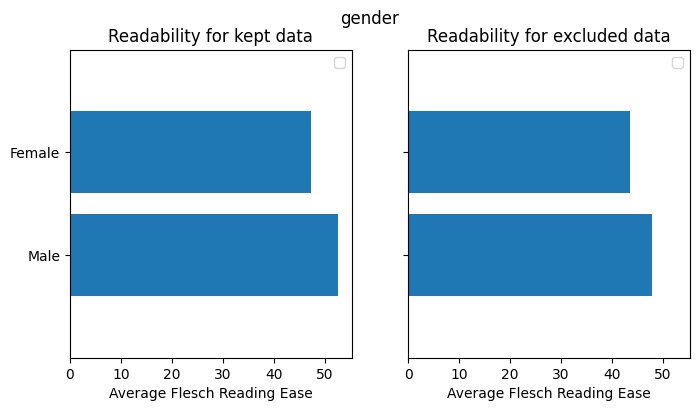

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


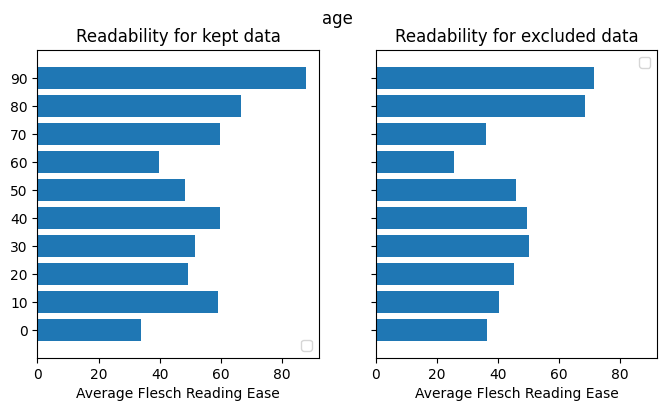

/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


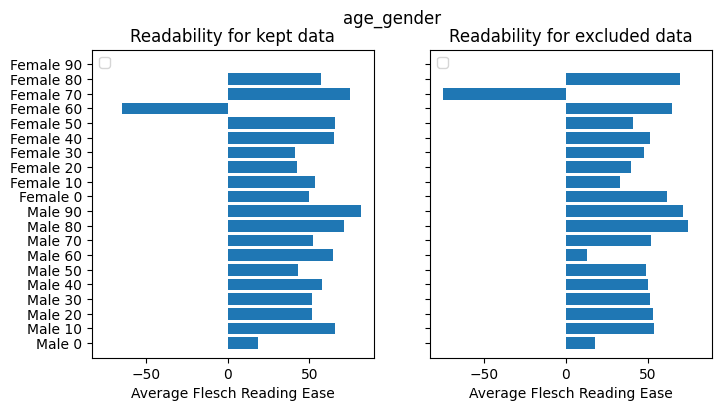

In [788]:
# A = [np.average(keyword_to_vocab_dict[k]['filtered']) for k in keyword_to_vocab_dict]
DATA_TYPES = ['filtered', 'excluded']
for demo in demo_to_vocab_dict:
    fig, axes = plt.subplots(1, 2, figsize=(8, 4), sharex=True, sharey=True)
        
    g_to_vocab_dict = demo_to_vocab_dict[demo]

    for i_d, d in enumerate(DATA_TYPES):
        ax = axes[i_d]
        Y = [np.average([v[1] for v in g_to_vocab_dict[g][d]]) for g in g_to_vocab_dict]
        X = [str(g) for g in g_to_vocab_dict]

        # plot the bars
        ax.barh(X, np.asarray(Y))
        ax.legend()
        ax.set_title("Readability for " + ('kept' if d == 'filtered' else 'excluded') + " data")
        ax.set_xlabel('Average Flesch Reading Ease')
        ax.set_ylim(-1,len(X))

    plt.suptitle(demo)
#     plt.xlim(-5, 20)
    plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


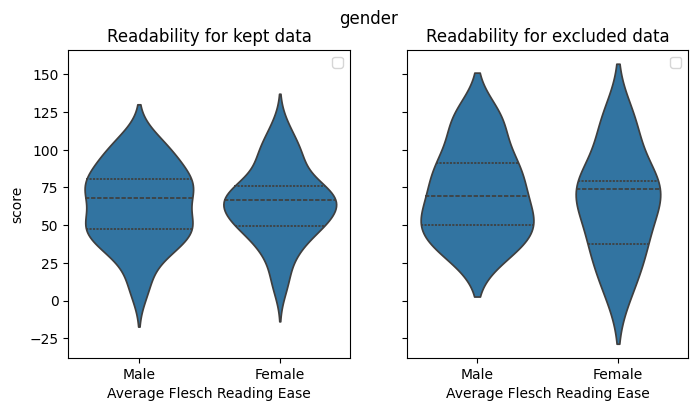

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


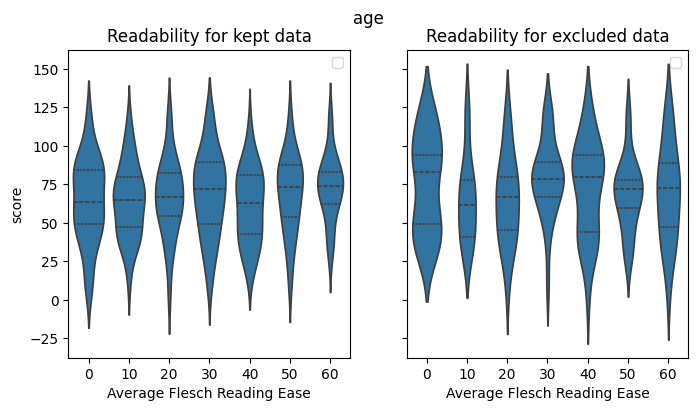

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


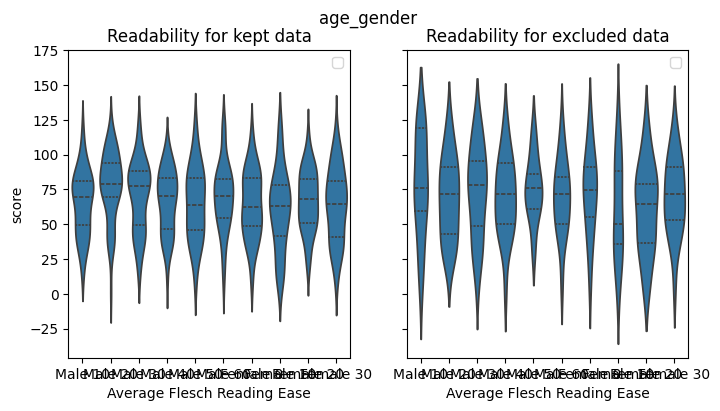

In [898]:
# A = [np.average(keyword_to_vocab_dict[k]['filtered']) for k in keyword_to_vocab_dict]
DATA_TYPES = ['filtered', 'excluded']
for demo in demo_to_vocab_dict:
    fig, axes = plt.subplots(1, 2, figsize=(8, 4), sharex=True, sharey=True)
        
    g_to_vocab_dict = demo_to_vocab_dict[demo]

    for i_d, d in enumerate(DATA_TYPES):
        ax = axes[i_d]
        readability_df_dict = defaultdict(list)
        
        for g in g_to_vocab_dict:
            for (_, score) in g_to_vocab_dict[g][d]:
                if score > 0:
                    readability_df_dict['group'].append(g)
                    readability_df_dict['score'].append(score)
                
        readability_df = pd.DataFrame.from_dict(readability_df_dict)
        sns.violinplot(
            data=readability_df,
            x="group", y="score", 
            inner="quart", ax=ax,
            density_norm='count'
        )
        
        ax.legend()
        ax.set_title("Readability for " + ('kept' if d == 'filtered' else 'excluded') + " data")
        ax.set_xlabel('Average Flesch Reading Ease')

    plt.suptitle(demo)
    plt.show()

### View sample readability scores

In [453]:
def display_readability_sample(sample, score_dict=None, title='', NUM_SAMPLE=20, NUM_COL=5):
    resample = sample.sample(2 * NUM_SAMPLE) if len(sample) >= 2 * NUM_SAMPLE else sample
    NUM_ROW = NUM_SAMPLE // NUM_COL
    
    fig, axes = plt.subplots(NUM_ROW, NUM_COL, figsize=(9,3))
    fig.tight_layout(pad=2.0)

    i = 0
    for _, row in resample.iterrows():
        if i >= NUM_SAMPLE:
            break

        ax = axes[i % NUM_COL] # axes[i // NUM_COL][i % NUM_COL]
        caption = f'%.2f ' % score_dict[row['uid']] + row['text']
        uid = row['uid']
        url = row['url']
        ext = url.split('.')[-1]
        image_path = os.path.join(sample_image_dir, uid + '.' + ext)

        try:
            download_url(url, image_path, caption, ax)
#             print(url)
            i += 1
        except:
            pass
    
    axes[0].set_ylabel(title)
    plt.show()

In [ ]:
LOW = 0
HIGH = 100
for k in keyword_to_vocab_dict:
    for d in keyword_to_vocab_dict[k]:
        uid_scores = keyword_to_vocab_dict[k][d]
        conf_uid_scores_dict = {uid: score for (uid, score) in uid_scores if score >= HIGH}
        conf_rows = df.loc[df['uid'].isin(conf_uid_scores_dict.keys())]
        print(len(conf_rows))
        display_readability_sample(
            conf_rows,
            score_dict=conf_uid_scores_dict,
            title=f'%s, %s, %s high' % (k, d, s),
            NUM_SAMPLE=3, NUM_COL=3
        )
        
        conf_uid_scores_dict = {uid: score for (uid, score) in uid_scores if score <= LOW}
        conf_rows = df.loc[df['uid'].isin(conf_uid_scores_dict.keys())]
        print(len(conf_rows))
        display_readability_sample(
            conf_rows,
            score_dict=conf_uid_scores_dict,
            title=f'%s, %s, %s low' % (k, d, s),
            NUM_SAMPLE=3, NUM_COL=3
        )

# Search for keywords

In [ ]:
identity_keywords_dict = {
    'gender': [
        r'\bwom[ae]n\b',
        r'\bfemales?\b',
        r'\bm[ae]n\b',
        r'\bmales?\b',
        r'\bgirls?\b',
        r'\bboys?\b',
        
        r'\bnon[ -]?binary\b',
        r'\btrans(|\+|gender)\b',
        
        r'\b(she|her|hers)\b',
        r'\b(he|him|his)\b',
        r'\b(they|them|theirs)\b',
    ],
    'sexual_orientation': [
        r'\bhomosexuals?\b',
        r'\bgays?\b',
        r'\blesbians?\b',
        r'\bstraights?\b',
        r'\bheterosexuals?\b',
        r'\bbi-?sexuals?\b',
    ],
    'race': [
#         r'\bblacks?\b',
        r'\bafrican([ -]american)?s?\b',
        r'\blatin[oax]?s?\b',
        r'\basian([ -]american)?s?\b',
#         r'\bwhites?\b',
        r'\bcaucasians?\b',
        r'\beuropean([ -]american)?s?\b',
    ],
    'religion': [
        r'\bmuslims?\b',
        r'\bjew(|s|ish)?\b',
        r'\bchristians?\b',
    ]   
}

demographics = list(identity_keywords_dict.keys())

identity_keywords = []
for d in identity_keywords_dict:
    for keyword in identity_keywords_dict[d]:
        identity_keywords.append(keyword)
print(identity_keywords)

In [ ]:
def show_keyword_by_image_group(group_to_uid_dict, LABELS):
    for g in LABELS:
        g_uids = set(group_to_uid_dict[g]['total'])
        g_filter_uids = set(group_to_uid_dict[g]['filtered'])
        g_df = results_df.loc[results_df['uid'].isin(g_uids)]

        print(g)

        count_dict = {}
        for keyword in identity_keywords:
            keyword_df = g_df[g_df['text'].str.contains(keyword, na=False, case=False)]
            keyword_n = len(keyword_df)
            if keyword_n > 5:
                keyword_filter_df = keyword_df.loc[keyword_df['uid'].isin(g_filter_uids)]
                keyword_filter_n = len(keyword_filter_df)
                count_dict[keyword] = (keyword_filter_n, keyword_n)

        x = [k[2:-2] for k in count_dict]
        raw_nums = [count_dict[k][1] for k in count_dict]
        ratios = [count_dict[k][0] / count_dict[k][1] for k in count_dict]
        yerr = [get_error(count_dict[k][0], count_dict[k][1]) for k in count_dict]

        plot_df = pd.DataFrame({'keyword': x, 'ratio': ratios, 'raw_num': raw_nums, 'err': yerr})
        plot_df.sort_values('ratio').plot(kind='barh',y='ratio',x='keyword', xerr='err')
        plt.xlim(0, 1)
        plt.xlabel('percentage of raw dataset included in filtered dataset')
        plt.title('Identity keyword filter ratios by image group ' + str(g))
        plt.show()

        plot_df.sort_values('ratio').plot(kind='barh',y='raw_num',x='keyword', xerr='err')
        plt.xlabel('Number in raw dataset')
        plt.show()

In [ ]:
show_keyword_by_image_group(gender_count, GENDER_LABELS)

In [ ]:
show_keyword_by_image_group(age_count, AGE_LABELS)

# Display samples

In [701]:
NUM_SAMPLE = 25
NUM_COL = 5
NUM_ROW = NUM_SAMPLE // NUM_COL

def display_sample(sample, bounding_box=False):
    resample = sample.sample(NUM_SAMPLE)
    
    fig, axes = plt.subplots(NUM_ROW, NUM_COL, figsize=(15,3 * NUM_ROW))
    fig.tight_layout(pad=2.0)

    i = 0
    for i_loc, row in resample.iterrows():
        if i >= NUM_SAMPLE:
            break

        try:
            img = get_image(row)
            caption = row['text']
#             print(caption)
            
            ax = axes[i // NUM_COL][i % NUM_COL]
            if bounding_box:
                _ = process_age_gender_of_row(row, show=True, dest_ax=ax)
            else:
                ax.imshow(img[:,:,::-1])

            ax.set_title("\n".join(wrap(caption, 60)) + ', ' + str(i_loc), fontsize=8)
            i += 1
        except Exception as e:
            print("ERROR", e)
            i += 1
            pass
            
    plt.show()

/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 21109 (\N{CJK UNIFIED IDEOGRAPH-5275}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 20316 (\N{CJK UNIFIED IDEOGRAPH-4F5C}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 32773 (\N{CJK UNIFIED IDEOGRAPH-8005}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 30340 (\N{CJK UNIFIED IDEOGRAPH-7684}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.

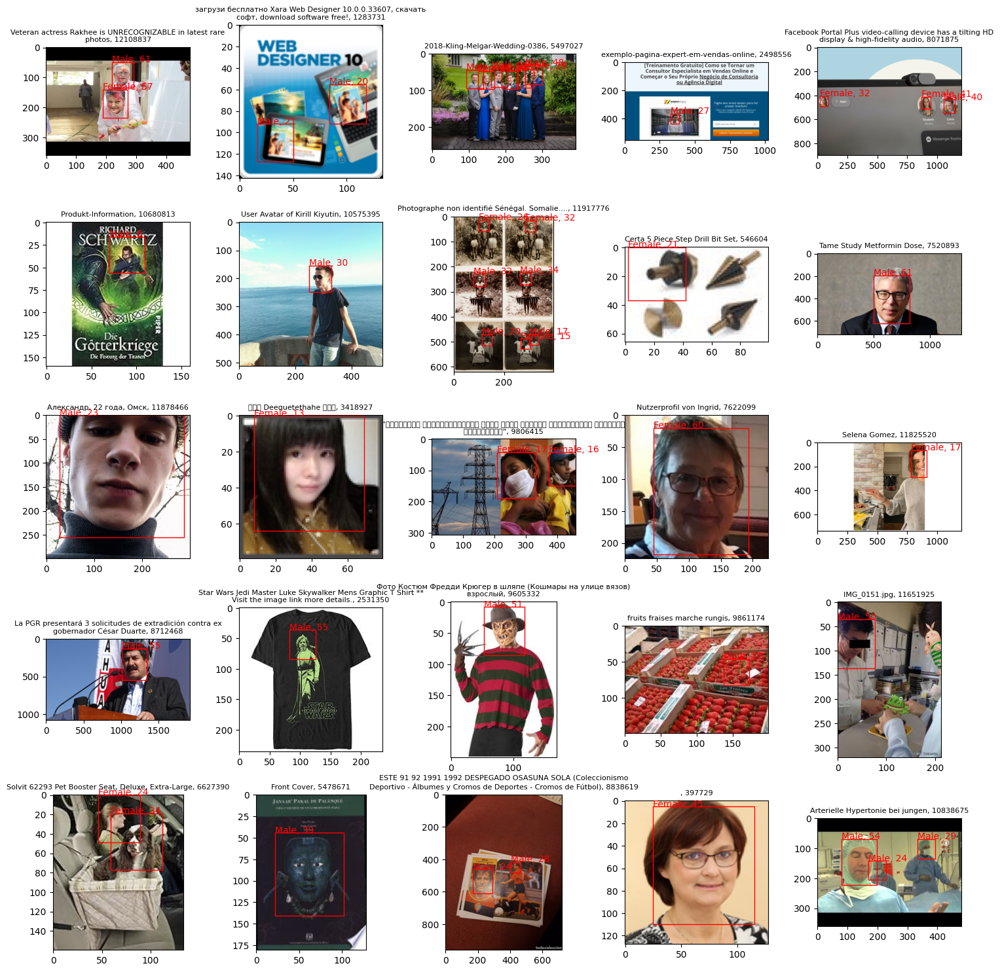

In [702]:
display_sample(results_df, bounding_box=True)

In [ ]:
filtered_male_uids = set(gender_count['Male']['filtered'])
filtered_male_rows = results_df.loc[results_df['uid'].isin(filtered_male_uids)]
display_sample(filtered_male_rows, bounding_box=True)

In [ ]:
excluded_male_uids = set(gender_count['Male']['total']).difference(set(gender_count['Male']['filtered']))
excluded_male_rows = results_df.loc[results_df['uid'].isin(excluded_male_uids)]
display_sample(excluded_male_rows, bounding_box=True)

In [ ]:
filtered_female_uids = set(gender_count['Female']['filtered'])
filtered_female_rows = results_df.loc[results_df['uid'].isin(filtered_female_uids)]
display_sample(filtered_female_rows, bounding_box=True)

In [ ]:
excluded_female_uids = set(gender_count['Female']['total']).difference(set(gender_count['Female']['filtered']))
excluded_female_rows = results_df.loc[results_df['uid'].isin(excluded_female_uids)]
display_sample(excluded_female_rows, bounding_box=True)

In [ ]:
age10_uids = set(age_count[0]['total'])
age10_rows = results_df.loc[results_df['uid'].isin(age10_uids)]
display_sample(age10_rows, bounding_box=True)

## Vs DataComp's face detection model and OpenCV

Findings: face detection + opencv is bad

In [705]:
results_df

,uid,url,text,original_width,original_height,clip_b32_similarity_score,clip_l14_similarity_score,face_bboxes,sha256
512,36cdbfdbb0242dea9f35d8e8ba244034,https://pixhost.icu/avaxhome/a6/27/007e27a6_me...,Le Courrier de l'Ouest Angers – 22 novembre 2020,217,300,0.283447,0.258301,"[[0.8724561929702759, 0.5759853720664978, 0.91...",a2cf4d99ceb01ced10c961aab951b7736e2b9f121c7e88...
741,ac54e51fb59c63f5a0f70c1f4861c073,https://worldofbuzz.com/wp-content/uploads/202...,"No More Verbal Warnings, Mco Phase 2 Will See ...",80,80,0.232178,0.239380,"[[0.0, 0.1678292453289032, 0.23773819208145142...",d9615e4fd8671794cfba0630737462364f5ac76b347251...
1467,8c3a175a53c7a2899a96ab163e9b0b38,https://www.intimateweddings.com/wp-content/up...,New Zealand mountain elopement,467,701,0.309814,0.291504,"[[0.5742679238319397, 0.485332190990448, 0.628...",912f9c7fee28bcbaf803256a3084bfc4c3c7f1eee85e36...
2903,679c52457e754058c79aa0ed53a1f9c2,https://bigjimny.com/media/kunena/avatars/resi...,Elikratos's Avatar,144,144,0.237427,0.134155,"[[0.5906437039375305, 0.09305974096059799, 0.6...",313da752d861e5e678ad2016184706021b09d3f0f7235b...
3466,7080884b0e5785035f25185394fa0488,https://s3.amazonaws.com/cms.ipressroom.com/36...,Researchers aim to understand COVID-19 in chil...,400,400,0.225952,0.139282,"[[0.12686803936958313, 0.1720641404390335, 0.1...",b7f8ab47edb90ea838295bfa9cefa0d45d64a34e758f70...
...,...,...,...,...,...,...,...,...,...
12796929,df62a980c1064ef037c436be8b8fa585,https://i.ytimg.com/vi/TirIvyvLjkY/0.jpg,Republicans CHEATING In Georgia,480,360,0.290283,0.263916,"[[0.20814579725265503, 0.36898717284202576, 0....",23aa87722b8d0f84840ce8ce280cb9d2200f082fa6bb8f...
12798008,4b178c30fc051300270d98116912c0fe,https://i.pinimg.com/216x146/f0/c3/87/f0c38715...,Culture,215,146,0.214600,0.181030,"[[0.39470165967941284, 0.0, 0.5665967464447021...",5754465eb66e5e255fc9e37e01a939baca810734b98551...
12798376,bf116df22a2827b3310e37396576cb70,http://lionsclubpoznanrotunda.org/wp-content/g...,Wigilia 2010,218,160,0.243652,0.141235,"[[0.5503153800964355, 0.014322477392852306, 0....",337814ff91db2e6b568570103fc4178c0554c428ff5ddb...
12798943,e2f047278fc517de7c7da42d3690d6fa,https://lb.jingoo.com/medium/66/14/2198895-273...,Photographe mariage - NICEWEATHER PHOTOGRAPHIE...,345,520,0.282715,0.258057,"[[0.2776043713092804, 0.14536504447460175, 0.5...",4440bedd6a4f5039cc70b0e844152445bcef452ec3bb92...


In [697]:
# 1463/18806 = 7.78% of rekognition-detected face samples datacomp's face detection model didn't detect
results_df[results_df['face_bboxes'].str.len() == 0]

,uid,url,text,original_width,original_height,clip_b32_similarity_score,clip_l14_similarity_score,face_bboxes,sha256
31409,08b9e7cac19fe57e1a96f7dc4c87bb25,https://images.squarespace-cdn.com/content/v1/...,IMG_2577(1).JPG,1856,2784,0.198486,0.096924,[],4e80da0c175e92265907257b4b0b62e602340816ef89fd...
40594,eb9d58156902b53b95cb6f718265cab7,http://n.sinaimg.cn/news/1_img/dfic/6d34f853/1...,雄大で英雄的相关词 前貴之 | ゲキサカ{:ChengYu}图片,950,632,0.199829,0.116638,[],783eeeb66e8c499e51087c181d811280fb80d20cf0768e...
74321,41aa5a9c4c34c48c0e0491b20c5d672e,http://www.bolod.mn/Upload/news/149439-0311201...,"АНУ, ОХУ, БНХАУ дайнд бэлтгэж байгаа гэж “The ...",825,464,0.204956,0.180298,[],0c263b4f9eb769bbe1d2b795add60b9c0b26c36cf4a94d...
94743,3959b701805c87f2a17afbbf4d8c6881,http://blog-imgs-29.fc2.com/s/t/u/studiorosso/...,IMG_0470.jpg,450,338,0.244385,0.149536,[],d475995a7a4e0444c81c1398017e87be274df6c36c914c...
97808,059cda3c040acc9661849d9e205970d6,https://i.etsystatic.com/5142864/c/1204/957/39...,Multi Spinel Necklace Silver Gemstone Statemen...,340,270,0.308594,0.324463,[],fd76dec7c7e5d0310ed17ec06eb5f35906d59f52eff628...
...,...,...,...,...,...,...,...,...,...
12746794,f15f4df565de96a3733c0ccc9b5dad88,https://media.tacdn.com/media/attractions-spli...,Molens van Kinderdijk,669,446,0.308838,0.237671,[],8cbb38537bc2629714d4e6a4f99044a6a53d4c73e4638f...
12772934,ff4144631229e90e484573269a914e54,http://animals-nn.ru/forum/uploads/profile/pho...,Ищу самца Chromatopelma cyaneopubescens. - las...,100,100,0.258301,0.105286,[],5a4e76c0f0ec9a2b2c4e96cdb56e68018c951a8077c30e...
12773862,58d4e7b2725e8355c14c9e42ebf5b8d7,http://www.lxgg365.com/uploads/allimg/20211020...,常州医用方舱,1722,968,0.224976,0.262695,[],3b9e9e020c7cb5e436f3b223d74c1f0c93f87a28e3560d...
12780279,6ae777fcf889f7c70f73967f6f1b14b6,https://sqool.net/wp-content/uploads/2015/11/a...,アリスの精神裁判 7 (21),282,500,0.267334,0.224976,[],fc33f1e59e8873b71c9a2c426e39717da84c1c5cf8c985...


In [698]:
base_uids = []
for filename in os.listdir(output_dir): # 100k given to rekognition
    uid = filename.split('.')[0]
    base_uids.append(uid)
base_uids_df = df.loc[df['uid'].isin(base_uids)]

In [699]:
# 25k images detected by datacomp face detection (out of 100k given to rekognition)
base_results_df = base_uids_df[base_uids_df['face_bboxes'].str.len() > 0]
base_results_df

,uid,url,text,original_width,original_height,clip_b32_similarity_score,clip_l14_similarity_score,face_bboxes,sha256
512,36cdbfdbb0242dea9f35d8e8ba244034,https://pixhost.icu/avaxhome/a6/27/007e27a6_me...,Le Courrier de l'Ouest Angers – 22 novembre 2020,217,300,0.283447,0.258301,"[[0.8724561929702759, 0.5759853720664978, 0.91...",a2cf4d99ceb01ced10c961aab951b7736e2b9f121c7e88...
741,ac54e51fb59c63f5a0f70c1f4861c073,https://worldofbuzz.com/wp-content/uploads/202...,"No More Verbal Warnings, Mco Phase 2 Will See ...",80,80,0.232178,0.239380,"[[0.0, 0.1678292453289032, 0.23773819208145142...",d9615e4fd8671794cfba0630737462364f5ac76b347251...
1005,c86660c32e22381c5cbfde54b8436d2b,https://sldstuber-plants.sg-creations.com/wp-c...,2202-Hamari Accord-Roy Stier-Ellen Muir,2506,2560,0.207886,0.145386,"[[0.655482292175293, 0.0, 0.8094833493232727, ...",4e801bfb8173f59f46ce317a92dc2bcb3a0dc9be1037fe...
1467,8c3a175a53c7a2899a96ab163e9b0b38,https://www.intimateweddings.com/wp-content/up...,New Zealand mountain elopement,467,701,0.309814,0.291504,"[[0.5742679238319397, 0.485332190990448, 0.628...",912f9c7fee28bcbaf803256a3084bfc4c3c7f1eee85e36...
2903,679c52457e754058c79aa0ed53a1f9c2,https://bigjimny.com/media/kunena/avatars/resi...,Elikratos's Avatar,144,144,0.237427,0.134155,"[[0.5906437039375305, 0.09305974096059799, 0.6...",313da752d861e5e678ad2016184706021b09d3f0f7235b...
...,...,...,...,...,...,...,...,...,...
12798176,87cc258dc6f92aa86181cebb48bae273,http://i-1.anyv.net/2022/0331/333e129dd59d7537...,植物大战僵尸tf版本最新版本,64,71,0.185669,0.155396,"[[0.18739202618598938, 0.6224359273910522, 0.8...",fab1491b9dc6ae77656d8544c1bcb69d6064fd30b07c62...
12798376,bf116df22a2827b3310e37396576cb70,http://lionsclubpoznanrotunda.org/wp-content/g...,Wigilia 2010,218,160,0.243652,0.141235,"[[0.5503153800964355, 0.014322477392852306, 0....",337814ff91db2e6b568570103fc4178c0554c428ff5ddb...
12798943,e2f047278fc517de7c7da42d3690d6fa,https://lb.jingoo.com/medium/66/14/2198895-273...,Photographe mariage - NICEWEATHER PHOTOGRAPHIE...,345,520,0.282715,0.258057,"[[0.2776043713092804, 0.14536504447460175, 0.5...",4440bedd6a4f5039cc70b0e844152445bcef452ec3bb92...
12799293,537721e587005fea60d55636fcf00aff,http://www.gosee.de/images/preview/68/304x-res...,ROCKENFELLER & GOEBELS : Peter GILBERT for MET...,304,228,0.244385,0.245605,"[[0.20552830398082733, 0.11238307505846024, 0....",bc4b628cb4399ce9c3b0f0af69bca42552d0e254f600e5...


7859


/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12496 (\N{KATAKANA LETTER BA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12522 (\N{KATAKANA LETTER RI}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12517 (\N{KATAKANA LETTER SMALL YU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12540 (\N{KATAKANA-HIRAGANA PROLONGED SOUND MARK}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152

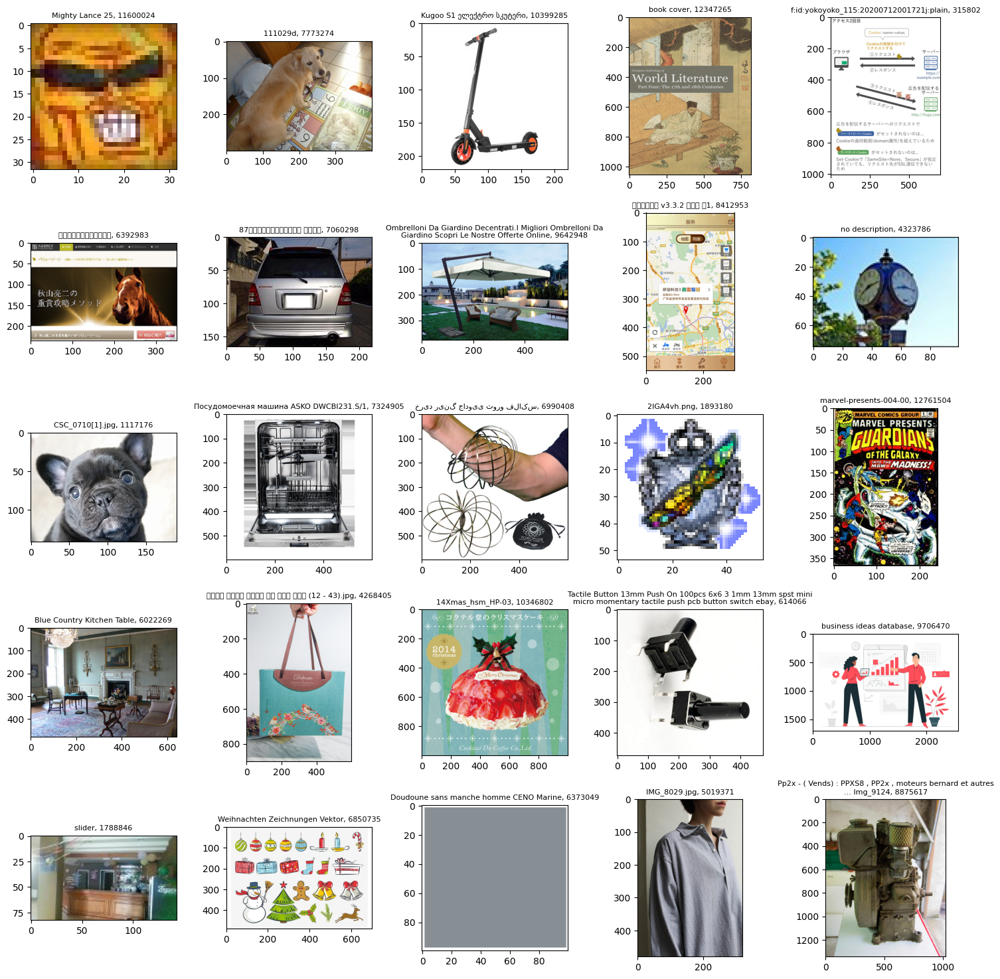

In [703]:
# images caught by datacomp face detection are not really faces
rekognition_uids = [row['uid'] for _, row in results_df.iterrows()]
base_diff = base_results_df.loc[~base_results_df['uid'].isin(rekognition_uids)]
print(len(base_diff))
display_sample(base_diff, bounding_box=False)

1463


/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 22799 (\N{CJK UNIFIED IDEOGRAPH-590F}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 30495 (\N{CJK UNIFIED IDEOGRAPH-771F}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12387 (\N{HIRAGANA LETTER SMALL TU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 30427 (\N{CJK UNIFIED IDEOGRAPH-76DB}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/hongrach/anaconda3/envs/datacomp/lib/python3.10/site-packages/IPython/core/pylabtools.py

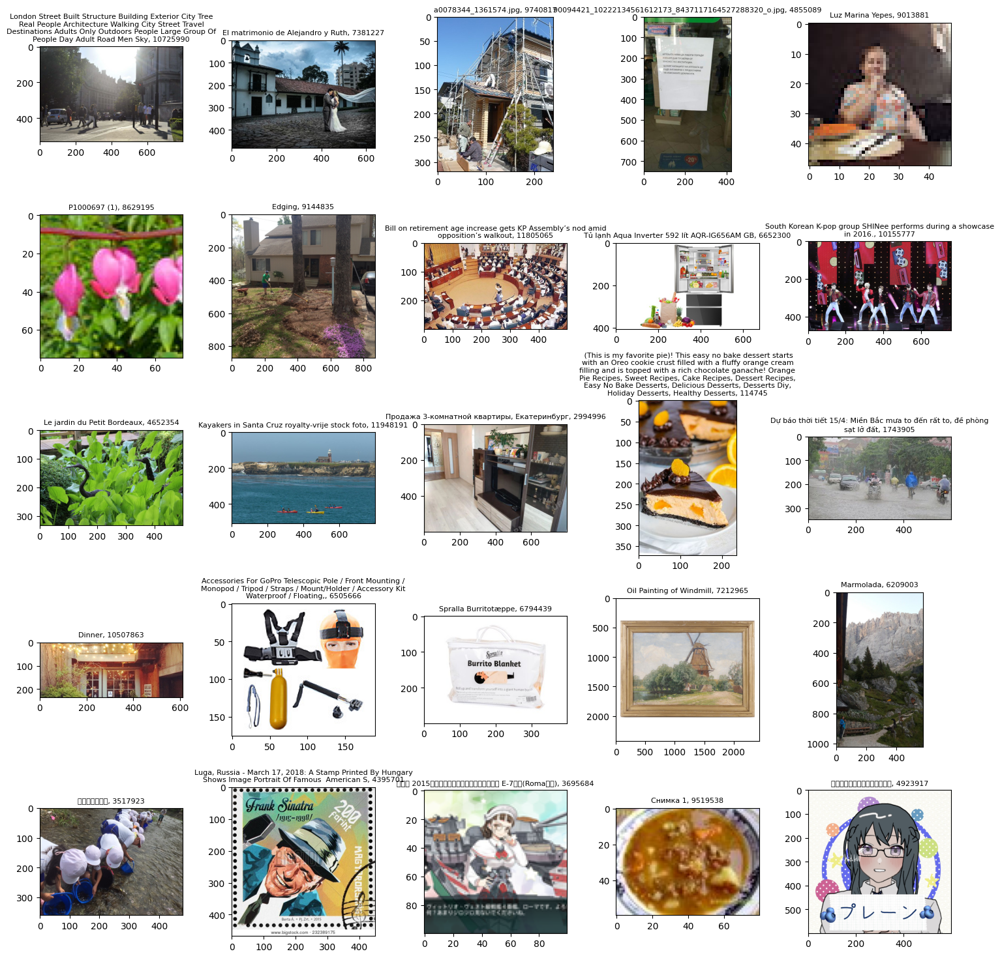

In [704]:
# images caught by rekognition and not datacomp are mostly faces
datacomp_uids = [row['uid'] for _, row in base_results_df.iterrows()]
rekognition_diff = results_df.loc[~results_df['uid'].isin(datacomp_uids)]
print(len(rekognition_diff))
display_sample(rekognition_diff, bounding_box=False)

# Make df of rekognition single faces to pass through clip

In [764]:
results_df['is_kept'] = results_df['clip_l14_similarity_score'].apply(lambda x: x > min_threshold)
results_df

/tmp/ipykernel_1557993/3667942575.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  results_df['is_kept'] = results_df['clip_l14_similarity_score'].apply(lambda x: x > min_threshold)


,uid,url,text,original_width,original_height,clip_b32_similarity_score,clip_l14_similarity_score,face_bboxes,sha256,is_kept
512,36cdbfdbb0242dea9f35d8e8ba244034,https://pixhost.icu/avaxhome/a6/27/007e27a6_me...,Le Courrier de l'Ouest Angers – 22 novembre 2020,217,300,0.283447,0.258301,"[[0.8724561929702759, 0.5759853720664978, 0.91...",a2cf4d99ceb01ced10c961aab951b7736e2b9f121c7e88...,True
741,ac54e51fb59c63f5a0f70c1f4861c073,https://worldofbuzz.com/wp-content/uploads/202...,"No More Verbal Warnings, Mco Phase 2 Will See ...",80,80,0.232178,0.239380,"[[0.0, 0.1678292453289032, 0.23773819208145142...",d9615e4fd8671794cfba0630737462364f5ac76b347251...,False
1467,8c3a175a53c7a2899a96ab163e9b0b38,https://www.intimateweddings.com/wp-content/up...,New Zealand mountain elopement,467,701,0.309814,0.291504,"[[0.5742679238319397, 0.485332190990448, 0.628...",912f9c7fee28bcbaf803256a3084bfc4c3c7f1eee85e36...,True
2903,679c52457e754058c79aa0ed53a1f9c2,https://bigjimny.com/media/kunena/avatars/resi...,Elikratos's Avatar,144,144,0.237427,0.134155,"[[0.5906437039375305, 0.09305974096059799, 0.6...",313da752d861e5e678ad2016184706021b09d3f0f7235b...,False
3466,7080884b0e5785035f25185394fa0488,https://s3.amazonaws.com/cms.ipressroom.com/36...,Researchers aim to understand COVID-19 in chil...,400,400,0.225952,0.139282,"[[0.12686803936958313, 0.1720641404390335, 0.1...",b7f8ab47edb90ea838295bfa9cefa0d45d64a34e758f70...,False
...,...,...,...,...,...,...,...,...,...,...
12796929,df62a980c1064ef037c436be8b8fa585,https://i.ytimg.com/vi/TirIvyvLjkY/0.jpg,Republicans CHEATING In Georgia,480,360,0.290283,0.263916,"[[0.20814579725265503, 0.36898717284202576, 0....",23aa87722b8d0f84840ce8ce280cb9d2200f082fa6bb8f...,True
12798008,4b178c30fc051300270d98116912c0fe,https://i.pinimg.com/216x146/f0/c3/87/f0c38715...,Culture,215,146,0.214600,0.181030,"[[0.39470165967941284, 0.0, 0.5665967464447021...",5754465eb66e5e255fc9e37e01a939baca810734b98551...,False
12798376,bf116df22a2827b3310e37396576cb70,http://lionsclubpoznanrotunda.org/wp-content/g...,Wigilia 2010,218,160,0.243652,0.141235,"[[0.5503153800964355, 0.014322477392852306, 0....",337814ff91db2e6b568570103fc4178c0554c428ff5ddb...,False
12798943,e2f047278fc517de7c7da42d3690d6fa,https://lb.jingoo.com/medium/66/14/2198895-273...,Photographe mariage - NICEWEATHER PHOTOGRAPHIE...,345,520,0.282715,0.258057,"[[0.2776043713092804, 0.14536504447460175, 0.5...",4440bedd6a4f5039cc70b0e844152445bcef452ec3bb92...,True


In [765]:
NUM_FACES = 1
output_df = results_df[['uid', 'is_kept']].copy()
bounding_box = {}
face_image_dir = '/data/datacomp/small/sample_images_1M'
img_path = {}
face_detail_dict = {}

for _, row in results_df.iterrows():
    uid = row['uid']
    face_details = results[uid]
    if len(face_details) == NUM_FACES:
        face_detail = face_details[0]
        bounding_box[uid] = face_detail['BoundingBox']
        face_detail_dict[uid] = face_detail
        
        url = row['url']
        ext = url.split('.')[-1]
        if len(ext) > 4 or len(ext) == 0:
            ext = 'jpg'

        path = os.path.join(face_image_dir, uid + '.' + ext)
        if not os.path.isfile(path):
            print(path)
        img_path[uid] = path

output_df['bounding_box'] = output_df['uid'].map(bounding_box)
output_df['face_detail'] = output_df['uid'].map(face_detail_dict)
output_df['img_path'] = output_df['uid'].map(img_path)
output_df = output_df.dropna()

/data/datacomp/small/sample_images_1M/2e80f7a6c6a99f2b784aa39b7d63ef38.jpg
/data/datacomp/small/sample_images_1M/25b8a8e3f3ab7ada206a88062f9bcfe2.jpg
/data/datacomp/small/sample_images_1M/96500587e42f845fbb2e791aa3a6f97f.jpg
/data/datacomp/small/sample_images_1M/57258a4021ab7ad15de4a7c2f2990ea4.jpg 


In [766]:
output_df

,uid,is_kept,bounding_box,face_detail,img_path
2903,679c52457e754058c79aa0ed53a1f9c2,False,"{'Width': 0.0604824498295784, 'Height': 0.0701...","{'BoundingBox': {'Width': 0.0604824498295784, ...",/data/datacomp/small/sample_images_1M/679c5245...
3466,7080884b0e5785035f25185394fa0488,False,"{'Width': 0.029890689998865128, 'Height': 0.04...",{'BoundingBox': {'Width': 0.029890689998865128...,/data/datacomp/small/sample_images_1M/7080884b...
3831,e5cd240f4d1ba979a05a1e8ae2f58b46,True,"{'Width': 0.0471738800406456, 'Height': 0.0532...","{'BoundingBox': {'Width': 0.0471738800406456, ...",/data/datacomp/small/sample_images_1M/e5cd240f...
4152,7c56a3785f76c247f12426fd1f1e09cb,False,"{'Width': 0.4143693149089813, 'Height': 0.5678...","{'BoundingBox': {'Width': 0.4143693149089813, ...",/data/datacomp/small/sample_images_1M/7c56a378...
5526,1c93325f3b1dc161ad4853ccfde59f6b,True,"{'Width': 0.0693819671869278, 'Height': 0.1218...","{'BoundingBox': {'Width': 0.0693819671869278, ...",/data/datacomp/small/sample_images_1M/1c93325f...
...,...,...,...,...,...
12793317,ebcdf840a58b526954acc6c393748577,False,"{'Width': 0.16220881044864655, 'Height': 0.294...","{'BoundingBox': {'Width': 0.16220881044864655,...",/data/datacomp/small/sample_images_1M/ebcdf840...
12795107,f086c387af61525b21afc298bb664972,True,"{'Width': 0.3772602379322052, 'Height': 0.5319...","{'BoundingBox': {'Width': 0.3772602379322052, ...",/data/datacomp/small/sample_images_1M/f086c387...
12798008,4b178c30fc051300270d98116912c0fe,False,"{'Width': 0.051299214363098145, 'Height': 0.13...",{'BoundingBox': {'Width': 0.051299214363098145...,/data/datacomp/small/sample_images_1M/4b178c30...
12798943,e2f047278fc517de7c7da42d3690d6fa,True,"{'Width': 0.2610539197921753, 'Height': 0.2311...","{'BoundingBox': {'Width': 0.2610539197921753, ...",/data/datacomp/small/sample_images_1M/e2f04727...


In [767]:
output_df.to_parquet('~/datafiltering/face_rekognition_images_single_df.parquet')

In [762]:
sample_face_df_path = '~/datafiltering/face_rekognition_images_single_df.parquet'
sample_face_df = pd.read_parquet(sample_face_df_path)
sample_face_df

,uid,bounding_box,face_detail,img_path
2903,679c52457e754058c79aa0ed53a1f9c2,"{'Height': 0.07013186812400818, 'Left': 0.5912...","{'AgeRange': {'High': 25, 'Low': 19}, 'Boundin...",/data/datacomp/small/sample_images_1M/679c5245...
3466,7080884b0e5785035f25185394fa0488,"{'Height': 0.042780742049217224, 'Left': 0.128...","{'AgeRange': {'High': 81, 'Low': 73}, 'Boundin...",/data/datacomp/small/sample_images_1M/7080884b...
3831,e5cd240f4d1ba979a05a1e8ae2f58b46,"{'Height': 0.053211428225040436, 'Left': 0.425...","{'AgeRange': {'High': 22, 'Low': 14}, 'Boundin...",/data/datacomp/small/sample_images_1M/e5cd240f...
4152,7c56a3785f76c247f12426fd1f1e09cb,"{'Height': 0.5678257346153259, 'Left': 0.31606...","{'AgeRange': {'High': 41, 'Low': 33}, 'Boundin...",/data/datacomp/small/sample_images_1M/7c56a378...
5526,1c93325f3b1dc161ad4853ccfde59f6b,"{'Height': 0.12182845920324326, 'Left': 0.6872...","{'AgeRange': {'High': 19, 'Low': 13}, 'Boundin...",/data/datacomp/small/sample_images_1M/1c93325f...
...,...,...,...,...
12793317,ebcdf840a58b526954acc6c393748577,"{'Height': 0.2947092354297638, 'Left': 0.31180...","{'AgeRange': {'High': 52, 'Low': 44}, 'Boundin...",/data/datacomp/small/sample_images_1M/ebcdf840...
12795107,f086c387af61525b21afc298bb664972,"{'Height': 0.5319896936416626, 'Left': 0.24223...","{'AgeRange': {'High': 19, 'Low': 13}, 'Boundin...",/data/datacomp/small/sample_images_1M/f086c387...
12798008,4b178c30fc051300270d98116912c0fe,"{'Height': 0.13903246819972992, 'Left': 0.2823...","{'AgeRange': {'High': 30, 'Low': 22}, 'Boundin...",/data/datacomp/small/sample_images_1M/4b178c30...
12798943,e2f047278fc517de7c7da42d3690d6fa,"{'Height': 0.2311783730983734, 'Left': 0.27956...","{'AgeRange': {'High': 29, 'Low': 21}, 'Boundin...",/data/datacomp/small/sample_images_1M/e2f04727...


# Linear regression: CLIP similarity score vs y_hat_prob

In [866]:
def onehot(i, n_groups):
    arr = [0] * n_groups
    arr[i] = 1
    return arr

In [862]:
from sklearn import datasets, linear_model
from sklearn.linear_model import LinearRegression
import statsmodels.api as sm
from scipy import stats

diabetes = datasets.load_diabetes()
X = diabetes.data
y = diabetes.target

X2 = sm.add_constant(X)
est = sm.OLS(y, X2)
est2 = est.fit()
print(est2.summary())

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.518
Model:                            OLS   Adj. R-squared:                  0.507
Method:                 Least Squares   F-statistic:                     46.27
Date:                Thu, 07 Mar 2024   Prob (F-statistic):           3.83e-62
Time:                        22:12:55   Log-Likelihood:                -2386.0
No. Observations:                 442   AIC:                             4794.
Df Residuals:                     431   BIC:                             4839.
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        152.1335      2.576     59.061      0.0

In [876]:
features = []
scores = []
for _, row in results_df.iterrows():
    uid = row['uid']
    face_details = results[uid]
    if len(face_details) == NUM_FACES:
        scores.append(row['clip_l14_similarity_score'])
        
        face_detail = face_details[0]
        gender = face_detail['Gender']['Value']
        confidence = face_detail['Gender']['Confidence']
        if gender == 'Male':
            x = [confidence]
        else:
            x = [100 - confidence]
        
        age = int(np.average([face_detail['AgeRange']['Low'], face_detail['AgeRange']['High']]))
        # omitted: F, W
        assert (age < 100)
        x_age = np.asarray(onehot(int(age / 10), 10))[:9]
        x += list(x_age)
        features.append(list(x))
#         print(gender, age, x)
#         if len(features) >= 3:
#             raise Exception
scores = np.asarray(scores)
features = np.asarray(features)
scores.shape, features.shape

x_df = pd.DataFrame(data=features, columns=["male_prob"] + [str(a) for a in range(0, 90, 10)])
x_df

,male_prob,0,10,20,30,40,50,60,70,80
0,76.767273,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
1,99.279488,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2,77.116516,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,99.258163,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
4,94.809372,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...
11032,93.504158,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
11033,99.647392,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11034,12.129890,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
11035,1.036964,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0


In [877]:
scores.shape

(11037,)

In [878]:
features_2 = sm.add_constant(x_df)
est = sm.OLS(scores, features_2)
est2 = est.fit()
print(est2.summary())

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                  0.000
Method:                 Least Squares   F-statistic:                     1.534
Date:                Thu, 07 Mar 2024   Prob (F-statistic):              0.120
Time:                        22:29:32   Log-Likelihood:                 14720.
No. Observations:               11037   AIC:                        -2.942e+04
Df Residuals:                   11026   BIC:                        -2.934e+04
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.2440      0.029      8.546      0.0